# Position Reconstruction for XeBRA - MC Prestudies

**Status:** July 2019

Position reconstruction for XeBRA following the position reconstruction algorithm of Mercury (employed in the LUX experiment, originally developed for the ZEPLIN-III dark matter experiment) with light response functions (see https://arxiv.org/abs/1710.02752v2 and https://arxiv.org/abs/1112.1481 ).

In [1]:
## Check Python version:
!python -V
## Check ROOT version:
!which root

Python 3.7.3


In [606]:
## Imports:

import sys

import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import AutoMinorLocator
from matplotlib import gridspec            # to arrange the plots nicely
from matplotlib.image import NonUniformImage
from matplotlib.patches import Rectangle
%matplotlib inline

import uproot                              # uproot for easy import of ROOT tree contents
import collections                         # used for named tuples
import pandas as pd
import math
import ast
from scipy import optimize
from scipy.optimize import curve_fit
from scipy.optimize import minimize
from scipy import stats
from numpy import exp
from pylab import meshgrid,cm,imshow,contour,clabel,colorbar,axis,title,show

In [3]:
## Function definitions:

def f_polar_R(cartesian_x, cartesian_y):
    return np.sqrt(cartesian_x * cartesian_x + cartesian_y * cartesian_y)

def f_polar_Phi(cartesian_x, cartesian_y):
    return np.arctan2(cartesian_y, cartesian_x)

def f_distance(x_a, y_a, x_b, y_b):
    return np.sqrt((x_b - x_a)**2 + (y_b - y_a)**2)


def flatten_tuples(tup):
    return np.array([element for tupl in tup for element in tupl])

def sum_tuple_subentries(tup):
    return [np.sum(tupl) for tupl in tup]

def nth_tuple_subentries(tup, n):
    return [tupl[n] for tupl in tup]


def from_np_array(array_string):
    array_string = ','.join(array_string.replace('[ ', '[').split())
    return np.array(ast.literal_eval(array_string))

### Properties PMTs

<img src="../../Technical_Drawings_and_Data_Sheets/PMTs/pmts_verbessert.png" alt="pmts_verbessert.png" style="width: 700px;"/>

In [4]:
PMT_ID = np.array([1,2,3,4,5,6,7])

PMT_position_x = np.array([-14.,-28,-14.,14.,28.,14.,0.])      # x-position PMTs in mm in cartesian coordinates
PMT_position_y = np.array([-28.,0.,28.,28.,0.,-28.,0.])        # y-position PMTs in mm in cartesian coordinates
PMT_position_R = f_polar_R(PMT_position_x, PMT_position_y)     # radial position PMTs in mm in polar coordinates
PMT_position_Phi = f_polar_Phi(PMT_position_x, PMT_position_y) # angular position PMTs in rad in polar coordinates

PMT_positions = pd.DataFrame(index=PMT_ID, data={'PMT_ID': PMT_ID, 'PMT_position_x': PMT_position_x, 'PMT_position_y': PMT_position_y, 'PMT_position_R': PMT_position_R, 'PMT_position_Phi': PMT_position_Phi})
PMT_positions

,PMT_ID,PMT_position_x,PMT_position_y,PMT_position_R,PMT_position_Phi
1,1,-14.0,-28.0,31.304952,-2.034444
2,2,-28.0,0.0,28.000000,3.141593
3,3,-14.0,28.0,31.304952,2.034444
4,4,14.0,28.0,31.304952,1.107149
5,5,28.0,0.0,28.000000,0.000000
6,6,14.0,-28.0,31.304952,-1.107149
7,7,0.0,0.0,0.000000,0.000000


In [5]:
R8520_body_width = 25.7
R8520_body_cornerradius = 2.
R8520_photocathode_width = 20.5
R8520_photocathode_cornerradius = 1.

In [6]:
## Photoelectrode coverage top PMTs / total top array
## preliminary rough estimate !!! -> redo
PECoverage_Top = np.array([56628, 69714, 56751, 57049, 70225, 56738, 85238]) / 452343

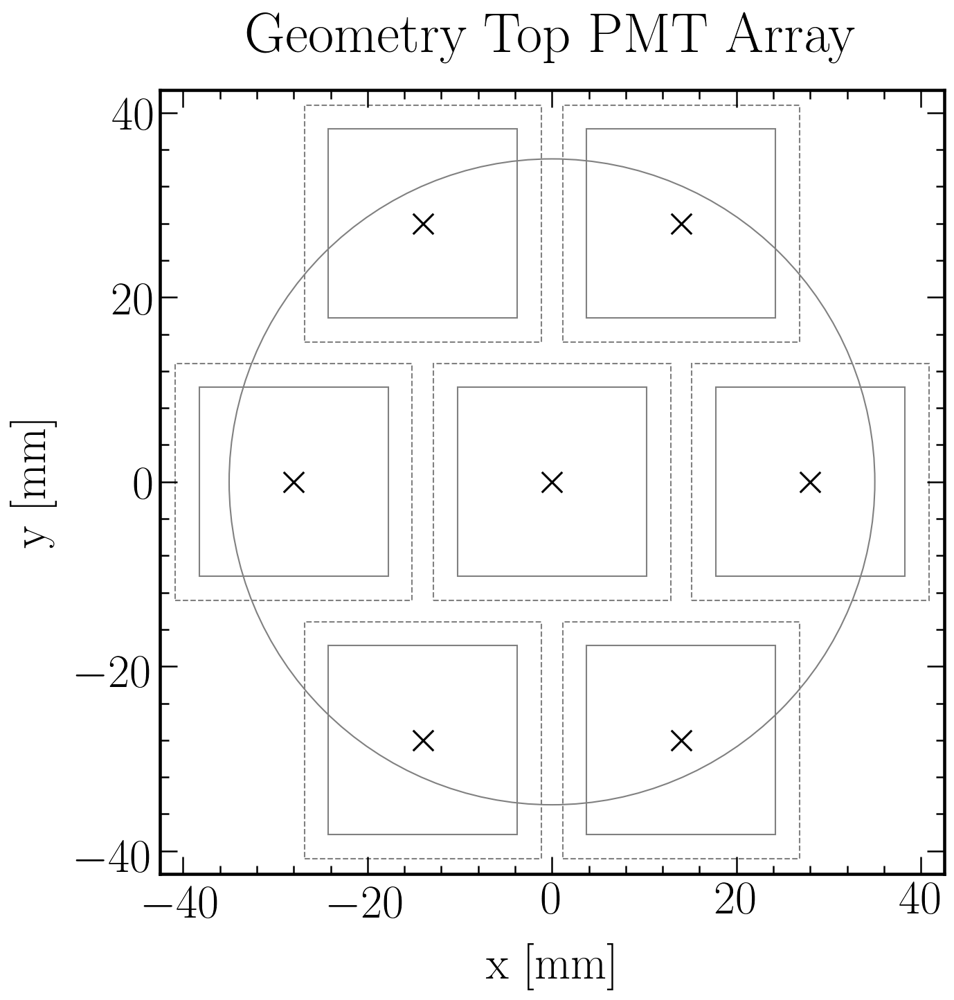

In [7]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('Geometry Top PMT Array', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-42.5,42.5)
plt.ylim(-42.5,42.5)

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

fig.savefig("Geometry_Top_PMT_Array.png", bbox_inches = "tight")
plt.show()

## MC Driven Studies

### Imports and data porcessing

In [8]:
## Available ROOT files in specified folder:
#! ls ../../Xebra_G4/*.root
#! ls ../../Simulation_Data/LCE/*.root
#! ls ../../Simulation_Data/Modification_Spacer_3/*.root
#! ls /media/ab602/TOSHIBA\ EXT/Simulation_Data/Modification_Spacer_3
#! ls /media/ab602/TOSHIBA\ EXT/Simulation_Data/Influence_Optical_Parameters
#! ls /media/alex/TOSHIBA\ EXT/Simulation_Data/Modification_Spacer_3
#! ls /media/alex/TOSHIBA\ EXT/Simulation_Data/Influence_Optical_Parameters
! ls /media/ab602/TOSHIBA\ EXT/Simulation_Data/LCE

optPhot_S1_1.0e+06_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509.root
optPhot_S1_1.0e+07_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509.root
optPhot_S1_1.0e+07_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse.root
optPhot_S2_1.0e+06_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509.root
optPhot_S2_1.0e+07_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509.root
optPhot_S2_1.0e+07_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse.root


In [9]:
## Selection of file to be analyzed:
filename = '/media/ab602/TOSHIBA EXT/Simulation_Data/LCE/optPhot_S2_1.0e+07_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse.root'

# filename prefix for automatically naming outputs

if filename[6:14] == 'Xebra_G4':
    filenameprefix = filename[:-5][15:]
    
elif filename[6:25] == 'Simulation_Data/Mod':
    filenameprefix = filename[:-5][44:]
    
elif filename[6:25] == 'Simulation_Data/LCE':
    filenameprefix = filename[:-5][26:]
    
elif filename[:45] == '/media/ab602/TOSHIBA EXT/Simulation_Data/LCE/':
    filenameprefix = filename[:-5][45:]
    
elif filename[:63] == '/media/ab602/TOSHIBA EXT/Simulation_Data/Modification_Spacer_3/':
    filenameprefix = filename[:-5][63:]
    
elif filename[:70] == '/media/ab602/TOSHIBA EXT/Simulation_Data/Influence_Optical_Parameters/':
    filenameprefix = filename[:-5][70:]
    
elif filename[:44] == '/media/alex/TOSHIBA EXT/Simulation_Data/LCE/':
    filenameprefix = filename[:-5][44:]
    
elif filename[:62] == '/media/alex/TOSHIBA EXT/Simulation_Data/Modification_Spacer_3/':
    filenameprefix = filename[:-5][62:]
    
elif filename[:69] == '/media/alex/TOSHIBA EXT/Simulation_Data/Influence_Optical_Parameters/':
    filenameprefix = filename[:-5][69:]

else:
    filenameprefix = 'filenameprefix'
    
print(filenameprefix)

optPhot_S2_1.0e+07_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse


In [10]:
## Import as pandas dataframes

import pandas as pd

branches= ['xp_pri','yp_pri','zp_pri','nbpmthits','ntpmthits','pmthits'] # Be careful that the branches are also initilized in _chunk_collect

import concurrent.futures
executor = concurrent.futures.ThreadPoolExecutor(8)

_chunk_collect = pd.DataFrame({'xp_pri' : [],'yp_pri' : [],'zp_pri' : [],'nbpmthits' : [],'ntpmthits' : [],'pmthits' : []}) # Initialize empty data frame

for _chunk in uproot.iterate(filename, "events/events",branches, entrysteps=100000, 
                                       outputtype=pd.DataFrame, executor=executor):
    _chunk.columns=branches
    _chunk_collect = _chunk_collect.append(_chunk)

/home/ab602/anaconda3/lib/python3.7/site-packages/uproot/tree.py:116: FutureWarning: Int64Index.data is deprecated and will be removed in a future version
  index = awkward.numpy.frombuffer(arrays.index.data, dtype=arrays.index.dtype)


In [11]:
## Separate hits for individual PMTs
## Takes a while to calculate...
for i in range(0,8):
    _chunk_collect['pmthits_'+str(i)] = pd.Series(nth_tuple_subentries(np.asarray(_chunk_collect['pmthits']), i), index=_chunk_collect.index)
    print(i, end=' ')

0 1 2 3 4 5 6 7 

In [12]:
## Total PMT hits
_chunk_collect['napmthits'] = pd.Series(_chunk_collect.nbpmthits+_chunk_collect.ntpmthits, index=_chunk_collect.index)

In [13]:
_chunk_collect.head(6)

,xp_pri,yp_pri,zp_pri,nbpmthits,ntpmthits,pmthits,pmthits_0,pmthits_1,pmthits_2,pmthits_3,pmthits_4,pmthits_5,pmthits_6,pmthits_7,napmthits
0,28.731062,-13.888252,2.923095,1.0,0.0,"[1, 0, 0, 0, 0, 0, 0, 0]",1,0,0,0,0,0,0,0,1.0
1,3.575153,17.849449,3.576625,0.0,1.0,"[0, 0, 0, 1, 0, 0, 0, 0]",0,0,0,1,0,0,0,0,1.0
2,14.216546,-4.272856,2.988359,1.0,0.0,"[1, 0, 0, 0, 0, 0, 0, 0]",1,0,0,0,0,0,0,0,1.0
3,-22.187336,-6.608525,4.336542,1.0,0.0,"[1, 0, 0, 0, 0, 0, 0, 0]",1,0,0,0,0,0,0,0,1.0
4,24.289482,-17.567038,2.743480,1.0,0.0,"[1, 0, 0, 0, 0, 0, 0, 0]",1,0,0,0,0,0,0,0,1.0
5,-31.510481,0.550315,3.513464,0.0,1.0,"[0, 0, 1, 0, 0, 0, 0, 0]",0,0,1,0,0,0,0,0,1.0


In [14]:
nphotons = len(_chunk_collect.xp_pri)
nbpmthits_sum = int(_chunk_collect.nbpmthits.sum())
ntpmthits_sum = int(_chunk_collect.ntpmthits.sum())
napmthits_sum = int(_chunk_collect.napmthits.sum())

print('Total Photons:   '+str(nphotons))
print('Bottom PMT Hits:  '+str(nbpmthits_sum))
print('Top PMT Hits:     '+str(ntpmthits_sum))
print('Total PMT Hits:   '+str(napmthits_sum))
print('Total LCE:        '+str(round(100*napmthits_sum/nphotons,2))+' %')

Total Photons:   2689738
Bottom PMT Hits:  1389737
Top PMT Hits:     1300001
Total PMT Hits:   2689738
Total LCE:        100.0 %


In [15]:
'''
if nphotons > 5000000:
    numberbins = 70
else:
    numberbins = 35
'''

numberbins = 70
print(numberbins)

70


### LCE and Hits Fraction Maps

#### LCE Maps

range: (2.5, 5.0) 

LCE_All    = 100.0 %
LCE_Top    = 48.34 %
LCE_Bottom = 51.66 %



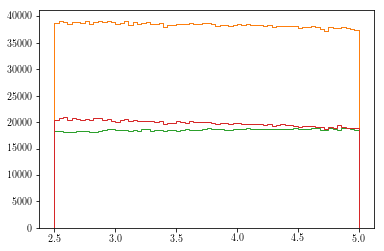

In [16]:
numberbins_z = numberbins
rng = (round(np.min(_chunk_collect.zp_pri),2), round(np.max(_chunk_collect.zp_pri),2))
print('range: '+str(rng)+' \n')

n_z_total, bins_z_total, patches_z_total = plt.hist(_chunk_collect.zp_pri, numberbins_z, weights = None, range = rng, histtype = 'step');
n_z_hits_a, bins_z_hits_a, patches_z_hits_a = plt.hist(_chunk_collect.zp_pri, numberbins_z, weights = _chunk_collect.napmthits, range = rng, histtype = 'step');
n_z_hits_t, bins_z_hits_t, patches_z_hits_t = plt.hist(_chunk_collect.zp_pri, numberbins_z, weights = _chunk_collect.ntpmthits, range = rng, histtype = 'step');
n_z_hits_b, bins_z_hits_b, patches_z_hits_b = plt.hist(_chunk_collect.zp_pri, numberbins_z, weights = _chunk_collect.nbpmthits, range = rng, histtype = 'step');

binscenter_z_total = (bins_z_total[:-1]+bins_z_total[1:])/2
binscenter_z_hits_a = (bins_z_hits_a[:-1]+bins_z_hits_a[1:])/2
binscenter_z_hits_t = (bins_z_hits_t[:-1]+bins_z_hits_t[1:])/2
binscenter_z_hits_b = (bins_z_hits_b[:-1]+bins_z_hits_b[1:])/2

n_z_LCE_a = n_z_hits_a / n_z_total
n_z_LCE_t = n_z_hits_t / n_z_total
n_z_LCE_b = n_z_hits_b / n_z_total

# Average values:
print('LCE_All    = '+str(round(100*n_z_LCE_a.mean(),2))+' %')
print('LCE_Top    = '+str(round(100*n_z_LCE_t.mean(),2))+' %')
print('LCE_Bottom = '+str(round(100*n_z_LCE_b.mean(),2))+' %\n')

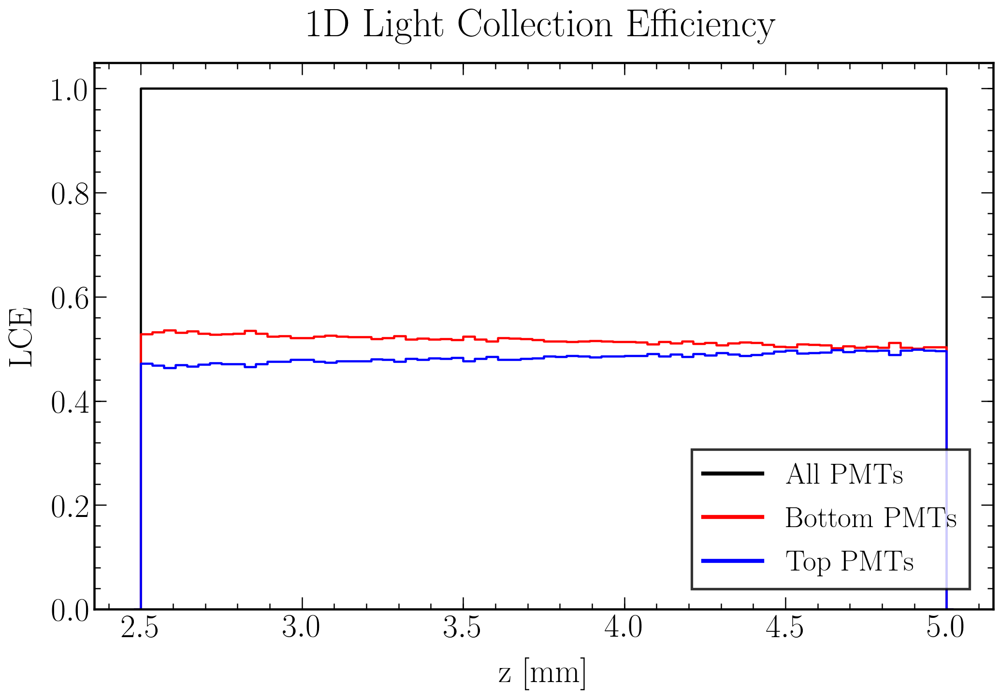

In [17]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

# Data plot

bns = np.concatenate((np.array([2*binscenter_z_hits_a[0]-binscenter_z_hits_a[1]]), binscenter_z_hits_a, np.array([2*binscenter_z_hits_a[-1]-binscenter_z_hits_a[-2]])))
ns = np.concatenate((np.array([0]), n_z_LCE_a, np.array([0])))
plt.step(bns, ns, where='mid', linewidth = 2.2, label = 'All PMTs', color = 'k')
ns = np.concatenate((np.array([0]), n_z_LCE_b, np.array([0])))
plt.step(bns, ns, where='mid', linewidth = 2.2, label = 'Bottom PMTs', color = 'r')
ns = np.concatenate((np.array([0]), n_z_LCE_t, np.array([0])))
plt.step(bns, ns, where='mid', linewidth = 2.2, label = 'Top PMTs', color = 'b')

#numberbins = 70
#n, bins, patches = plt.hist(zp_pri, numberbins, weights = [1/(len(zp_pri)/numberbins)]*len(zp_pri), histtype = 'step', linewidth = 2.2, color = 'k')
'''
n, bins, patches = plt.hist(_chunk_collect.zp_pri, numberbins, weights = _chunk_collect.napmthits/nphotons*numberbins, histtype = 'step', linewidth = 2.2, label = 'All PMTs', color = 'k')
n, bins, patches = plt.hist(_chunk_collect.zp_pri, numberbins, weights = _chunk_collect.nbpmthits/nphotons*numberbins, histtype = 'step', linewidth = 2.2, label = 'Bottom PMT', color = 'r')
n, bins, patches = plt.hist(_chunk_collect.zp_pri, numberbins, weights = _chunk_collect.ntpmthits/nphotons*numberbins, histtype = 'step', linewidth = 2.2, label = 'Top PMTs', color = 'b')
'''

plt.ylim(bottom = 0)

plt.xlabel('z [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('LCE', fontsize = label_size, labelpad = label_pad)
plt.title('1D Light Collection Efficiency', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=4, bbox_to_anchor=(0.99,0.01), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
#leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_LCE_z_comparison.png")
plt.show()

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in true_divide
  if sys.path[0] == '':


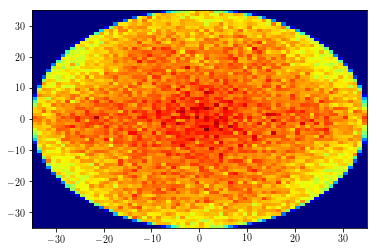

In [18]:
hist_xy_total, xedges_xy_total, yedges_xy_total, kwargs_xy_total = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = None, range = [[-35, 35], [-35, 35]], cmap = 'jet')
xedgescenter_xy_total = (xedges_xy_total[:-1]+xedges_xy_total[1:])/2
yedgescenter_xy_total = (yedges_xy_total[:-1]+yedges_xy_total[1:])/2
histT_xy_total = hist_xy_total.T  # Let each row list bins with common y range.

hist_xy_hits_t, xedges_xy_hits_t, yedges_xy_hits_t, kwargs_xy_hits_t = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = _chunk_collect.ntpmthits, range = [[-35, 35], [-35, 35]], cmap = 'jet')
xedgescenter_xy_hits_t = (xedges_xy_hits_t[:-1]+xedges_xy_hits_t[1:])/2
yedgescenter_xy_hits_t = (yedges_xy_hits_t[:-1]+yedges_xy_hits_t[1:])/2
histT_xy_hits_t = hist_xy_hits_t.T  # Let each row list bins with common y range.

hist_xy_LCE = hist_xy_hits_t / hist_xy_total
histT_xy_LCE = histT_xy_hits_t / histT_xy_total

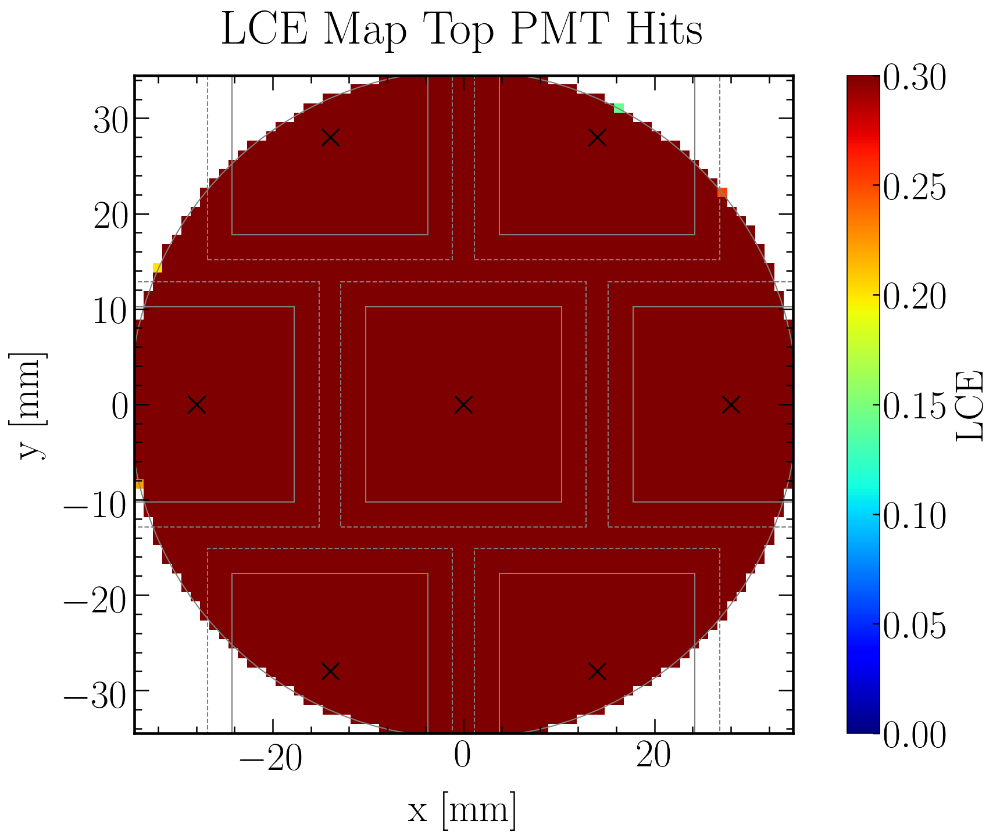

In [19]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = _chunk_collect.ntpmthits/nphotons*numberbins*numberbins*math.pi/4, range = [[-35, 35], [-35, 35]], cmap = 'jet')#, normed = True, norm=LogNorm()
plt.imshow(histT_xy_LCE, interpolation='nearest', origin='low', extent=[xedgescenter_xy_hits_t[0], xedgescenter_xy_hits_t[-1], yedgescenter_xy_hits_t[0], yedgescenter_xy_hits_t[-1]], cmap = 'jet')

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('LCE Map Top PMT Hits', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='LCE', fontsize=label_size)
plt.clim(0.0, 0.3)

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)
    
fig.savefig(filenameprefix+"_LCE_x_y_Top.png")
plt.show()

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:51: RuntimeWarning: invalid value encountered in true_divide
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:52: RuntimeWarning: invalid value encountered in true_divide


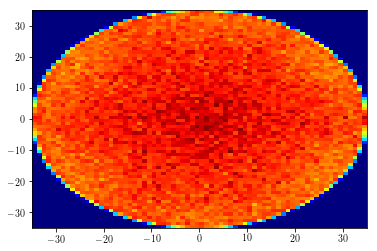

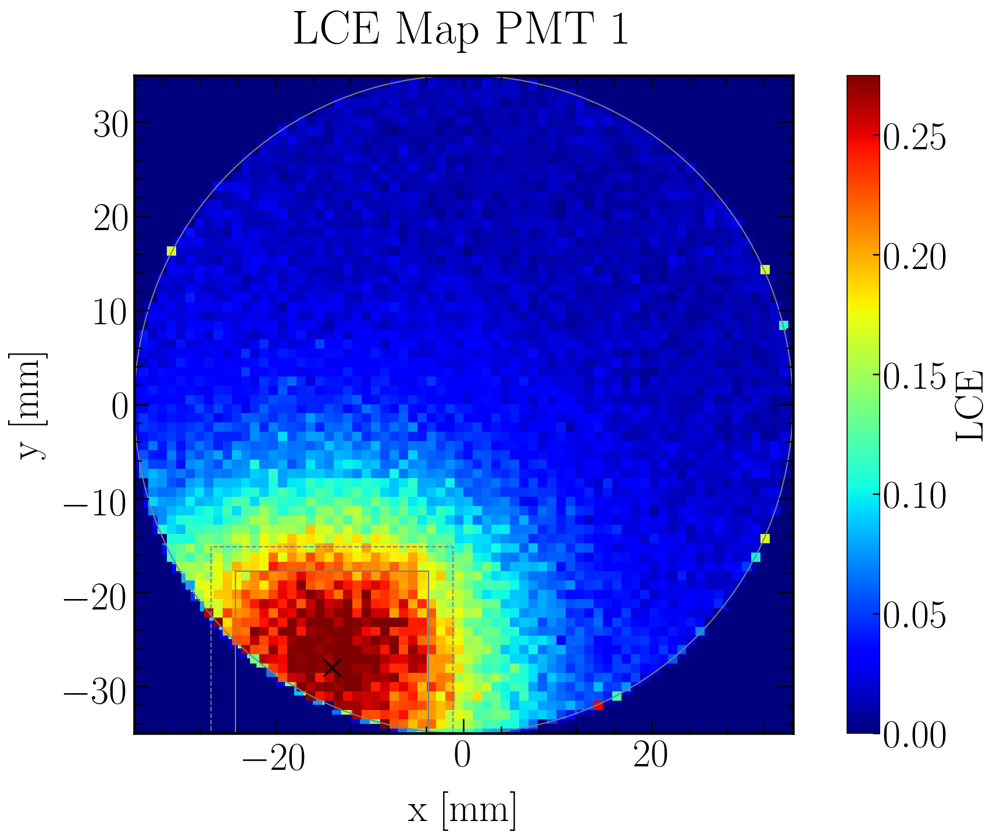

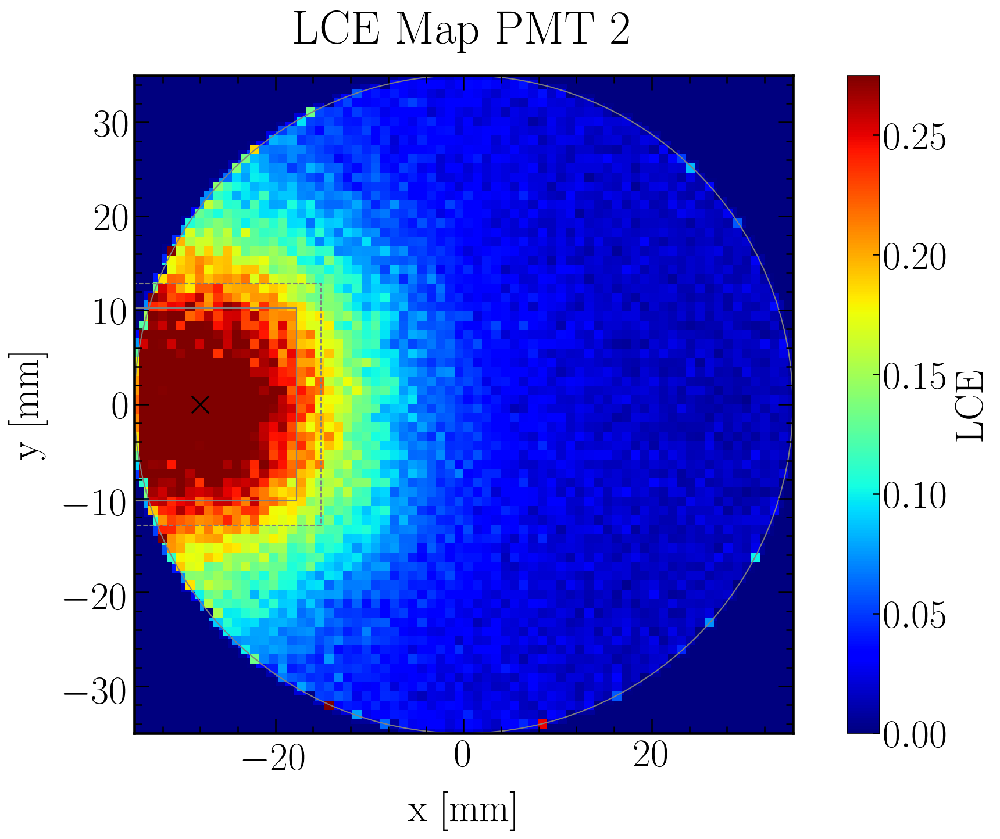

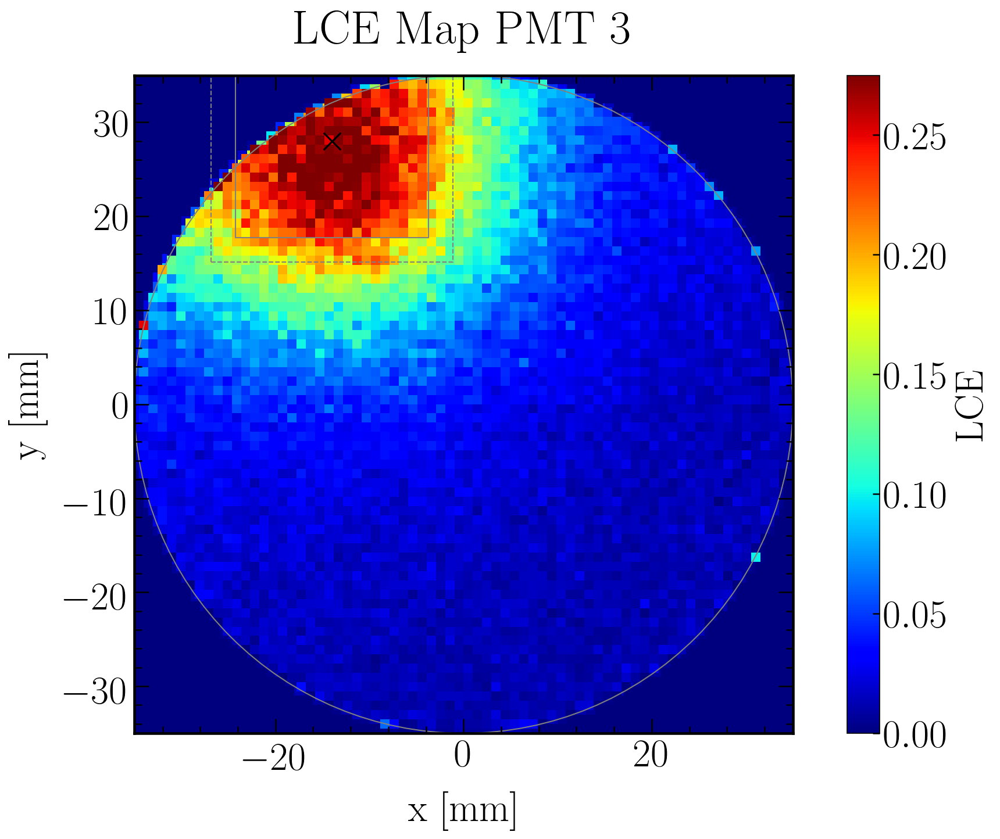

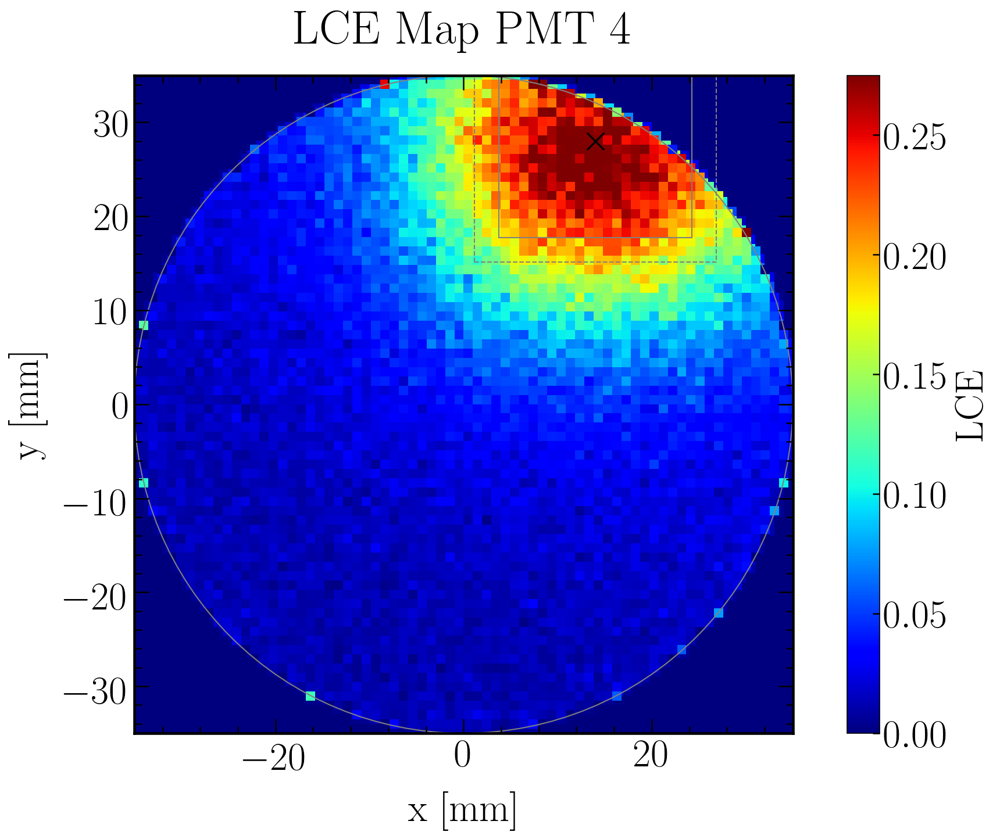

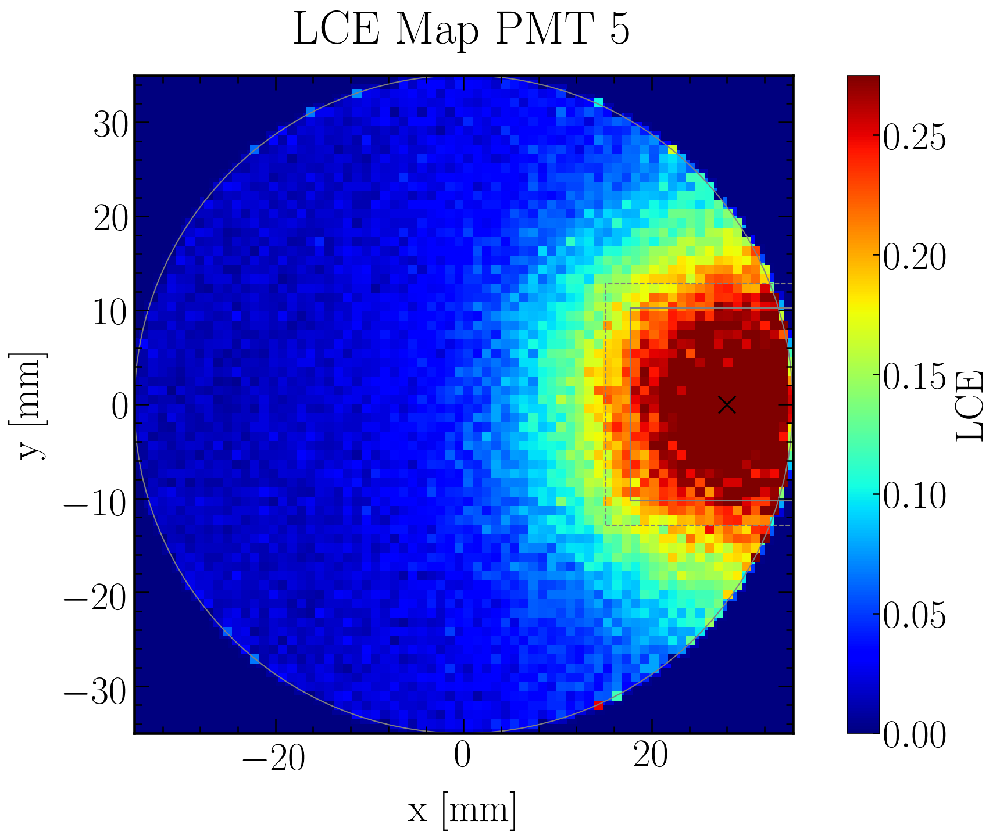

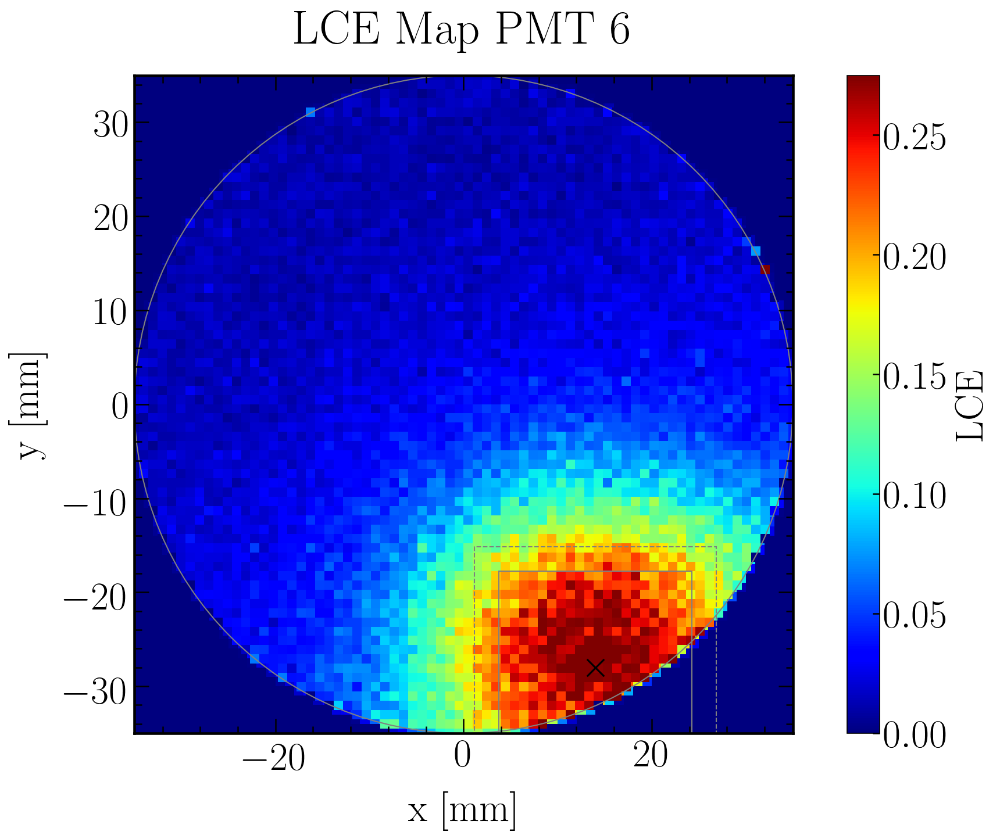

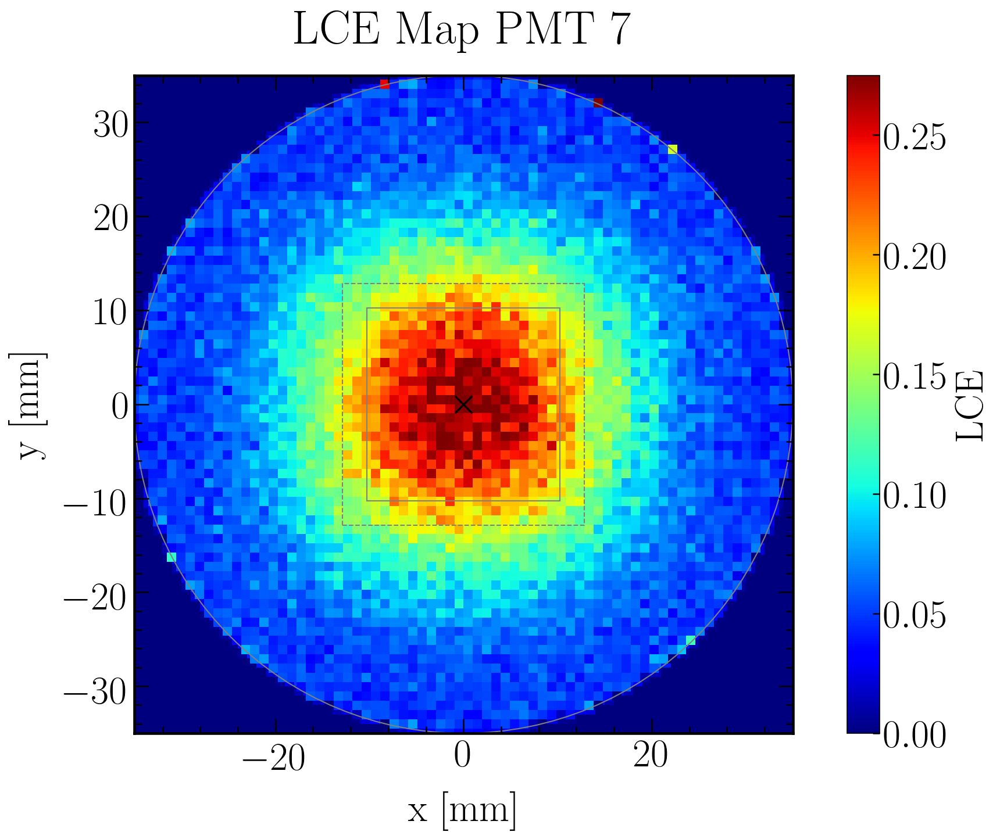

In [20]:
hits_list = [_chunk_collect.pmthits_1, _chunk_collect.pmthits_2, _chunk_collect.pmthits_3, _chunk_collect.pmthits_4, _chunk_collect.pmthits_5, _chunk_collect.pmthits_6, _chunk_collect.pmthits_7]
LCE_x_y_hist2d_perPMT = pd.DataFrame({'hist' : [], 'histT' : [], 'xedges' : [], 'xedges_center' : [], 'yedges' : [], 'yedges_center' : []})
columns = ['hist', 'histT', 'xedges', 'xedges_center', 'yedges', 'yedges_center']

hist_xy_total, xedges_xy_total, yedges_xy_total, kwargs_xy_total = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = None, range = [[-35, 35], [-35, 35]], cmap = 'jet')
histT_xy_total = hist_xy_total.T  # Let each row list bins with common y range.

for i in range(1,8):

    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    hist_xy_hits_i, xedges, yedges, kwargs = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = hits_list[i-1], range = [[-35, 35], [-35, 35]], cmap = 'jet')
    xedges_center = (xedges[:-1]+xedges[1:])/2
    yedges_center = (yedges[:-1]+yedges[1:])/2
    histT_xy_hits_i = hist_xy_hits_i.T  # Let each row list bins with common y range.

    hist = hist_xy_hits_i / hist_xy_total
    histT = histT_xy_hits_i / histT_xy_total
    
    plt.imshow(histT, interpolation='nearest', origin='low', extent=[xedges_center[0], xedges_center[-1], yedges_center[0], yedges_center[-1]], cmap = 'jet')
   
    '''    
    hist, xedges, yedges, kwargs = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = (hits_list[i-1])/nphotons*numberbins*numberbins*math.pi/4, range = [[-35, 35], [-35, 35]], cmap = 'jet')#, normed = True, norm=LogNorm()

    xedges_center = (xedges[:-1]+xedges[1:])/2
    yedges_center = (yedges[:-1]+yedges[1:])/2
    histT = hist.T  # Let each row list bins with common y range.
    '''
    
    values = [hist, histT, xedges, xedges_center, yedges, yedges_center]
    LCE_x_y_hist2d_perPMT = LCE_x_y_hist2d_perPMT.append(pd.DataFrame([np.array(values)], columns=columns)) #, ignore_index=True
    
    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('LCE Map PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='LCE', fontsize=label_size)
    plt.clim(0.0, 0.275)
    
    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)
    plt.show()
    fig.savefig(filenameprefix+"_LCE_x_y_PMT"+str(i)+".png")
    
LCE_x_y_hist2d_perPMT = LCE_x_y_hist2d_perPMT.set_index(PMT_ID);
LCE_x_y_hist2d_perPMT_hist_sum = LCE_x_y_hist2d_perPMT['hist'].sum()
LCE_x_y_hist2d_perPMT_histT_sum = LCE_x_y_hist2d_perPMT['histT'].sum()

In [21]:
'''#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
i = 1
plt.imshow(LCE_x_y_hist2d_perPMT['histT'].loc[i], interpolation='nearest', origin='low', extent=[LCE_x_y_hist2d_perPMT['xedges'].loc[i][0], LCE_x_y_hist2d_perPMT['xedges'].loc[i][-1], LCE_x_y_hist2d_perPMT['yedges'].loc[i][0], LCE_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('LCE Map PMT '+str(i), fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='LCE', fontsize=label_size)
plt.clim(0.0, 0.275)

plt.show()''';

In [22]:
'''#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
i = 1
plt.imshow(LCE_x_y_hist2d_perPMT_histT_sum, interpolation='nearest', origin='low', extent=[LCE_x_y_hist2d_perPMT['xedges'].loc[i][0], LCE_x_y_hist2d_perPMT['xedges'].loc[i][-1], LCE_x_y_hist2d_perPMT['yedges'].loc[i][0], LCE_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('LCE Map Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='LCE', fontsize=label_size)
#plt.clim(0.0, 0.275)

plt.show()''';

In [23]:
LCE_x_y_hist2d_perPMT.to_pickle(filenameprefix+"_LCE_x_y_hist2d_perPMT.pkl")
LCE_x_y_hist2d_perPMT

,hist,histT,xedges,xedges_center,yedges,yedges_center
1,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
2,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
3,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
4,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
5,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
6,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."
7,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-35.0, -34.0, -33.0, -32.0, -31.0, -30.0, -29...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28..."


#### Hits Fraction Maps

/home/ab602/anaconda3/lib/python3.7/site-packages/pandas/core/ops.py:1037: RuntimeWarning: invalid value encountered in true_divide
  lambda x: op(x, rvalues))


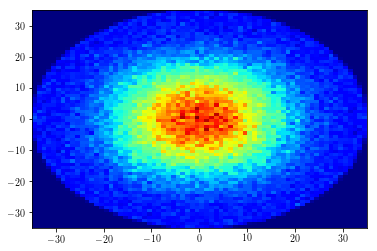

In [24]:
pmthits_list = ["pmthits_1", "pmthits_2", "pmthits_3", "pmthits_4", "pmthits_5", "pmthits_6", "pmthits_7"]
hits_list = [_chunk_collect.pmthits_1, _chunk_collect.pmthits_2, _chunk_collect.pmthits_3, _chunk_collect.pmthits_4, _chunk_collect.pmthits_5, _chunk_collect.pmthits_6, _chunk_collect.pmthits_7]
HF_x_y_hist2d_perPMT = pd.DataFrame({'PMT_ID' : [], 'hist' : [], 'histT' : [], 'xedges' : [], 'xedges_center' : [], 'yedges' : [], 'yedges_center' : []})
columns = ['PMT_ID', 'hist', 'histT', 'xedges', 'xedges_center', 'yedges', 'yedges_center']

for i in range(1,8):
    hist, xedges, yedges, kwargs = plt.hist2d(_chunk_collect.xp_pri, _chunk_collect.yp_pri, bins=numberbins, weights = _chunk_collect[pmthits_list[i-1]], range = [[-35, 35], [-35, 35]], cmap = 'jet')#, normed = True, norm=LogNorm()

    xedges_center = (xedges[:-1]+xedges[1:])/2
    yedges_center = (yedges[:-1]+yedges[1:])/2
    histT = hist.T  # Let each row list bins with common y range.
    
    values = [np.array([i]), hist, histT, xedges, xedges_center, yedges, yedges_center]
    HF_x_y_hist2d_perPMT = HF_x_y_hist2d_perPMT.append(pd.DataFrame([np.array(values)], columns=columns)) #, ignore_index=True

# set indices
HF_x_y_hist2d_perPMT = HF_x_y_hist2d_perPMT.set_index(PMT_ID);
for i in range(1,8):
    HF_x_y_hist2d_perPMT['PMT_ID'][i] = int(HF_x_y_hist2d_perPMT['PMT_ID'][i])

# calculate correct hit fractions as hits per PMT / hits total top for each bin
HF_x_y_hist2d_perPMT['hist'] = HF_x_y_hist2d_perPMT['hist']/HF_x_y_hist2d_perPMT['hist'].sum()
HF_x_y_hist2d_perPMT['histT'] = HF_x_y_hist2d_perPMT['histT']/HF_x_y_hist2d_perPMT['histT'].sum()

'''for i in range(0,8):
    try:
        HF_x_y_hist2d_perPMT['hist'][i] = np.where(np.isnan(HF_x_y_hist2d_perPMT['hist'][i]), None, HF_x_y_hist2d_perPMT['hist'][i])
    except:
        pass
    try:
        HF_x_y_hist2d_perPMT['histT'][i] = np.where(np.isnan(HF_x_y_hist2d_perPMT['histT'][i]), None, HF_x_y_hist2d_perPMT['histT'][i])
    except:
        pass

# save as csv
pd.set_option('display.max_colwidth', -1)
HF_x_y_hist2d_perPMT.to_csv(filenameprefix+'_HF_x_y_hist2d_perPMT.csv', index=False)'''

# save as pkl
HF_x_y_hist2d_perPMT.to_pickle(filenameprefix+"_HF_x_y_hist2d_perPMT.pkl")

In [25]:
## Read file for HF_x_y_hist2d_perPMT dataframe
## Not working yet
'''pd.read_csv('optPhot_S2_1e6_HF_x_y_hist2d_perPMT.csv', index_col = 'PMT_ID', converters={'xedges': from_np_array, 'xedges_center': from_np_array, 'yedges': from_np_array, 'yedges_center': from_np_array})''';
## Working
# HF_x_y_hist2d_perPMT = pd.read_pickle("output/"+filenameprefix+"_HF_x_y_hist2d_perPMT.pkl")

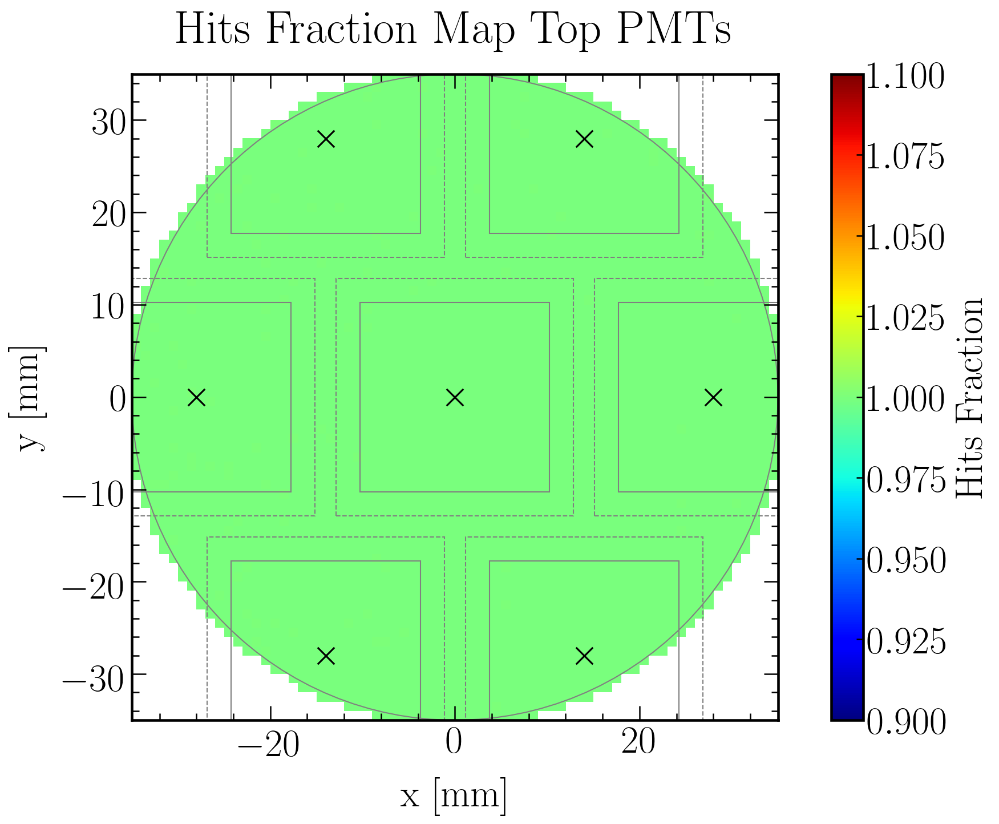

In [26]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
i = 1
plt.imshow(HF_x_y_hist2d_perPMT['histT'].sum(), interpolation='nearest', origin='low', extent=[LCE_x_y_hist2d_perPMT['xedges'].loc[i][0], LCE_x_y_hist2d_perPMT['xedges'].loc[i][-1], LCE_x_y_hist2d_perPMT['yedges'].loc[i][0], LCE_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('Hits Fraction Map Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='Hits Fraction', fontsize=label_size)
#plt.clim(0.0, 0.275)

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.show()
fig.savefig(filenameprefix+"_Hits_Fraction_x_y_Top.png")

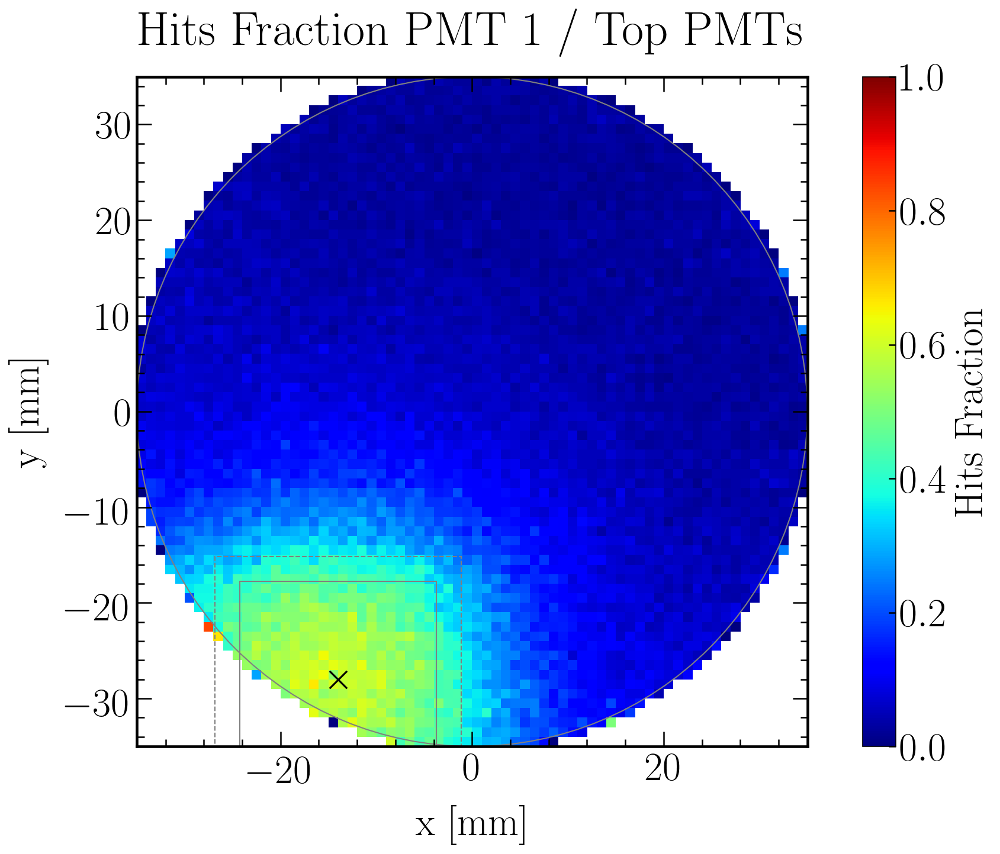

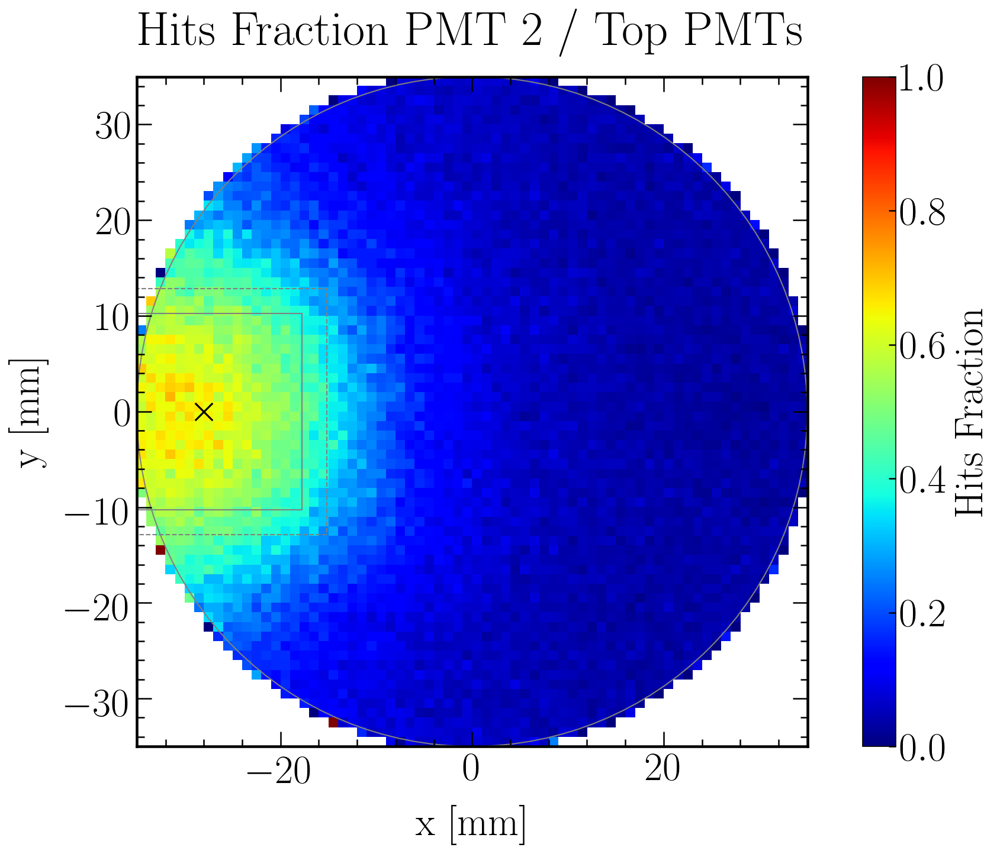

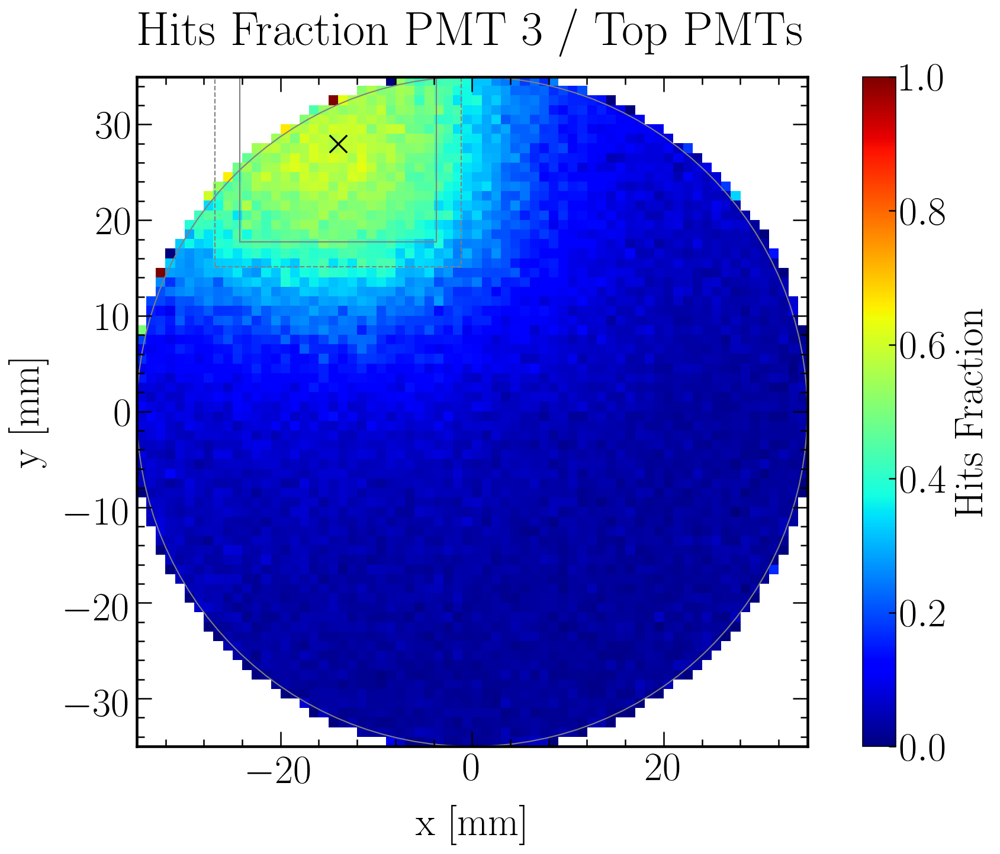

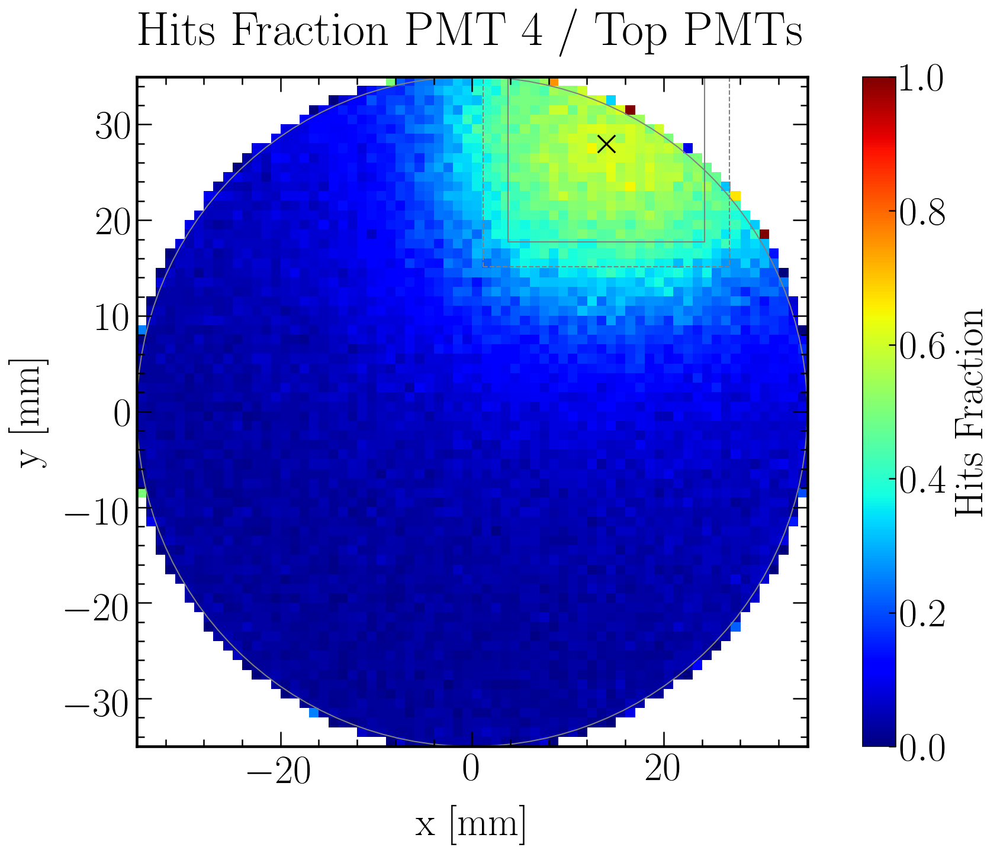

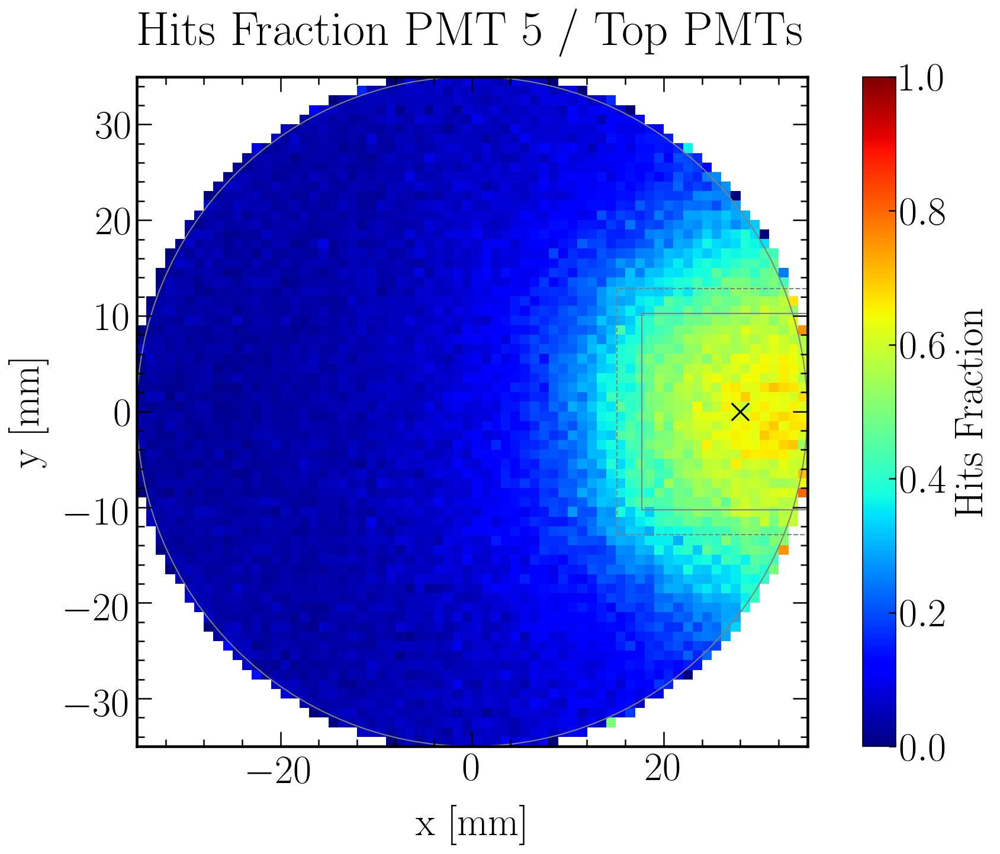

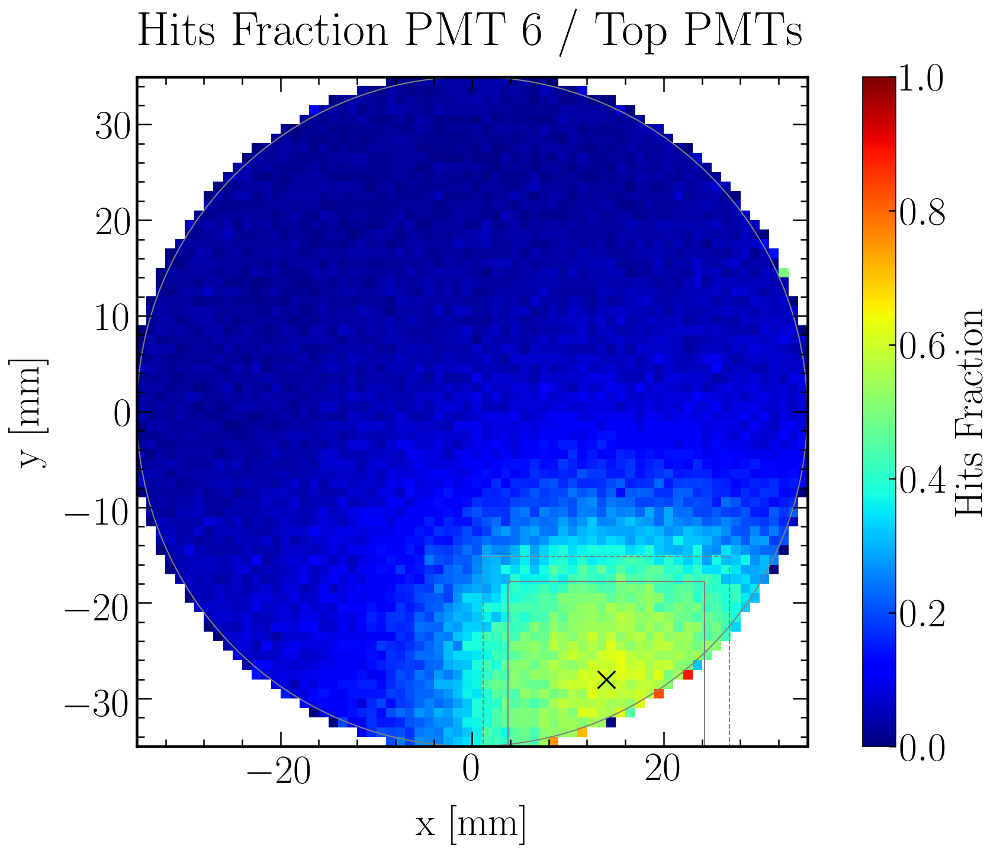

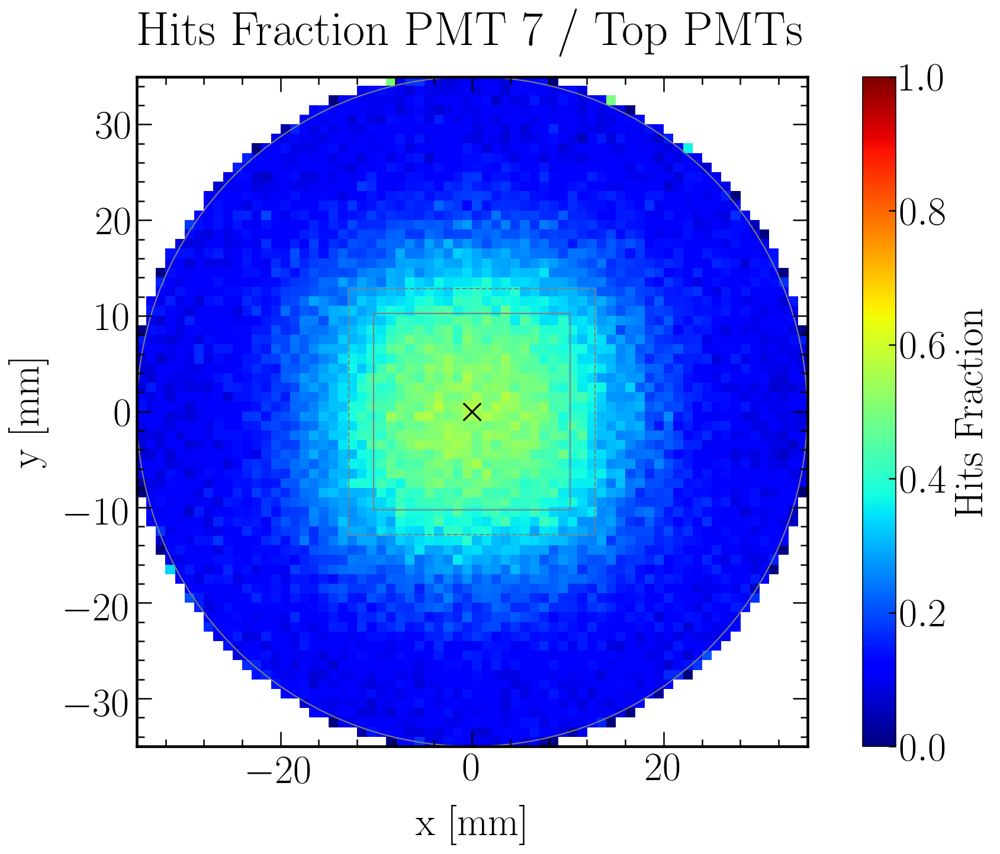

In [27]:
for i in range(1,8):
    
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    plt.imshow(HF_x_y_hist2d_perPMT['histT'].loc[i], interpolation='nearest', origin='low', extent=[HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Hits Fraction PMT '+str(i)+' / Top PMTs', fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(0.0, 1.0)
        
    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs.png")

### Centroid and Corrected Centroid

In [28]:
## Grid of true positions
grid_true = np.meshgrid(HF_x_y_hist2d_perPMT['xedges_center'][7], HF_x_y_hist2d_perPMT['yedges_center'][7])

In [29]:
## Centroids
centroids_x = (PMT_positions['PMT_position_x'].loc[1]*HF_x_y_hist2d_perPMT['histT'].loc[1]+PMT_positions['PMT_position_x'].loc[2]*HF_x_y_hist2d_perPMT['histT'].loc[2]+PMT_positions['PMT_position_x'].loc[3]*HF_x_y_hist2d_perPMT['histT'].loc[3]+PMT_positions['PMT_position_x'].loc[4]*HF_x_y_hist2d_perPMT['histT'].loc[4]+PMT_positions['PMT_position_x'].loc[5]*HF_x_y_hist2d_perPMT['histT'].loc[5]+PMT_positions['PMT_position_x'].loc[6]*HF_x_y_hist2d_perPMT['histT'].loc[6]+PMT_positions['PMT_position_x'].loc[7]*HF_x_y_hist2d_perPMT['histT'].loc[7])/(HF_x_y_hist2d_perPMT['histT'].sum())
centroids_y = (PMT_positions['PMT_position_y'].loc[1]*HF_x_y_hist2d_perPMT['histT'].loc[1]+PMT_positions['PMT_position_y'].loc[2]*HF_x_y_hist2d_perPMT['histT'].loc[2]+PMT_positions['PMT_position_y'].loc[3]*HF_x_y_hist2d_perPMT['histT'].loc[3]+PMT_positions['PMT_position_y'].loc[4]*HF_x_y_hist2d_perPMT['histT'].loc[4]+PMT_positions['PMT_position_y'].loc[5]*HF_x_y_hist2d_perPMT['histT'].loc[5]+PMT_positions['PMT_position_y'].loc[6]*HF_x_y_hist2d_perPMT['histT'].loc[6]+PMT_positions['PMT_position_y'].loc[7]*HF_x_y_hist2d_perPMT['histT'].loc[7])/(HF_x_y_hist2d_perPMT['histT'].sum())

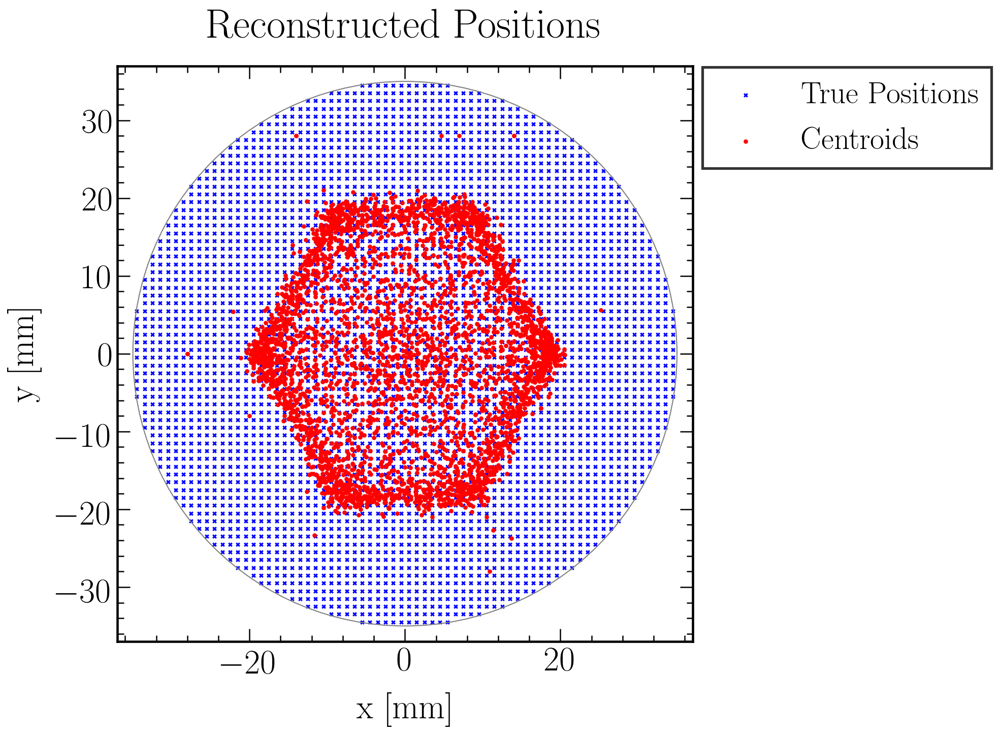

In [30]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
plt.scatter(grid_true[0][f_polar_R(grid_true[0], grid_true[1]) < 35], grid_true[1][f_polar_R(grid_true[0], grid_true[1]) < 35], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
# plt.scatter(grid_true[0],grid_true[1], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
# plt.scatter(grid_true[0],grid_true[1], color = 'k', s = HF_x_y_hist2d_perPMT['histT'].loc[7]*10000/numberbins)
plt.scatter(centroids_x, centroids_y, color = 'red', s = 10, label = 'Centroids')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_Centroids.png", bbox_inches = "tight")

In [31]:
'''#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
plt.hist(flatten_tuples(centroids_x - grid_true[0]), bins = 35, histtype = 'step', linewidth = 2.2, label = 'x-position', color = 'red')
plt.hist(flatten_tuples(centroids_y - grid_true[1]), bins = 35, histtype = 'step', linewidth = 2.2, label = 'y-position', color = 'blue')

plt.xlabel('Position Centroids - True [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Counts', fontsize = label_size, labelpad = label_pad)
plt.title('Deviations Centroids', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Centroids_Deviations_x.png")
plt.show()''';

In [32]:
## Corrected Centroids
## Corrected by weight with inverse Photoelectrode coverage
centroids_x_corrected_PEC = (PMT_positions['PMT_position_x'].loc[1]*HF_x_y_hist2d_perPMT['histT'].loc[1]/PECoverage_Top[1-1]+PMT_positions['PMT_position_x'].loc[2]*HF_x_y_hist2d_perPMT['histT'].loc[2]/PECoverage_Top[2-1]+PMT_positions['PMT_position_x'].loc[3]*HF_x_y_hist2d_perPMT['histT'].loc[3]/PECoverage_Top[3-1]+PMT_positions['PMT_position_x'].loc[4]*HF_x_y_hist2d_perPMT['histT'].loc[4]/PECoverage_Top[4-1]+PMT_positions['PMT_position_x'].loc[5]*HF_x_y_hist2d_perPMT['histT'].loc[5]/PECoverage_Top[5-1]+PMT_positions['PMT_position_x'].loc[6]*HF_x_y_hist2d_perPMT['histT'].loc[6]/PECoverage_Top[6-1]+PMT_positions['PMT_position_x'].loc[7]*HF_x_y_hist2d_perPMT['histT'].loc[7]/PECoverage_Top[7-1]) / (HF_x_y_hist2d_perPMT['histT'].loc[1]/PECoverage_Top[1-1]+HF_x_y_hist2d_perPMT['histT'].loc[2]/PECoverage_Top[2-1]+HF_x_y_hist2d_perPMT['histT'].loc[3]/PECoverage_Top[3-1]+HF_x_y_hist2d_perPMT['histT'].loc[4]/PECoverage_Top[4-1]+HF_x_y_hist2d_perPMT['histT'].loc[5]/PECoverage_Top[5-1]+HF_x_y_hist2d_perPMT['histT'].loc[6]/PECoverage_Top[6-1]+HF_x_y_hist2d_perPMT['histT'].loc[7]/PECoverage_Top[7-1])
centroids_y_corrected_PEC = (PMT_positions['PMT_position_y'].loc[1]*HF_x_y_hist2d_perPMT['histT'].loc[1]/PECoverage_Top[1-1]+PMT_positions['PMT_position_y'].loc[2]*HF_x_y_hist2d_perPMT['histT'].loc[2]/PECoverage_Top[2-1]+PMT_positions['PMT_position_y'].loc[3]*HF_x_y_hist2d_perPMT['histT'].loc[3]/PECoverage_Top[3-1]+PMT_positions['PMT_position_y'].loc[4]*HF_x_y_hist2d_perPMT['histT'].loc[4]/PECoverage_Top[4-1]+PMT_positions['PMT_position_y'].loc[5]*HF_x_y_hist2d_perPMT['histT'].loc[5]/PECoverage_Top[5-1]+PMT_positions['PMT_position_y'].loc[6]*HF_x_y_hist2d_perPMT['histT'].loc[6]/PECoverage_Top[6-1]+PMT_positions['PMT_position_y'].loc[7]*HF_x_y_hist2d_perPMT['histT'].loc[7]/PECoverage_Top[7-1]) / (HF_x_y_hist2d_perPMT['histT'].loc[1]/PECoverage_Top[1-1]+HF_x_y_hist2d_perPMT['histT'].loc[2]/PECoverage_Top[2-1]+HF_x_y_hist2d_perPMT['histT'].loc[3]/PECoverage_Top[3-1]+HF_x_y_hist2d_perPMT['histT'].loc[4]/PECoverage_Top[4-1]+HF_x_y_hist2d_perPMT['histT'].loc[5]/PECoverage_Top[5-1]+HF_x_y_hist2d_perPMT['histT'].loc[6]/PECoverage_Top[6-1]+HF_x_y_hist2d_perPMT['histT'].loc[7]/PECoverage_Top[7-1])

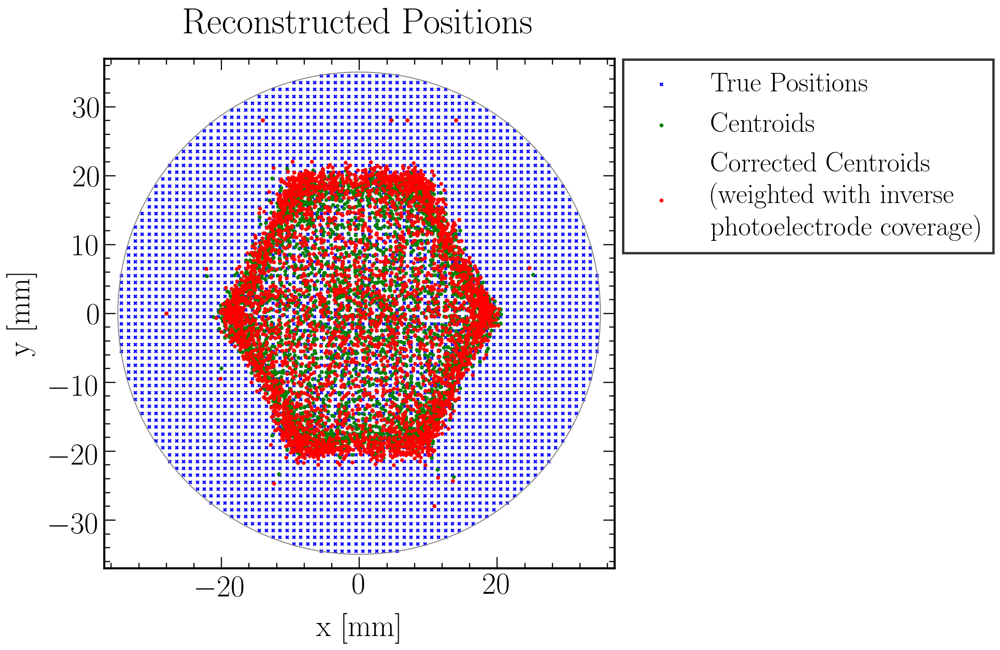

In [33]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
plt.scatter(grid_true[0][f_polar_R(grid_true[0], grid_true[1]) < 35], grid_true[1][f_polar_R(grid_true[0], grid_true[1]) < 35], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
# plt.scatter(grid_true[0],grid_true[1], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
# plt.scatter(grid_true[0],grid_true[1], color = 'k', s = HF_x_y_hist2d_perPMT['histT'].loc[7]*10000/numberbins)
plt.scatter(centroids_x, centroids_y, color = 'green', s = 10, label = 'Centroids')
plt.scatter(centroids_x_corrected_PEC, centroids_y_corrected_PEC, color = 'red', s = 10, label = 'Corrected Centroids\n(weighted with inverse\nphotoelectrode coverage)')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_Centroids_CorrectedPEC.png", bbox_inches = "tight")

In [34]:
'''#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
plt.hist(flatten_tuples(centroids_x - grid_true[0]), bins = 35, histtype = 'step', linewidth = 2.2, label = 'x-position centroids', color = 'red', linestyle = 'dashed')
plt.hist(flatten_tuples(centroids_y - grid_true[1]), bins = 35, histtype = 'step', linewidth = 2.2, label = 'y-position centroids', color = 'blue', linestyle = 'dashed')
plt.hist(flatten_tuples(centroids_x_corrected_PEC - grid_true[0]), bins = 35, histtype = 'step', linewidth = 2.2, label = 'x-position corrected\ncentroids', color = 'red')
plt.hist(flatten_tuples(centroids_y_corrected_PEC - grid_true[1]), bins = 35, histtype = 'step', linewidth = 2.2, label = 'y-position corrected\ncentroids', color = 'blue')

plt.xlabel('Position Corrected Centroids - True [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Counts', fontsize = label_size, labelpad = label_pad)
plt.title('Deviations Corrected Centroids', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Centroids_CorrectedPEC_Deviations_x.png")
plt.show()''';

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: invalid value encountered in less
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in less


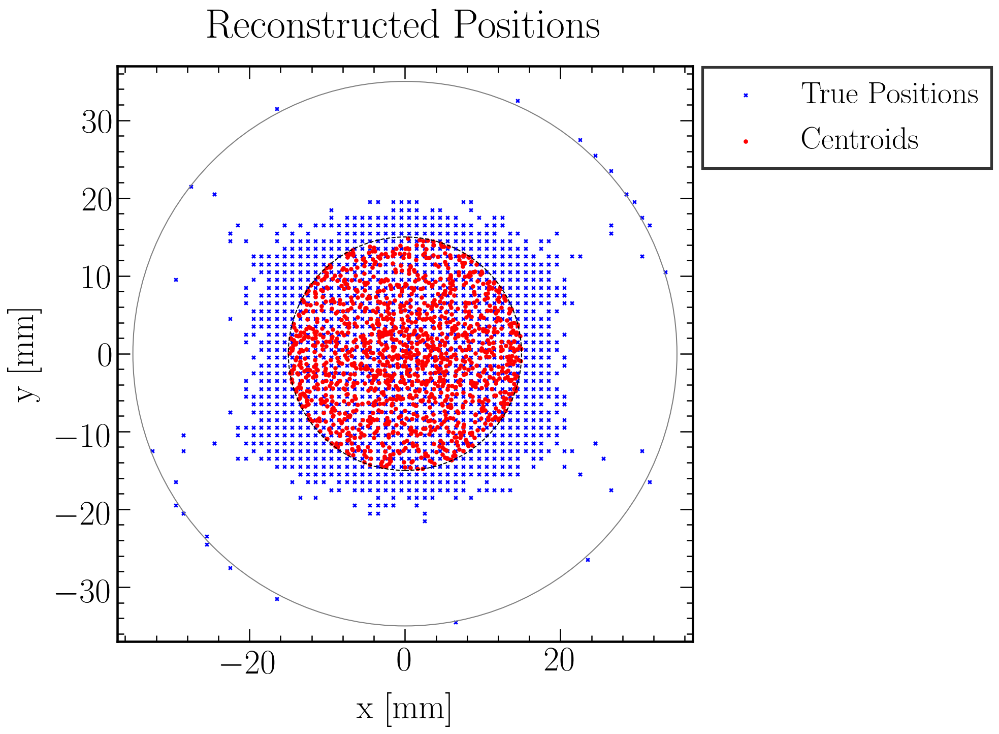

In [35]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
cut = 15
plt.scatter(grid_true[0][f_polar_R(centroids_x, centroids_y) < cut], grid_true[1][f_polar_R(centroids_x, centroids_y) < cut], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(centroids_x[f_polar_R(centroids_x, centroids_y) < cut], centroids_y[f_polar_R(centroids_x, centroids_y) < cut], color = 'red', s = 10, label = 'Centroids')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

circle2 = plt.Circle((0., 0.), cut, color='k', linestyle = '--', fill=False)
currentAxis.add_artist(circle2)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_Centroids_Confined"+str(cut)+".png", bbox_inches = "tight")

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in less
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:43: RuntimeWarning: invalid value encountered in less


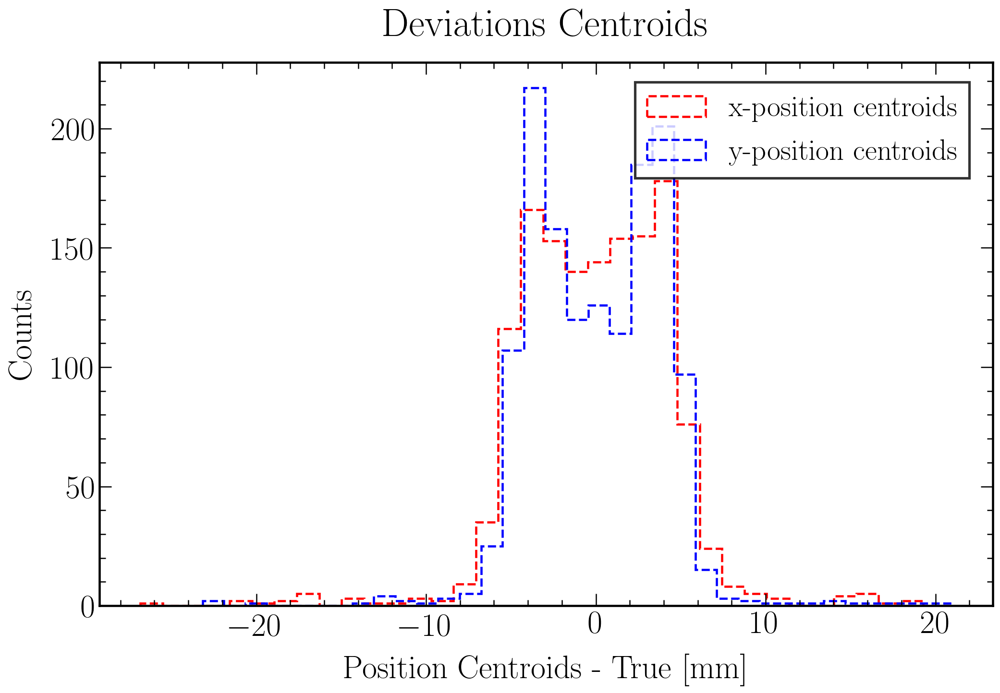

In [36]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
plt.hist(centroids_x[f_polar_R(centroids_x, centroids_y) < cut] - grid_true[0][f_polar_R(centroids_x, centroids_y) < cut], bins = 35, histtype = 'step', linewidth = 2.2, label = 'x-position centroids', color = 'red', linestyle = 'dashed')
plt.hist(centroids_y[f_polar_R(centroids_x, centroids_y) < cut] - grid_true[1][f_polar_R(centroids_x, centroids_y) < cut], bins = 35, histtype = 'step', linewidth = 2.2, label = 'y-position centroids', color = 'blue', linestyle = 'dashed')
#plt.hist(flatten_tuples(centroids_x_corrected_PEC - grid_true[0]), bins = 35, histtype = 'step', linewidth = 2.2, label = 'x-position corrected\ncentroids', color = 'red')
#plt.hist(flatten_tuples(centroids_y_corrected_PEC - grid_true[1]), bins = 35, histtype = 'step', linewidth = 2.2, label = 'y-position corrected\ncentroids', color = 'blue')

plt.xlabel('Position Centroids - True [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Counts', fontsize = label_size, labelpad = label_pad)
plt.title('Deviations Centroids', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_Centroids_Confined"+str(cut)+"_Deviations.png")
plt.show()

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:40: RuntimeWarning: invalid value encountered in less
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in less


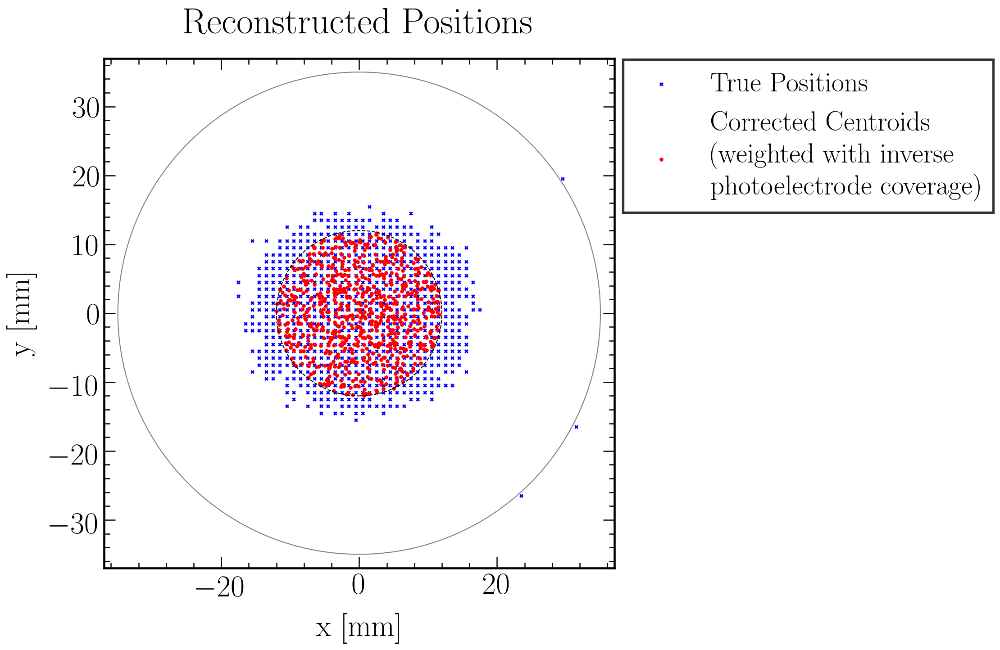

In [37]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
cut = 12
plt.scatter(grid_true[0][f_polar_R(centroids_x_corrected_PEC, centroids_y_corrected_PEC) < cut], grid_true[1][f_polar_R(centroids_x_corrected_PEC, centroids_y_corrected_PEC) < cut], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(centroids_x_corrected_PEC[f_polar_R(centroids_x_corrected_PEC, centroids_y_corrected_PEC) < cut], centroids_y_corrected_PEC[f_polar_R(centroids_x_corrected_PEC, centroids_y_corrected_PEC) < cut], color = 'red', s = 10, label = 'Corrected Centroids\n(weighted with inverse\nphotoelectrode coverage)')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

circle2 = plt.Circle((0., 0.), cut, color='k', linestyle = '--', fill=False)
currentAxis.add_artist(circle2)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_Centroids_CorrectedPEC_Confined"+str(cut)+".png", bbox_inches = "tight")

In [38]:
Centroids_xy = pd.DataFrame({'grid_true' : [grid_true], 'centroids_x' : [centroids_x], 'centroids_y' : [centroids_y], 'centroids_x_corrected_PEC': [centroids_x_corrected_PEC], 'centroids_y_corrected_PEC' : [centroids_y_corrected_PEC]})
Centroids_xy

,grid_true,centroids_x,centroids_y,centroids_x_corrected_PEC,centroids_y_corrected_PEC
0,"[[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[nan, nan, nan, nan, nan, nan, nan, nan, nan,..."


### Radial Dependence

In [555]:
# Fraction of arc length of radius r at radial position d inside circle of radius R
def arc_fraction(r, R, d):
    return np.piecewise(r, [r <= (R - d), r >= (R + d)], [lambda r: 1., lambda r: 0., lambda r: (1 / np.pi * np.arccos( (r**2 - R**2 + d**2) / (2 * d * r) ))])

# Fraction of arc length of radius r at radial position d inside circle of radius R
def arc_length(r, R, d):
    return 2 * np.pi * r * arc_fraction(r, R, d)

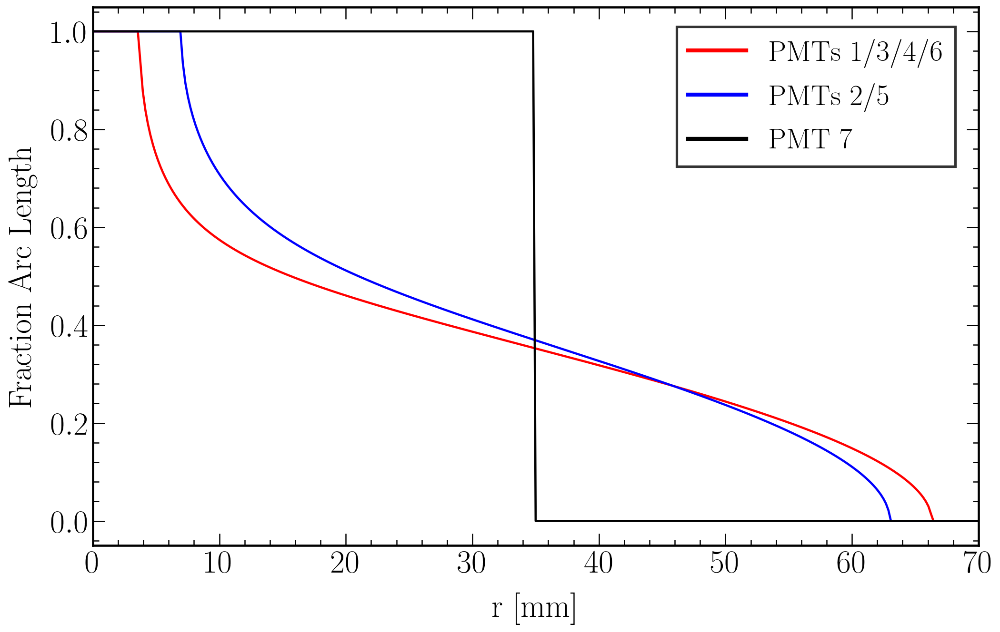

In [40]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
r = np.linspace(0.0, 70.0, num=71*5)
plt.plot(r, arc_fraction(r, 35., PMT_positions['PMT_position_R'][1]), 'r', label = r"PMTs 1/3/4/6", linewidth = 2.2)
plt.plot(r, arc_fraction(r, 35., PMT_positions['PMT_position_R'][2]), 'b', label = r"PMTs 2/5", linewidth = 2.2)
plt.plot(r, arc_fraction(r, 35., PMT_positions['PMT_position_R'][7]), 'k', label = r"PMT  7", linewidth = 2.2)
    
plt.xlim(0,70)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Fraction Arc Length', fontsize = label_size, labelpad = label_pad)
#plt.title('Fraction Arc Length', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig("Fraction_ArcLengths.png")
plt.show()

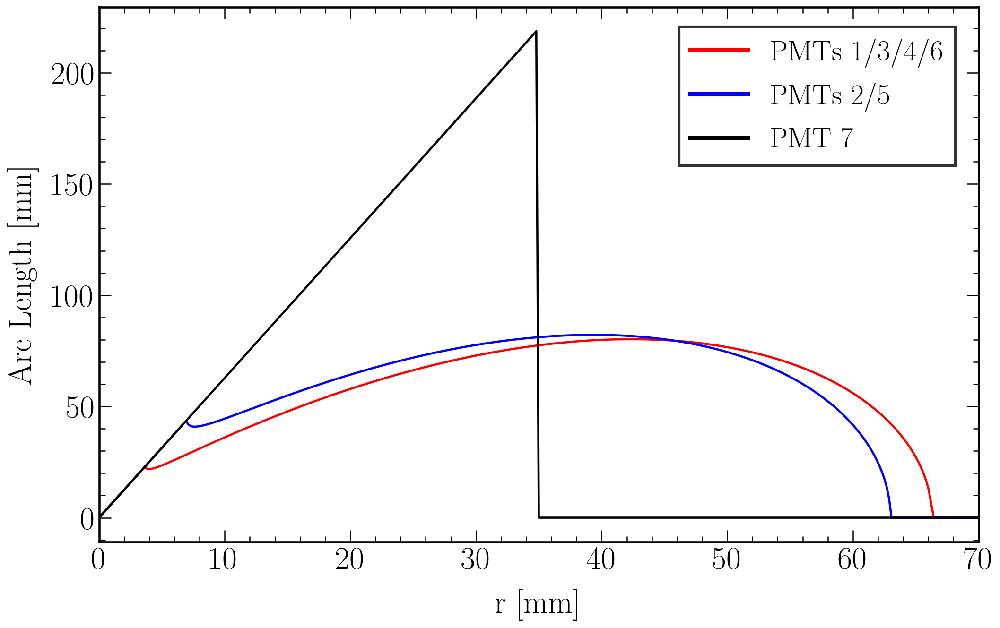

In [557]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

#numberbins = 70

# Data plot
r = np.linspace(0.0, 70.0, num=71*5)
plt.plot(r, arc_length(r, 35., PMT_positions['PMT_position_R'][1]), 'r', label = r"PMTs 1/3/4/6", linewidth = 2.2)
plt.plot(r, arc_length(r, 35., PMT_positions['PMT_position_R'][2]), 'b', label = r"PMTs 2/5", linewidth = 2.2)
plt.plot(r, arc_length(r, 35., PMT_positions['PMT_position_R'][7]), 'k', label = r"PMT  7", linewidth = 2.2)
    
plt.xlim(0,70)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Arc Length [mm]', fontsize = label_size, labelpad = label_pad)
#plt.title('Fraction Arc Length', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig("ArcLengths.png")
plt.show()

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in true_divide
  # Remove the CWD from sys.path while we load stuff.


,PMT_ID,n,bins,bins_center
1,[1],"[0.2804123711340206, 0.283840190816935, 0.2871...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
2,[2],"[0.3016759776536313, 0.3311416616855947, 0.337...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
3,[3],"[0.2836624775583483, 0.2663699936427209, 0.282...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
4,[4],"[0.3044315992292871, 0.2834190231362468, 0.274...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
5,[5],"[0.3125, 0.31467661691542287, 0.32984104046242...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
6,[6],"[0.3083778966131907, 0.28774193548387095, 0.28...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
7,[7],"[0.3053311793214863, 0.2801600914808462, 0.269...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."


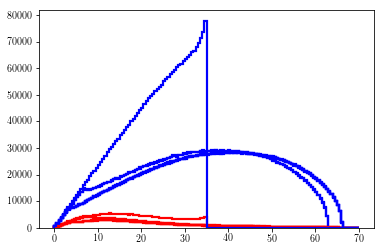

In [41]:
numberbins = 70*2

LCE_R_hist = pd.DataFrame({'PMT_ID': [],'n': [], 'bins': [], 'bins_center': []})
columns = ['PMT_ID', 'n', 'bins', 'bins_center']

for i in range(1,8):
    n_pmti, bins, patches = plt.hist(f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],_chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), numberbins, weights = _chunk_collect["pmthits_"+str(i)], range = (0,35*2), histtype = 'step', linewidth = 2.2, label = 'All PMTs', color = 'red')
    n_top, bins, patches = plt.hist(f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],_chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), numberbins, weights = None, range = (0,35*2), histtype = 'step', linewidth = 2.2, label = 'All PMTs', color = 'blue')

    LCE_R_hist_PMTi_n = n_pmti / n_top
    LCE_R_hist_PMTi_bins = bins
    LCE_R_hist_PMTi_bins_center = (bins[:-1]+bins[1:])/2

    values = [np.array([i]), LCE_R_hist_PMTi_n, LCE_R_hist_PMTi_bins, LCE_R_hist_PMTi_bins_center]
    LCE_R_hist = LCE_R_hist.append(pd.DataFrame(index = [i], data = [np.array(values)], columns=columns)) #, ignore_index=True

#LCE_R_hist = pd.DataFrame(index = [7], data={'PMT_ID': [7],'n': [LCE_R_hist_PMT7_n], 'bins': [LCE_R_hist_PMT7_bins], 'bins_center': [LCE_R_hist_PMT7_bins_center]})

LCE_R_hist.to_pickle(filenameprefix+"_LCE_R_hist.pkl")
LCE_R_hist

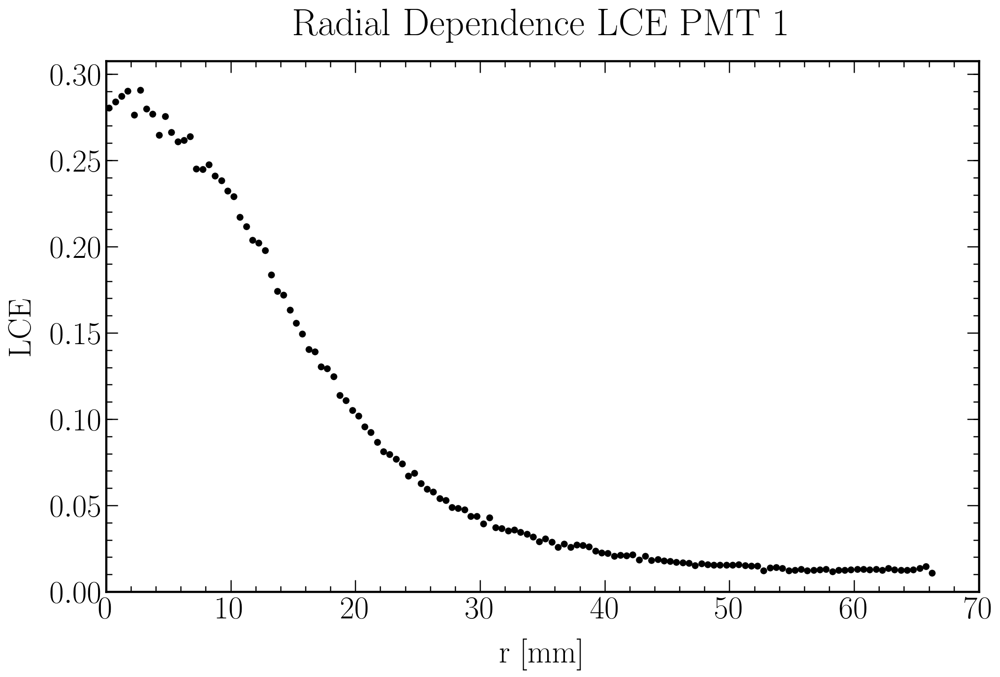

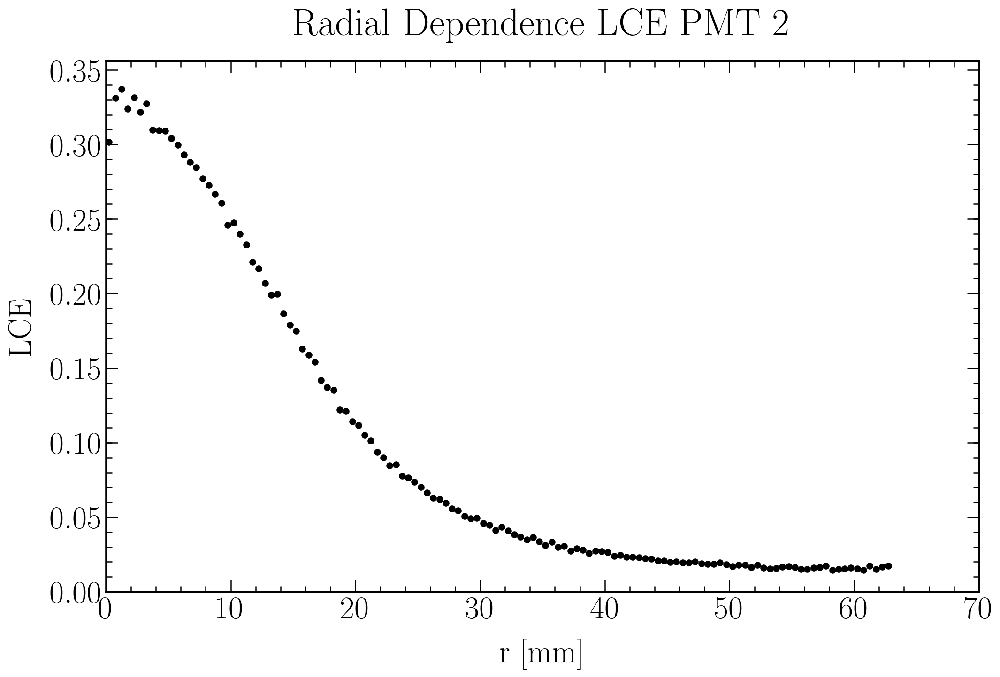

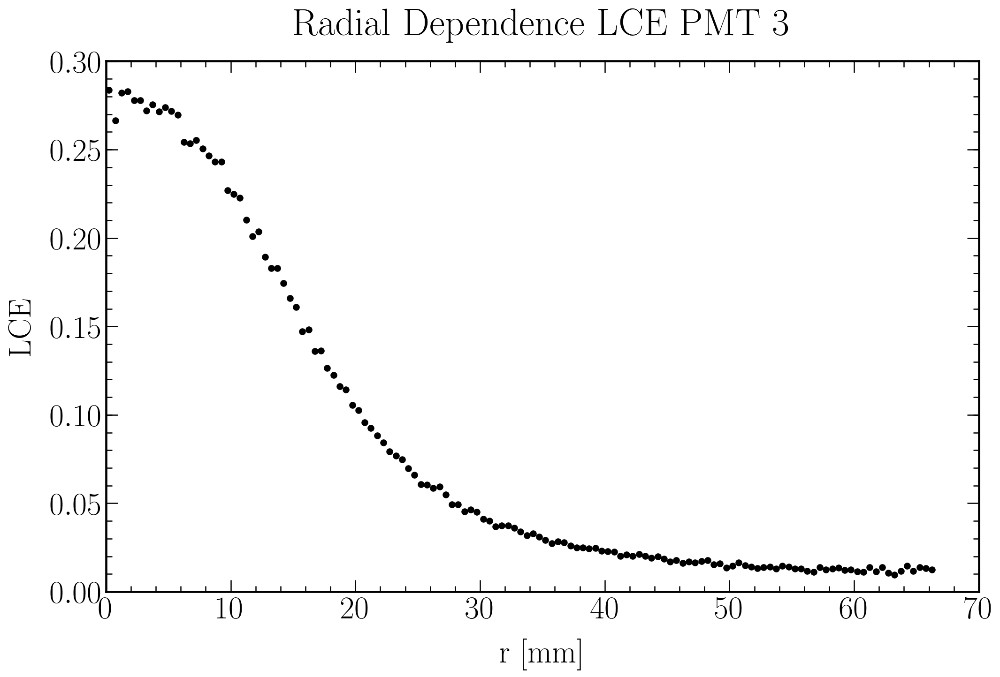

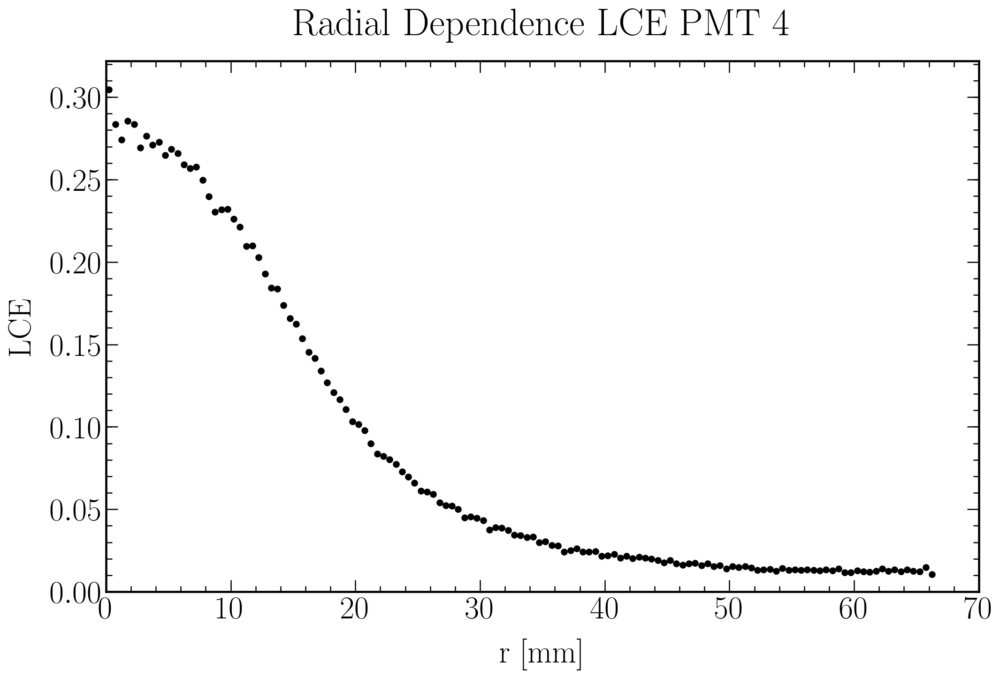

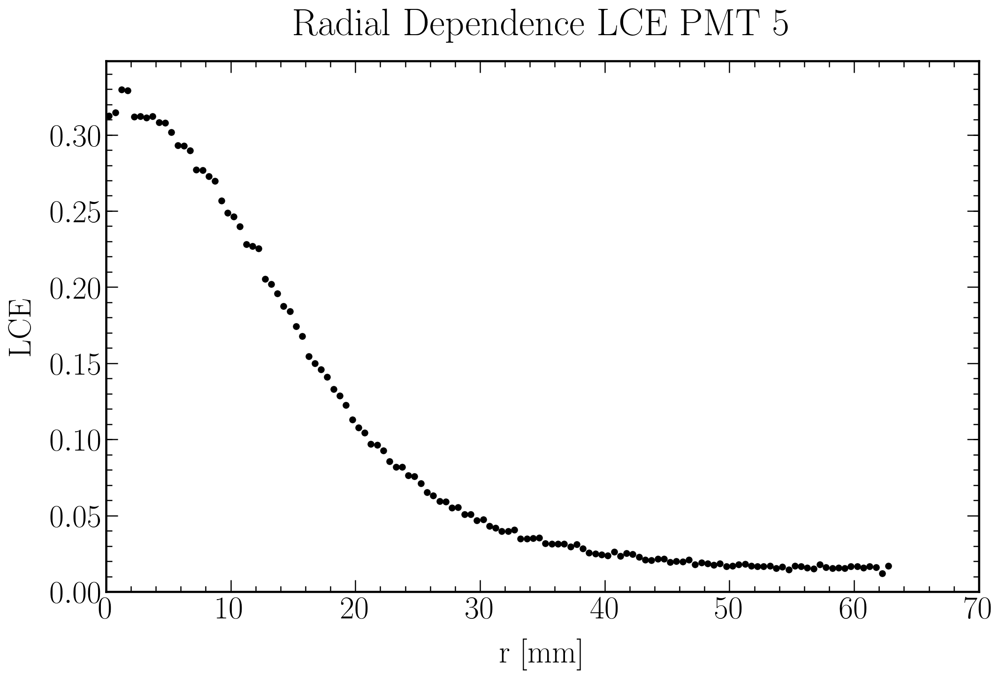

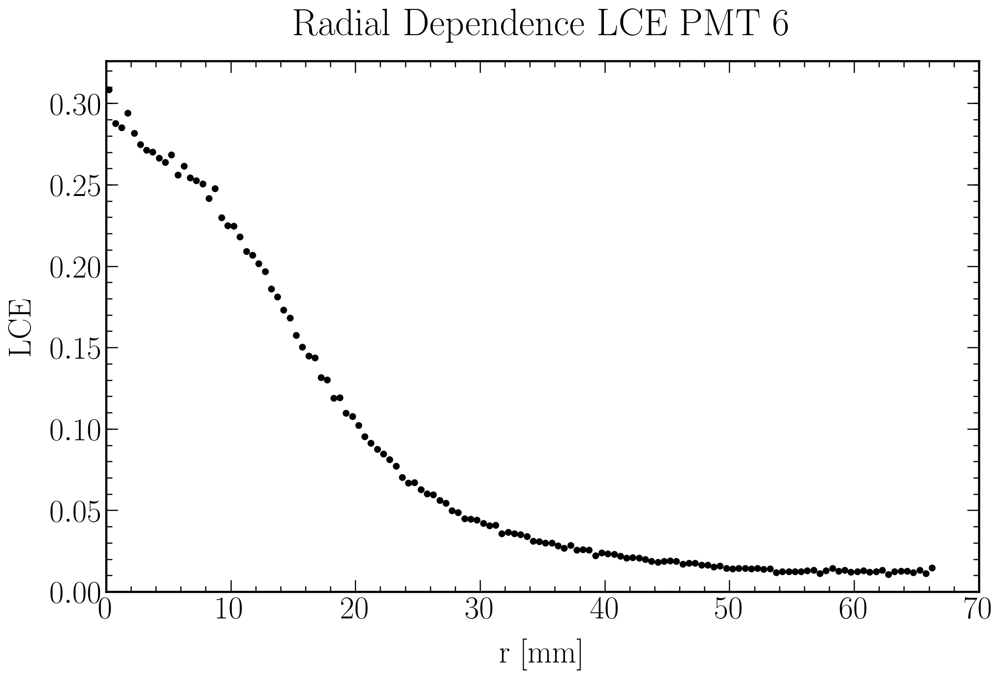

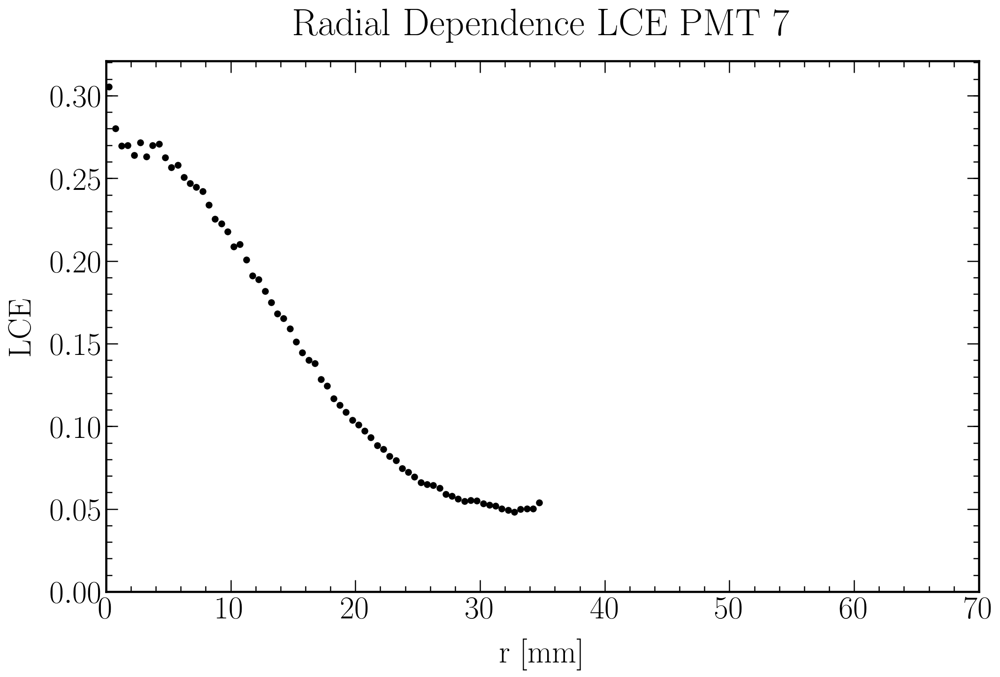

In [42]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70*2

    # Data plot
    plt.scatter(LCE_R_hist['bins_center'][i], LCE_R_hist['n'][i], color = 'k')

    plt.ylim(bottom=0)
    plt.xlim(0.,35.*2)

    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('LCE', fontsize = label_size, labelpad = label_pad)
    plt.title('Radial Dependence LCE PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.show()
    fig.savefig(filenameprefix+"_LCE_R_PMT"+str(i)+".png")

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in true_divide
  # Remove the CWD from sys.path while we load stuff.


,PMT_ID,n,bins,bins_center
1,[1],"[0.6071428571428571, 0.5639810426540285, 0.579...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
2,[2],"[0.6558704453441295, 0.6449359720605355, 0.660...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
3,[3],"[0.6030534351145038, 0.5601604278074866, 0.604...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
4,[4],"[0.5787545787545788, 0.588, 0.587327376116978,...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
5,[5],"[0.6205673758865248, 0.6325, 0.640252454417952...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
6,[6],"[0.6178571428571429, 0.58994708994709, 0.59555...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."
7,[7],"[0.5692771084337349, 0.5426356589147286, 0.548...","[0.0, 0.5, 1.0, 1.5, 2.0, 2.5, 3.0, 3.5, 4.0, ...","[0.25, 0.75, 1.25, 1.75, 2.25, 2.75, 3.25, 3.7..."


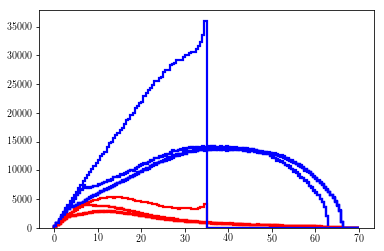

In [43]:
numberbins = 70*2

HF_R_hist = pd.DataFrame({'PMT_ID': [],'n': [], 'bins': [], 'bins_center': []})
columns = ['PMT_ID', 'n', 'bins', 'bins_center']

for i in range(1,8):
    n_pmti, bins, patches = plt.hist(f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],_chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), numberbins, weights = _chunk_collect["pmthits_"+str(i)], range = (0,35*2), histtype = 'step', linewidth = 2.2, label = 'All PMTs', color = 'red')
    n_top, bins, patches = plt.hist(f_polar_R(_chunk_collect["xp_pri"] - PMT_positions['PMT_position_x'][i],_chunk_collect["yp_pri"] - PMT_positions['PMT_position_y'][i]), numberbins, weights = _chunk_collect["ntpmthits"], range = (0,35*2), histtype = 'step', linewidth = 2.2, label = 'All PMTs', color = 'blue')

    HF_R_hist_PMTi_n = n_pmti / n_top
    HF_R_hist_PMTi_bins = bins
    HF_R_hist_PMTi_bins_center = (bins[:-1]+bins[1:])/2

    values = [np.array([i]), HF_R_hist_PMTi_n, HF_R_hist_PMTi_bins, HF_R_hist_PMTi_bins_center]
    HF_R_hist = HF_R_hist.append(pd.DataFrame(index = [i], data = [np.array(values)], columns=columns)) #, ignore_index=True

#HF_R_hist = pd.DataFrame(index = [7], data={'PMT_ID': [7],'n': [HF_R_hist_PMT7_n], 'bins': [HF_R_hist_PMT7_bins], 'bins_center': [HF_R_hist_PMT7_bins_center]})

# remove nan
for i in range(1,8):
    HF_R_hist['bins_center'][i] = HF_R_hist['bins_center'][i][:len(HF_R_hist['n'][i][~np.isnan(HF_R_hist['n'][i])])]
    HF_R_hist['bins'][i] = HF_R_hist['bins'][i][:(len(HF_R_hist['n'][i][~np.isnan(HF_R_hist['n'][i])])+1)]
    HF_R_hist['n'][i] = HF_R_hist['n'][i][:len(HF_R_hist['n'][i][~np.isnan(HF_R_hist['n'][i])])]

'''HF_R_hist.to_csv(filenameprefix+'_HF_R_hist.csv', index=False) # , sep='\t', encoding='utf-8''';
HF_R_hist.to_pickle(filenameprefix+"_HF_R_hist.pkl")
HF_R_hist

In [44]:
## import from csv
# HF_R_hist = pd.read_csv('optPhot_S2_1e6_HF_R_hist.csv', index_col = 'PMT_ID', converters={'n': from_np_array, 'bins': from_np_array, 'bins_center': from_np_array})
## import from pkl
# HF_R_hist = pd.read_pickle("output/"+filenameprefix+"_HF_R_hist.pkl")
# LCE_R_hist = pd.read_pickle("output/"+filenameprefix+"_LCE_R_hist.pkl")

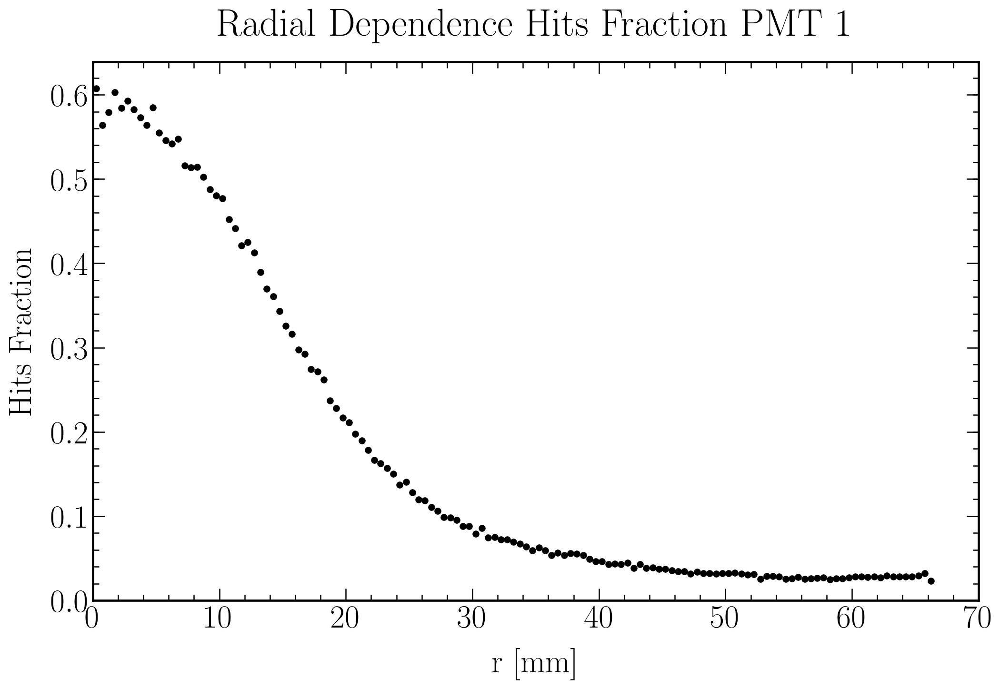

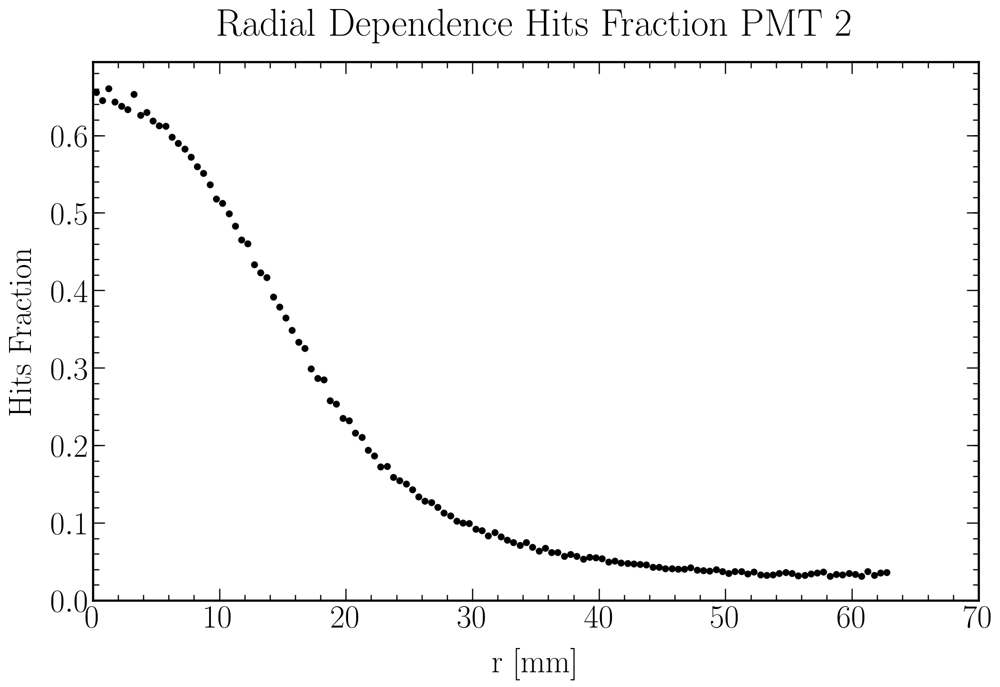

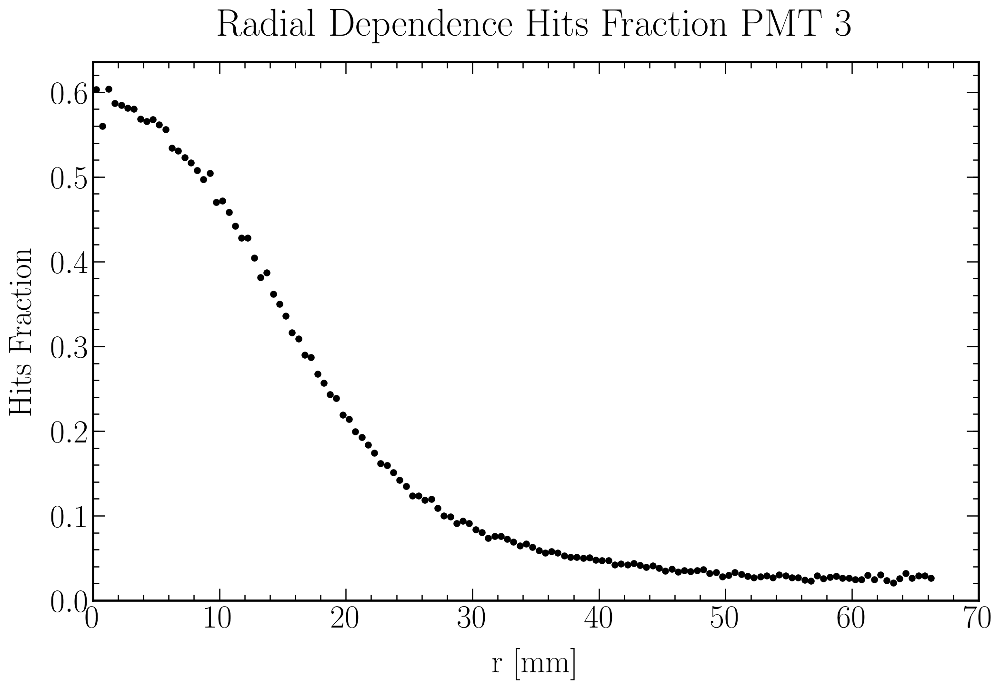

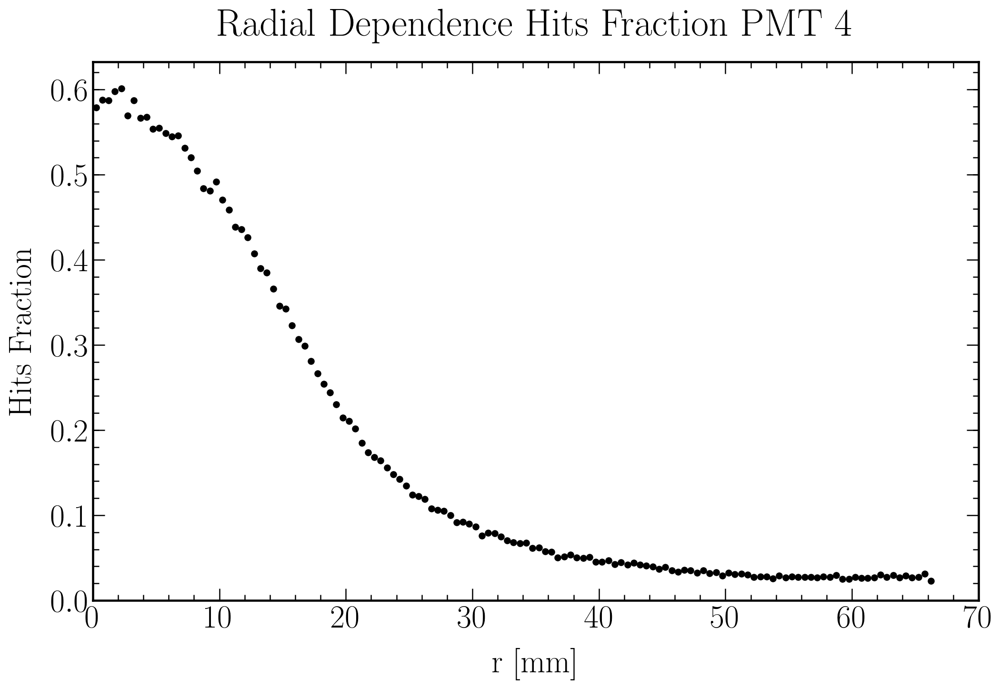

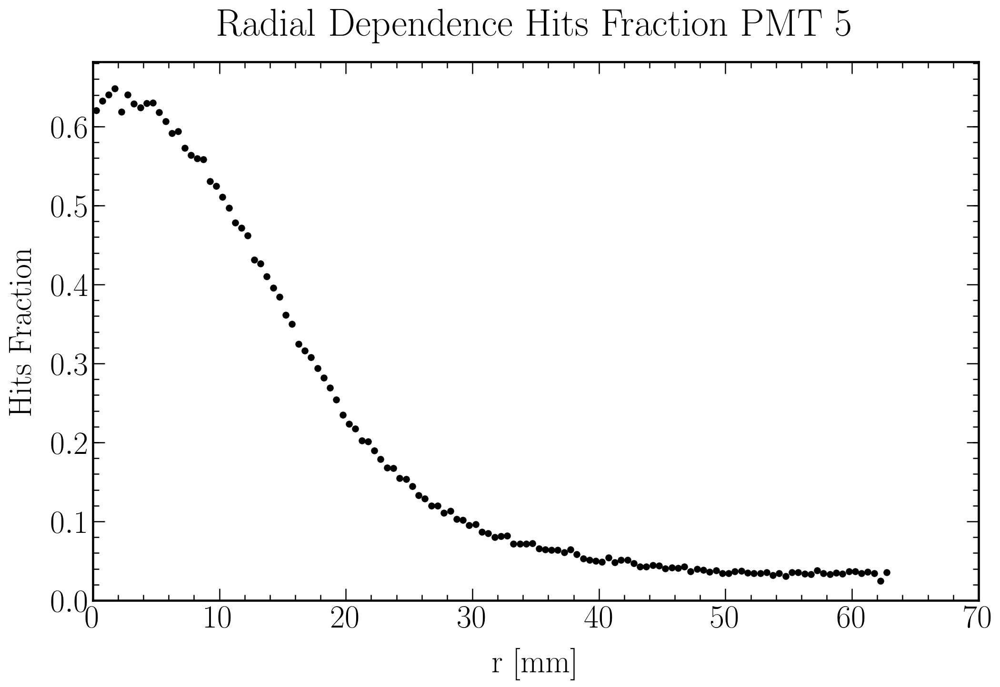

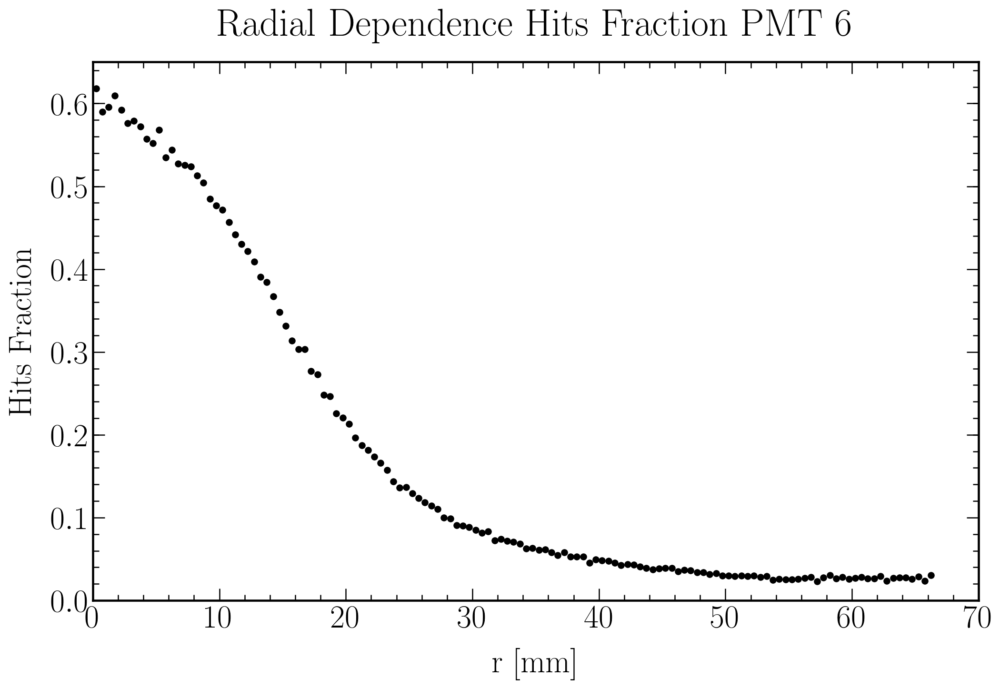

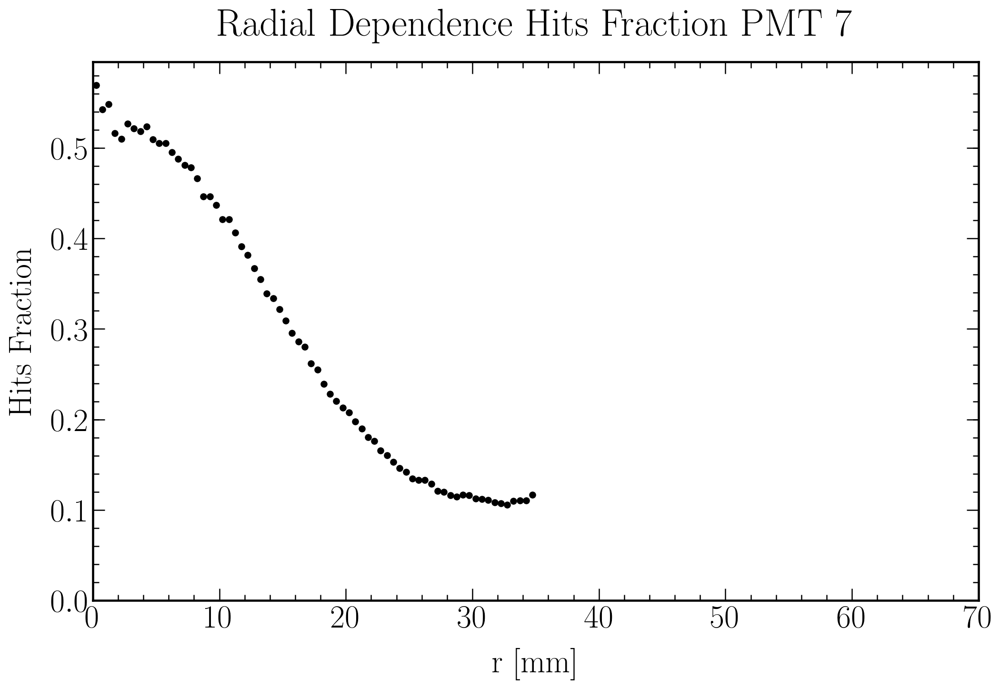

In [45]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70*2

    # Data plot
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], color = 'k')

    plt.ylim(bottom=0)
    plt.xlim(0.,35.*2)

    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('Radial Dependence Hits Fraction PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_R_PMT"+str(i)+".png")

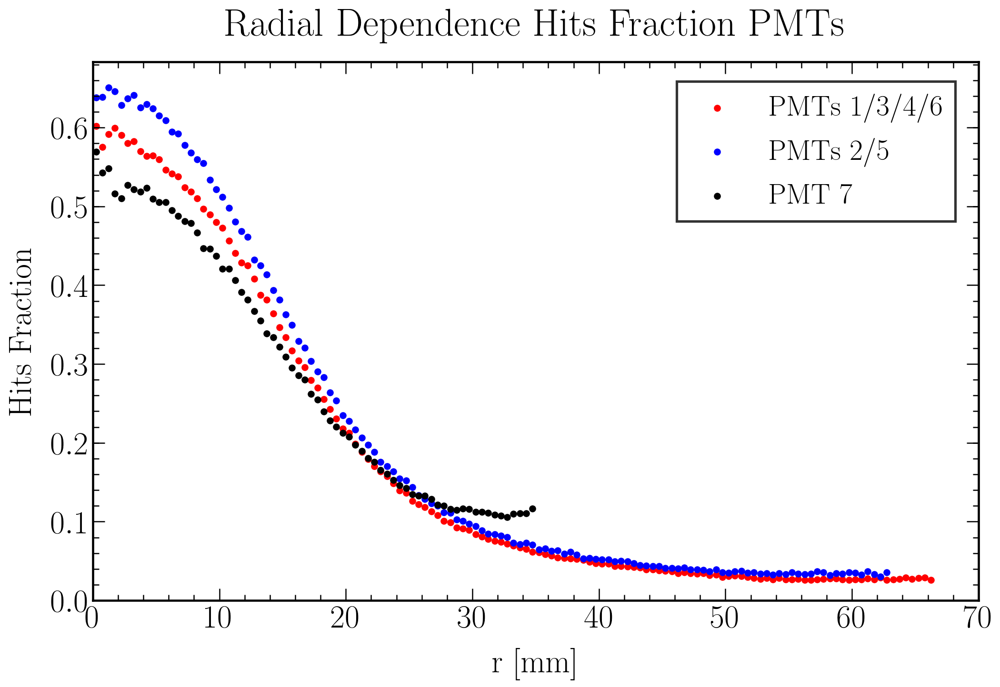

In [46]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70*2

# Data plot
plt.scatter(HF_R_hist['bins_center'][1], (HF_R_hist['n'][1]+HF_R_hist['n'][3]+HF_R_hist['n'][4]+HF_R_hist['n'][6])/4, color = 'r', label = "PMTs 1/3/4/6")
plt.scatter(HF_R_hist['bins_center'][2], (HF_R_hist['n'][2]+HF_R_hist['n'][5])/2, color = 'b', label = "PMTs 2/5")
'''
plt.scatter(HF_R_hist['bins_center'][1], HF_R_hist['n'][1], color = 'r')
plt.scatter(HF_R_hist['bins_center'][2], HF_R_hist['n'][2], color = 'b')
plt.scatter(HF_R_hist['bins_center'][3], HF_R_hist['n'][3], color = 'r')
plt.scatter(HF_R_hist['bins_center'][4], HF_R_hist['n'][4], color = 'r')
plt.scatter(HF_R_hist['bins_center'][5], HF_R_hist['n'][5], color = 'b')
plt.scatter(HF_R_hist['bins_center'][6], HF_R_hist['n'][6], color = 'r')
'''
plt.scatter(HF_R_hist['bins_center'][7], HF_R_hist['n'][7], color = 'k', label = "PMT 7")

plt.ylim(bottom=0)
plt.xlim(0.,35.*2)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
plt.title('Radial Dependence Hits Fraction PMTs', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_Hits_Fraction_R_PMTs.png")

In [47]:
'''#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
plt.scatter(HF_R_hist_PMT7_bins_center, HF_R_hist_PMT7_n / HF_R_hist_PMT7_n.mean(), color = 'Blue', label = 'Relative Hit Fraction')
plt.scatter(LCE_R_hist_PMT7_bins_center, LCE_R_hist_PMT7_n / LCE_R_hist_PMT7_n.mean(), color = 'Red', label = 'Relative LCE')

plt.ylim(bottom=0)
plt.xlim(0.,35.)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Relative Light Response', fontsize = label_size, labelpad = label_pad)
plt.title('Radial Dependence Light Response PMT 7', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_LCEvsHF_R_PMT7.png")''';

### Radial LRF

In [48]:
#filenameprefix = "optPhot_S2_3e7"
#HF_R_hist = pd.read_pickle('output/optPhot_S2_3e7_HF_R_hist.pkl')

In [49]:
## General additional function definitions

def exponetial(x, a, b, c):
    return a * np.exp(-b * x) + c

def gaussian(x, amp, cen, wid):
    return amp * exp(-(x-cen)**2 / wid)

def WoodsSaxonPotential(r, R, a, V0):
    return - V0 / (1 + exp((r - R) / a))

In [50]:
## Radial fit functions for LRF

## Position Reconstruction in LUX, https://arxiv.org/abs/1710.02752v2
def eta_v1(r, A, gamma, m, b):
    return A / (1 + gamma ** 2 * r ** 2) ** (3/2) + m * r + b

## Position Reconstruction in a Dual Phase Xenon Scintillation Detector, https://arxiv.org/abs/1112.1481
def eta_v2(r, A, r0, a, b, alpha):
    return A * exp( - a * (r/r0) / (1 + (r/r0) ** (1 - alpha)) - b / (1 + (r/r0) ** (- alpha)))   

## Modified Woods Saxon Potential
def eta_v3(r, R, a, V0, d):
    return V0 / (1 + np.exp((r - R) / a)) + d

## Modified Woods Saxon Potential + Linear
def eta_v4(r, R, a, V0, d, m):
    return V0 / (1 + np.exp((r - R) / a)) + d + m * r

#####################################################
## CHOICE FOR LRF MODEL
model = eta_v2
modelstring = 'eta_v2'

In [51]:
fit_parameters_eta_v1 = np.array([None]*7)
for i in range(1,8):
    popt, pcov = curve_fit(eta_v1, HF_R_hist['bins_center'][i], HF_R_hist['n'][i])
    fit_parameters_eta_v1[i-1] = popt
    
fit_parameters_eta_v2 = np.array([None]*7)
for i in range(1,8):
    popt, pcov = curve_fit(eta_v2, HF_R_hist['bins_center'][i], HF_R_hist['n'][i])
    fit_parameters_eta_v2[i-1] = popt
print('pcov_eta_v2 = \n'+str(pcov))
print('popt_eta_v2 = \n'+str(fit_parameters_eta_v2))

fit_parameters_eta_v3 = np.array([None]*7)
for i in range(1,8):
    popt, pcov = curve_fit(eta_v3, HF_R_hist['bins_center'][i], HF_R_hist['n'][i])
    fit_parameters_eta_v3[i-1] = popt
    
fit_parameters_eta_v4 = np.array([None]*7)
for i in range(1,8):
    popt, pcov = curve_fit(eta_v4, HF_R_hist['bins_center'][i], HF_R_hist['n'][i])
    fit_parameters_eta_v4[i-1] = popt
    
HF_R_hist_fit_parameters = pd.DataFrame({'eta_v1' : [fit_parameters_eta_v1], 'eta_v2' : [fit_parameters_eta_v2], 'eta_v3' : [fit_parameters_eta_v3], 'eta_v4' : [fit_parameters_eta_v4]}, index = ['fit_values'])
HF_R_hist_fit_parameters.to_pickle(filenameprefix+"_HF_R_hist_fit_parameters.pkl")

pcov_eta_v2 = 
[[ 5.17777093e-06 -1.56507399e-02  2.98051711e-02 -2.71909694e-02
   3.84087756e-04]
 [-1.56507399e-02  6.92557147e+02 -1.26058946e+03  1.15030553e+03
  -1.82718613e+01]
 [ 2.98051711e-02 -1.26058946e+03  2.29633014e+03 -2.09541669e+03
   3.32397325e+01]
 [-2.71909694e-02  1.15030553e+03 -2.09541669e+03  1.91208395e+03
  -3.03314864e+01]
 [ 3.84087756e-04 -1.82718613e+01  3.32397325e+01 -3.03314864e+01
   4.82440030e-01]]
popt_eta_v2 = 
[array([ 0.58680486, 30.43262806, -0.44438087,  4.3608348 ,  2.56777775])
 array([ 0.64653783, 31.0990343 , -0.73214041,  4.7338853 ,  2.51922416])
 array([ 0.58428961, 31.18394115, -0.52791863,  4.53138888,  2.55883353])
 array([ 0.58350209, 30.31195622, -0.43840153,  4.32543934,  2.61385101])
 array([ 0.63615794, 29.37507853, -0.38788144,  4.09500671,  2.64690113])
 array([ 0.58927715, 31.8458707 , -0.65175832,  4.76924503,  2.49825905])
 array([  0.53308763,  40.13290737, -17.48264737,  20.16512685,
         2.20902501])]


In [52]:
# Fits to optPhot_S2_3e7HF_R_hist

'''
fit_parameters_eta_v1 = np.array([None]*7)
fit_parameters_eta_v1[1-1] = np.array([ 1.10377187, -0.0460542 ,  0.00464143, -0.2966093 ])
fit_parameters_eta_v1[2-1] = np.array([ 1.20315191, -0.04475881,  0.00597389, -0.36907416])
fit_parameters_eta_v1[3-1] = np.array([ 1.10678085,  0.04590501,  0.00467322, -0.29908366])
fit_parameters_eta_v1[4-1] = np.array([ 1.09835901,  0.04615678,  0.00455232, -0.29139586])
fit_parameters_eta_v1[5-1] = np.array([ 1.20291803, -0.04481004,  0.00594797, -0.36757778])
fit_parameters_eta_v1[6-1] = np.array([ 1.09727781, -0.04648625,  0.00446665, -0.28559688])
fit_parameters_eta_v1[7-1] = np.array([-0.04668917,  1.15148658, -0.02417197,  0.76087121]) # A<0 unphysical

fit_parameters_eta_v2 = np.array([None]*7)
fit_parameters_eta_v2[1-1] = np.array([ 0.76071124, 24.51920777,  0.04781411,  3.91039384,  3.33590724])
fit_parameters_eta_v2[2-1] = np.array([ 7.90330372e-01,  2.43696354e+01, -6.14346548e-03,  3.88180849e+00,  3.37589626e+00])
fit_parameters_eta_v2[3-1] = np.array([ 0.7585608 , 11.96660385,  1.36661462, -0.70839809,  4.29652843])
fit_parameters_eta_v2[4-1] = np.array([ 7.61422782e-01, 2.48999723e+01, 1.36940894e-02, 4.02672057e+00, 3.27551942e+00])
fit_parameters_eta_v2[5-1] = np.array([ 0.79084969, 24.15763481,  0.03622108,  3.78674729,  3.40122954])
fit_parameters_eta_v2[6-1] = np.array([ 0.76683103, 25.61206058, -0.12662088,  4.3604931 ,  3.18587848])
fit_parameters_eta_v2[7-1] = np.array([ 0.70283237, 11.14511295,  1.21901842, -0.64460577,  4.06701116])

fit_parameters_eta_v3 = np.array([None]*7)
fit_parameters_eta_v3[1-1] = np.array([14.86884767,  4.23850994,  0.78550059,  0.02321258])
fit_parameters_eta_v3[2-1] = np.array([14.97585311,  4.17971612,  0.8098008 ,  0.02727296])
fit_parameters_eta_v3[3-1] = np.array([14.89115241,  4.27682224,  0.78775419,  0.02291284])
fit_parameters_eta_v3[4-1] = np.array([14.82309717,  4.30549047,  0.7886976 ,  0.0227965 ])
fit_parameters_eta_v3[5-1] = np.array([14.96982672,  4.17573843,  0.81084532,  0.02729785])
fit_parameters_eta_v3[6-1] = np.array([14.72090045,  4.36471849,  0.79680284,  0.02249345])
fit_parameters_eta_v3[7-1] = np.array([14.34069052,  3.78135907,  0.67628825,  0.05828686])

fit_parameters_eta_v4 = np.array([None]*7)
fit_parameters_eta_v4[1-1] = np.array([ 1.47923840e+01,  3.84494141e+00,  7.31431002e-01,  6.49149185e-02,  -8.47742000e-04])
fit_parameters_eta_v4[2-1] = np.array([ 1.48879499e+01,  3.79219972e+00,  7.52197533e-01,  7.30906120e-02, -9.67850594e-04])
fit_parameters_eta_v4[3-1] = np.array([ 1.48217750e+01,  3.89801575e+00,  7.35693357e-01,  6.28819969e-02, -8.10874585e-04])
fit_parameters_eta_v4[4-1] = np.array([ 1.47531424e+01,  3.90894760e+00,  7.34415454e-01,  6.42430411e-02, -8.40522373e-04])
fit_parameters_eta_v4[5-1] = np.array([ 1.48814219e+01,  3.77753724e+00,  7.51784280e-01,  7.42013064e-02, -9.90907188e-04])
fit_parameters_eta_v4[6-1] = np.array([ 1.46651086e+01,  3.98415557e+00,  7.44454390e-01,  6.18625060e-02, -7.97090338e-04])
fit_parameters_eta_v4[7-1] = np.array([1.43708386e+01, 3.98460637e+00, 7.26031501e-01, 1.23895054e-02, 1.39780744e-03])
''';

# Fits to optPhot_S2_3e7_pmtGap4.5_R_hist
'''
fit_parameters_eta_v1 = np.array([([ 0.76290105,  0.04344929,  0.00248232, -0.15434863]), ([ 0.86272291, -0.04255819,  0.00338426, -0.20391268]), ([ 0.76984138, -0.04286636,  0.00266551, -0.16613209]), ([ 0.76353724,  0.04318917,  0.00252671, -0.1577167 ]), ([ 0.86495158,  0.0421119 ,  0.00346901, -0.21034172]), ([ 0.76758982,  0.04284109,  0.00261129, -0.16327785]), ([-0.01817689,  0.99755564, -0.01552208,  0.56448168])])
fit_parameters_eta_v2 = np.array([([ 0.59339294, 31.71313298, -0.62812991,  4.75377235,  2.49069989]), ([ 0.64436173, 31.02458692, -0.66016939,  4.64814136,  2.53282185]), ([ 0.58691683, 29.78205518, -0.31920734,  4.13121462,  2.61059341]), ([ 0.59028187, 31.24143425, -0.52290662,  4.56655217,  2.52187459]),  ([ 0.63833798, 29.2593943 , -0.29746941,  3.98329621,  2.64042527]), ([ 0.58764027, 30.34811075, -0.38433703,  4.27325159,  2.58477671]), ([  0.53312936,  39.69216298, -18.0121644 ,  20.66779081, 2.24383675])])
fit_parameters_eta_v3 = np.array([([14.66183729,  6.16854687,  0.64160589,  0.03097435]), ([14.84959974,  5.98585513,  0.68430229,  0.03767824]), ([14.97937218,  5.98632032,  0.62622703,  0.03184648]), ([14.79570054,  6.12402734,  0.6355573 ,  0.03096437]), ([15.06510861,  5.9105561 ,  0.67449495,  0.03796868]), ([14.96563288,  6.05084183,  0.62925845,  0.03153747]), ([14.40498132,  4.64526841,  0.46540264,  0.09878945])])
fit_parameters_eta_v4 = np.array([([ 1.47657045e+01,  5.42829852e+00,  5.73672677e-01,  7.43719742e-02, -8.12911106e-04]), ([ 1.48885273e+01,  5.28408173e+00,  6.11313795e-01,  8.71547117e-02, -9.65597243e-04]), ([ 1.50318517e+01,  5.21692218e+00,  5.56453138e-01,  7.82558842e-02, -8.74692271e-04]), ([ 1.48821319e+01,  5.36831470e+00,  5.66523353e-01,  7.57500945e-02, -8.40329027e-04]), ([ 1.50827985e+01,  5.12932179e+00,  5.94413264e-01,  9.33397167e-02, -1.08356440e-03]), ([ 1.50385097e+01,  5.26912655e+00,  5.58415764e-01,  7.81576958e-02, -8.76464236e-04]), ([ 1.45093652e+01,  5.63220570e+00,  6.42920998e-01, -5.36407561e-02, 4.25960663e-03])])
''';

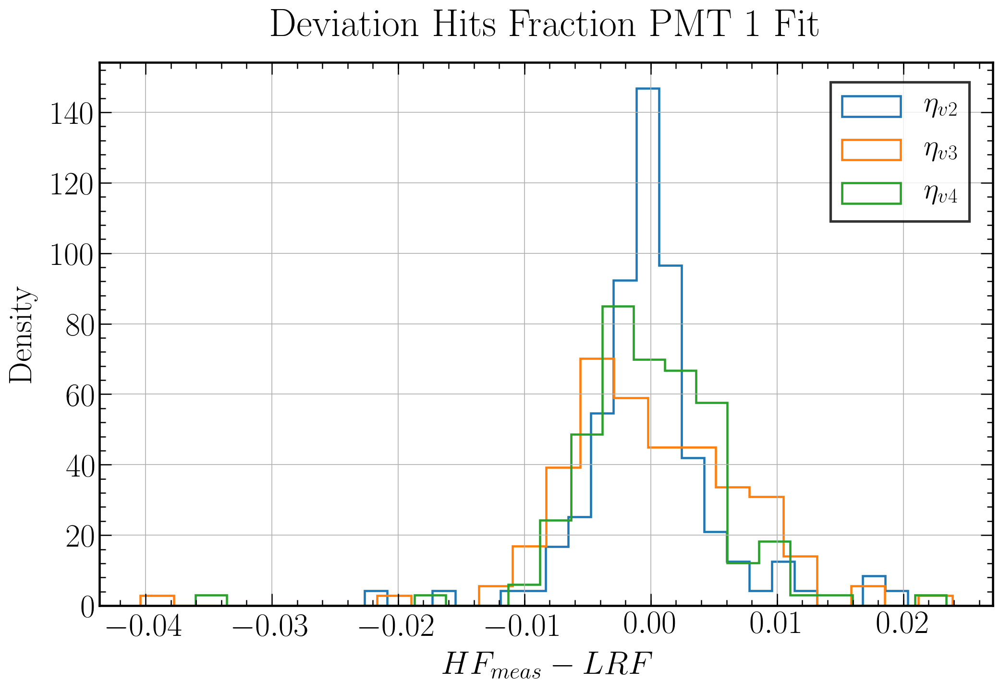

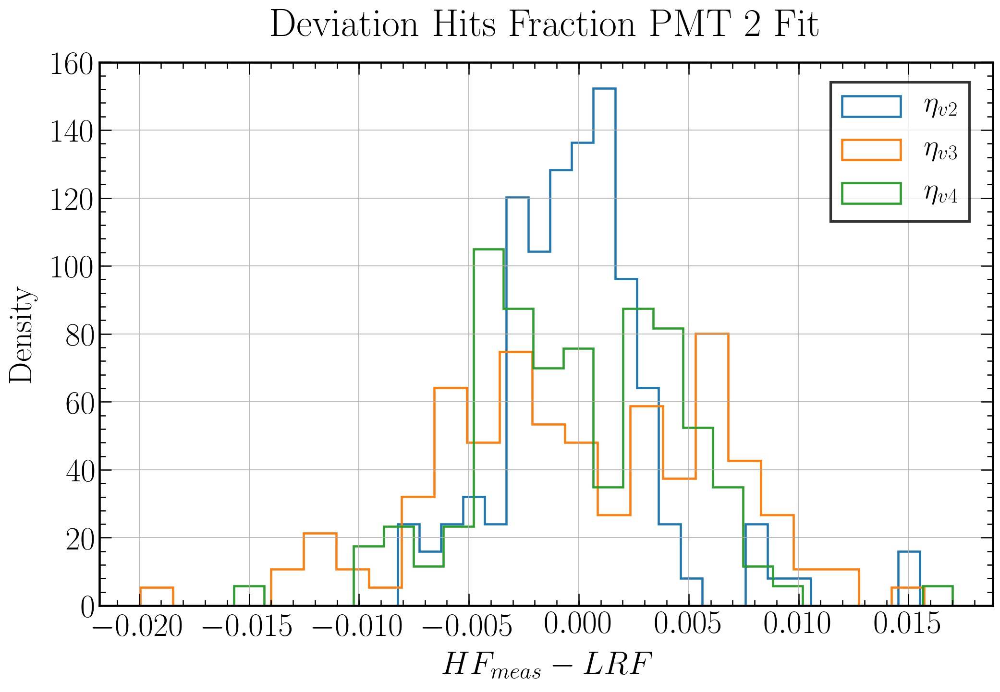

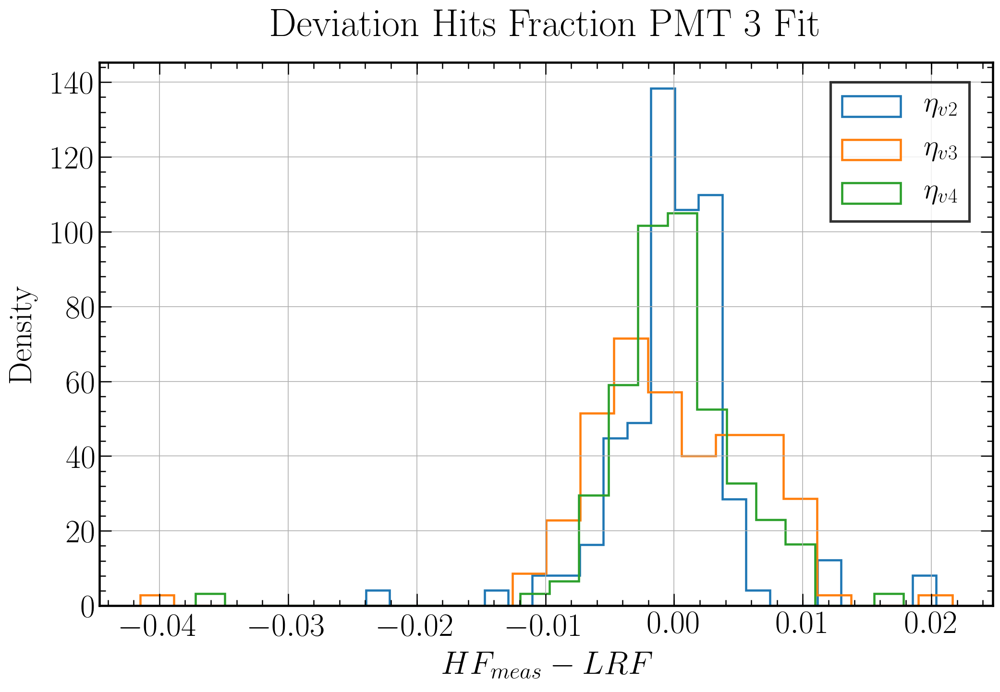

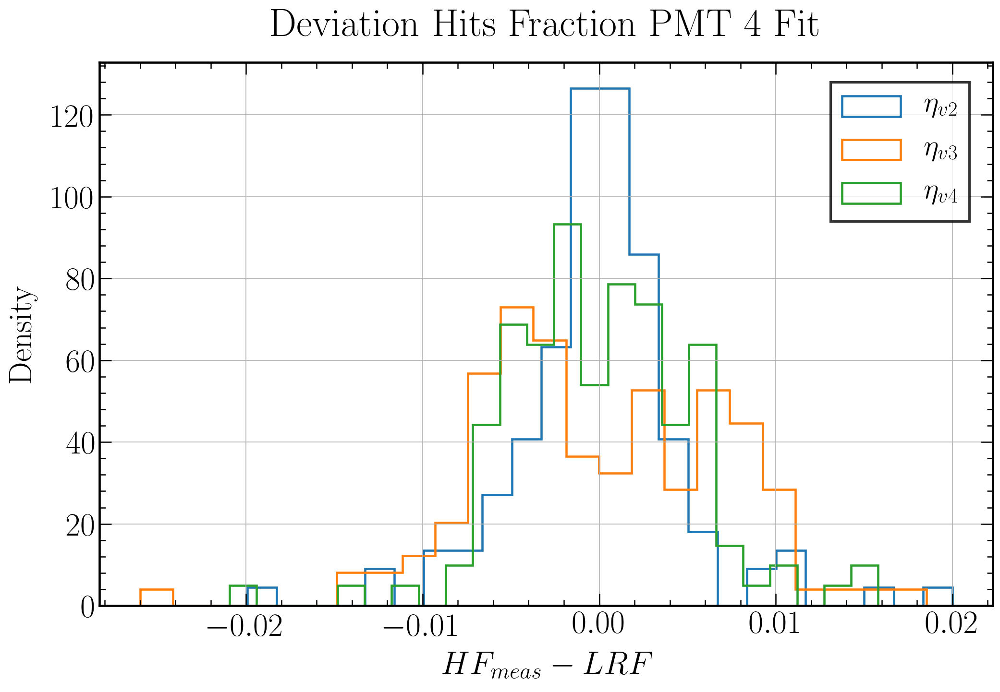

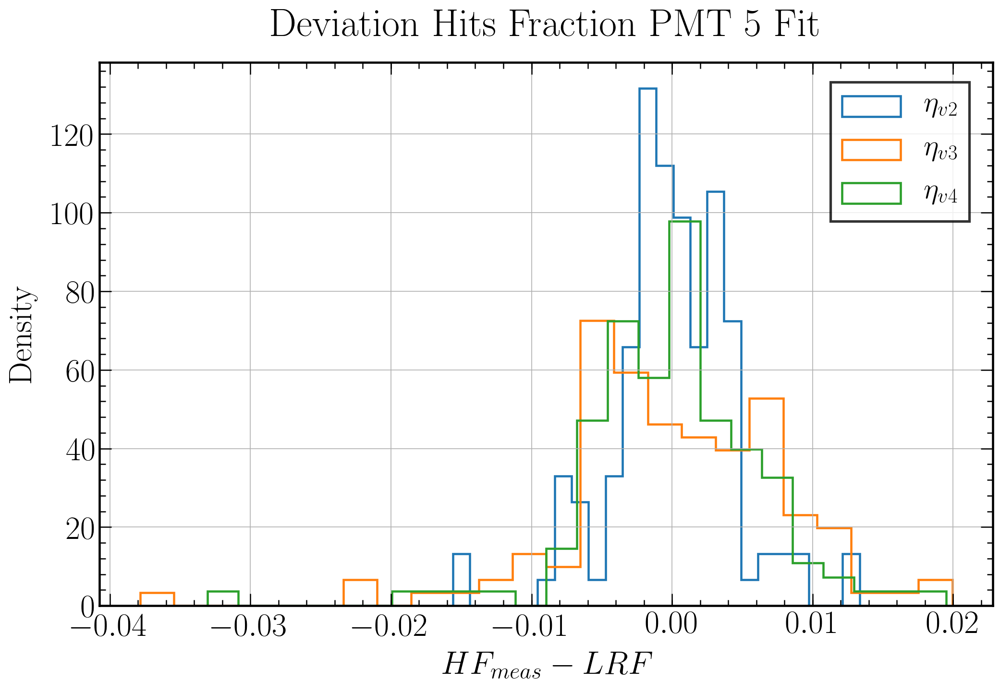

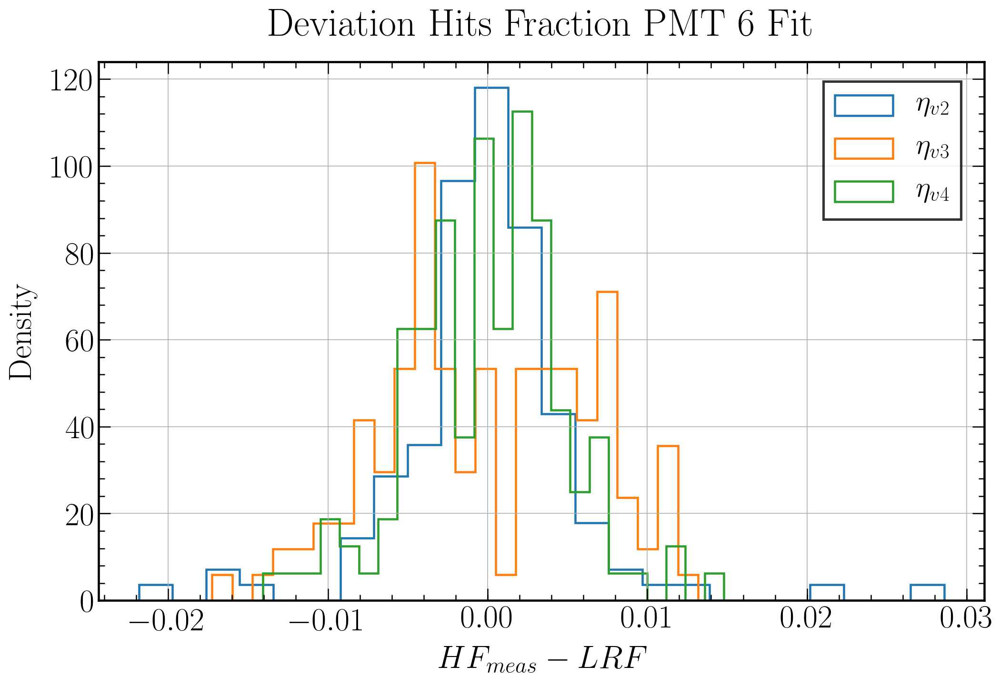

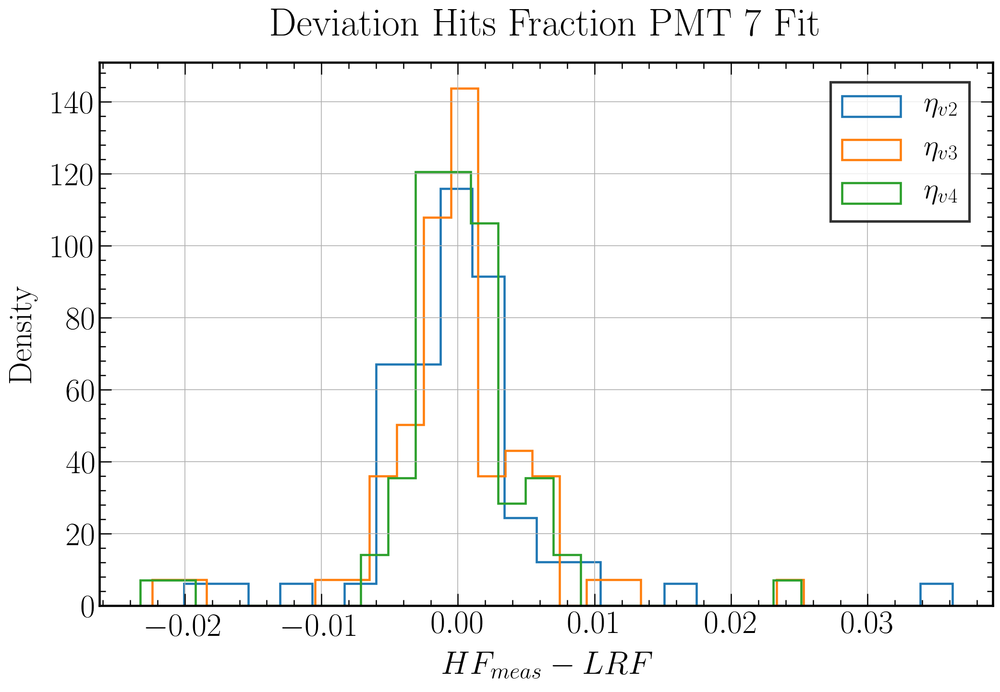

In [53]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    numberbins = 24
    '''data = HF_R_hist['n'][i] - eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1])
    plt.hist(data, numberbins, histtype = 'step', linewidth = 2.2, label = '$\eta_{v1}$', density=True)'''
    data = HF_R_hist['n'][i] - eta_v2(HF_R_hist['bins_center'][i], *fit_parameters_eta_v2[i-1])
    plt.hist(data, numberbins, histtype = 'step', linewidth = 2.2, label = '$\eta_{v2}$', density=True)
    data = HF_R_hist['n'][i] - eta_v3(HF_R_hist['bins_center'][i], *fit_parameters_eta_v3[i-1])
    plt.hist(data, numberbins, histtype = 'step', linewidth = 2.2, label = '$\eta_{v3}$', density=True)
    data = HF_R_hist['n'][i] - eta_v4(HF_R_hist['bins_center'][i], *fit_parameters_eta_v4[i-1])
    plt.hist(data, numberbins, histtype = 'step', linewidth = 2.2, label = '$\eta_{v4}$', density=True)

    plt.xlabel('$HF_{meas} - LRF$', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Density', fontsize = label_size, labelpad = label_pad)
    plt.title('Deviation Hits Fraction PMT '+str(i)+' Fit', fontsize = title_size, pad = title_pad)

    plt.grid()

    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_R_PMT"+str(i)+"_Fit_"+modelstring+"_DeviationHist.png")

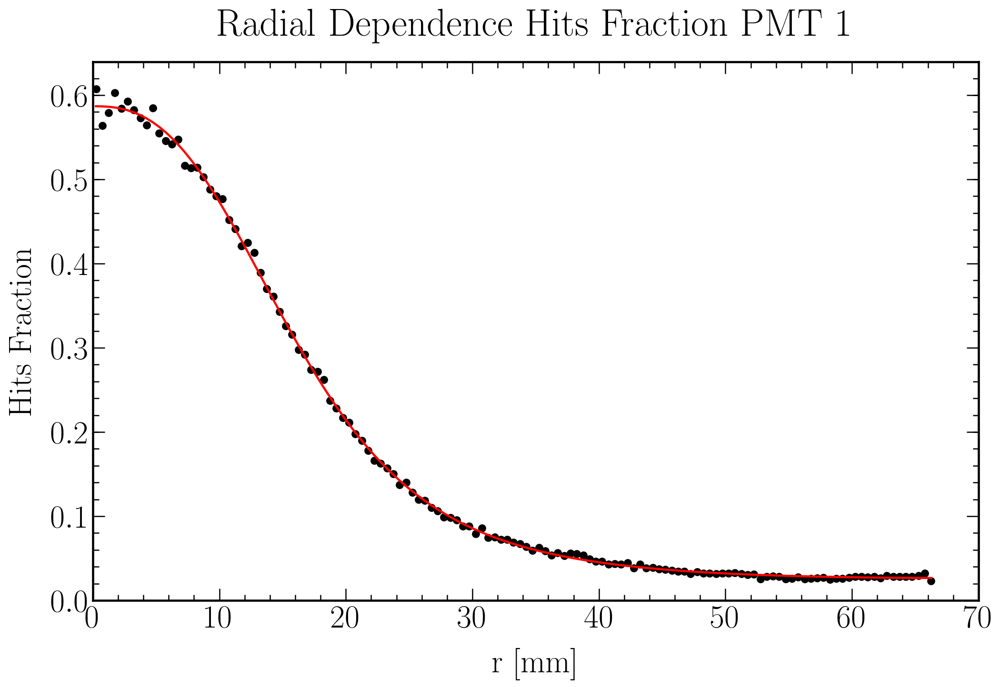

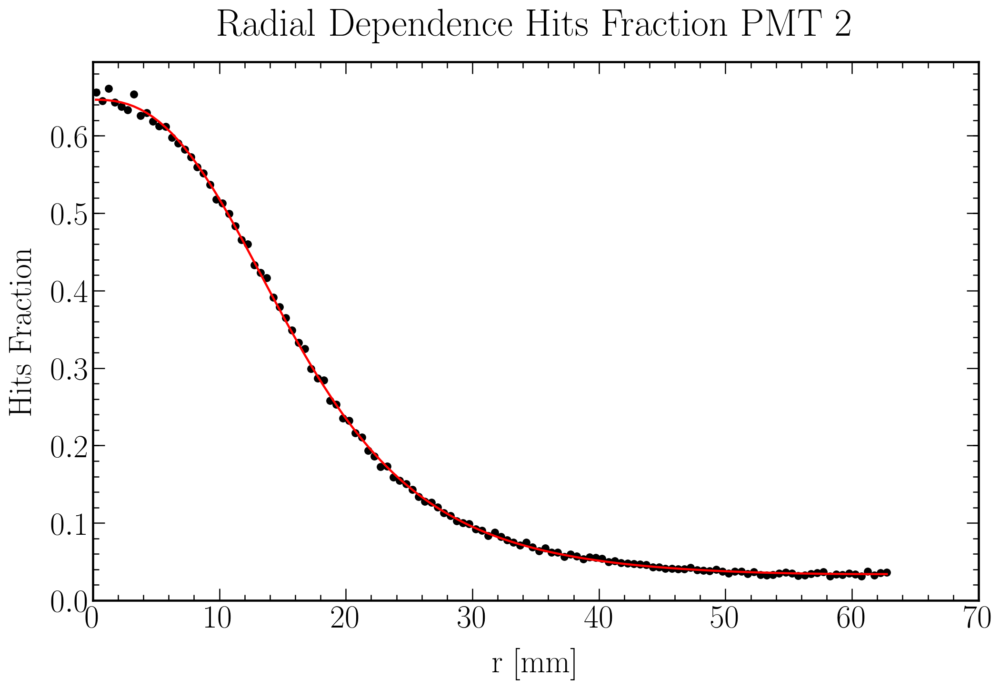

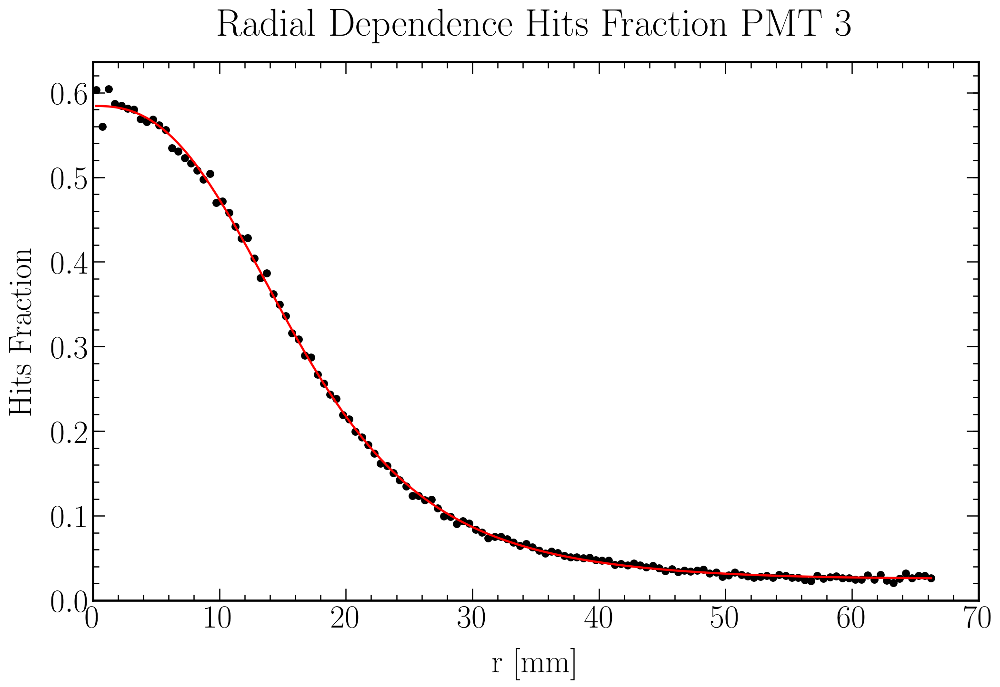

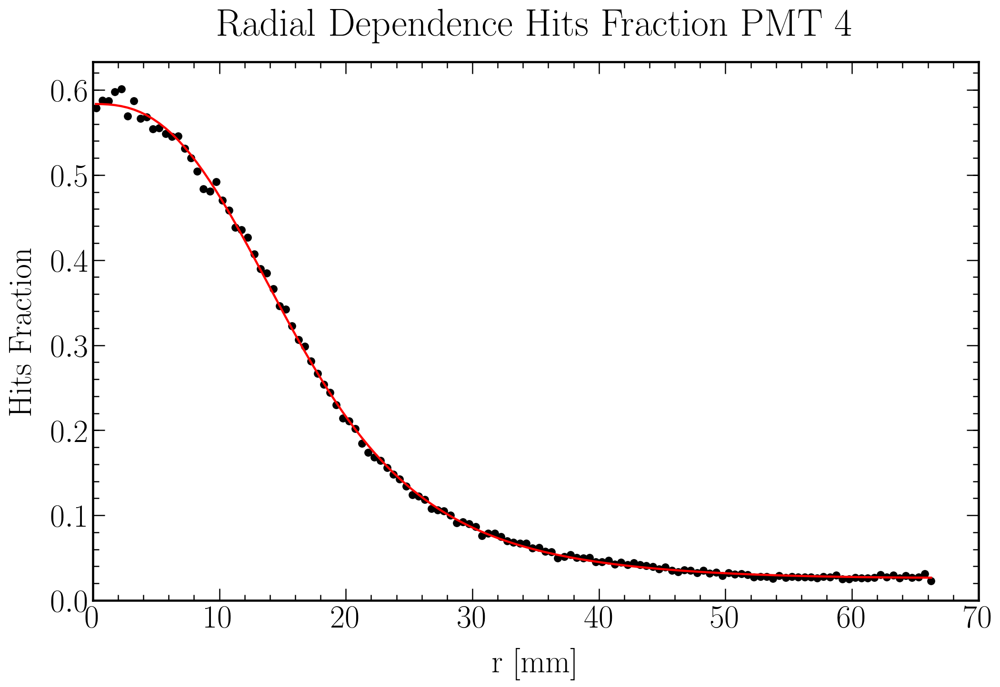

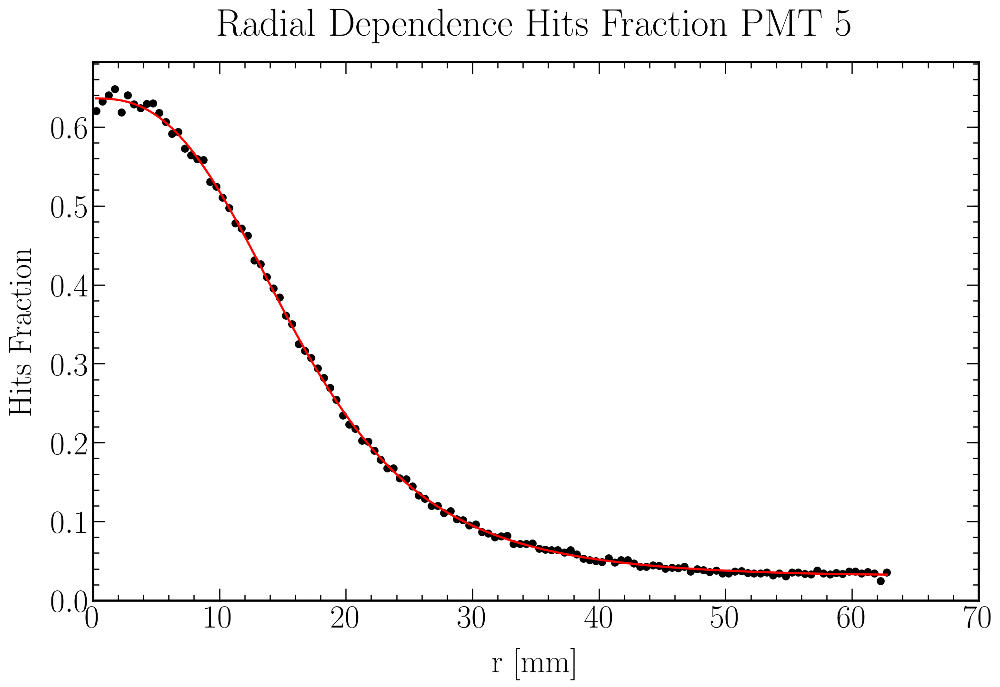

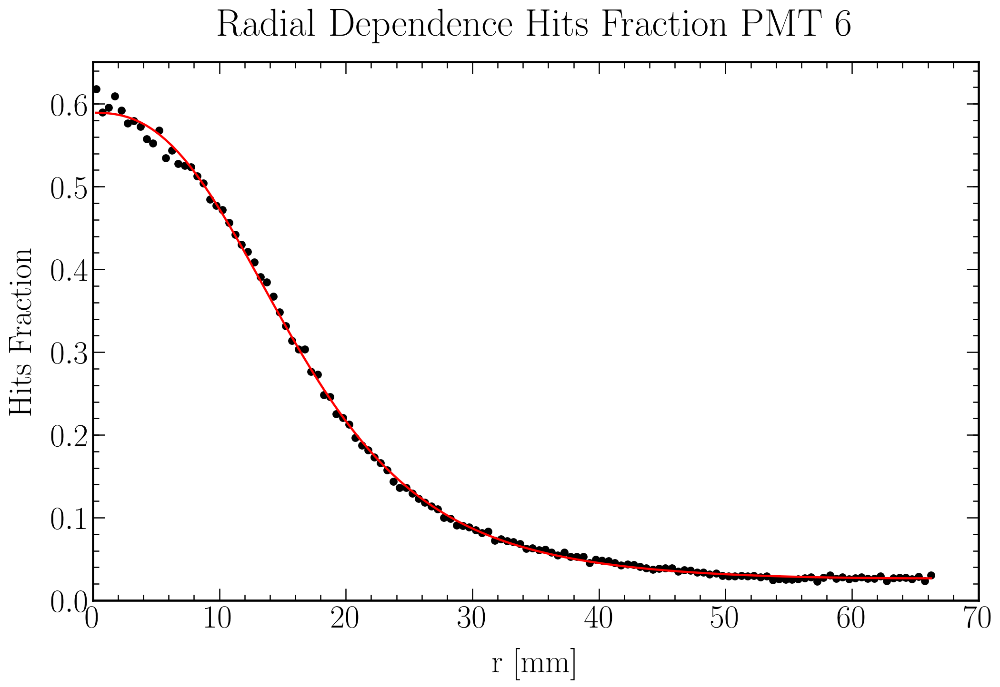

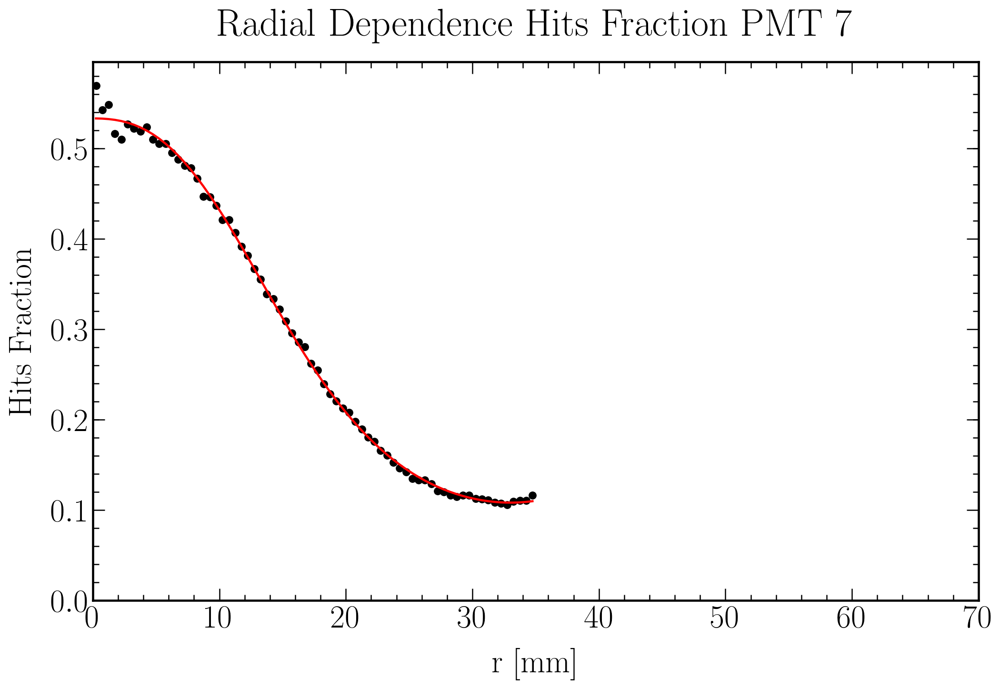

In [54]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70

    # Data plot
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], color = 'k', s = 50)
    plt.plot(HF_R_hist['bins_center'][i], model(HF_R_hist['bins_center'][i], *eval("fit_parameters_"+modelstring)[i-1]), color = 'r', linewidth = 2.2)

    plt.ylim(bottom=0)
    plt.xlim(0.,70.)

    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('Radial Dependence Hits Fraction PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_R_PMT"+str(i)+"_Fit_"+modelstring+".png")

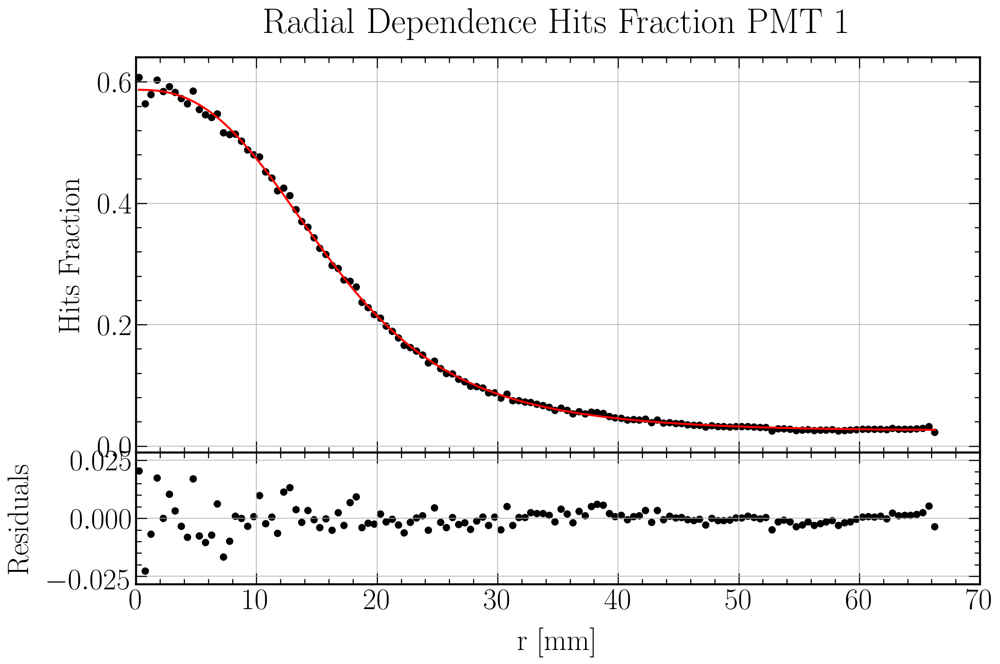

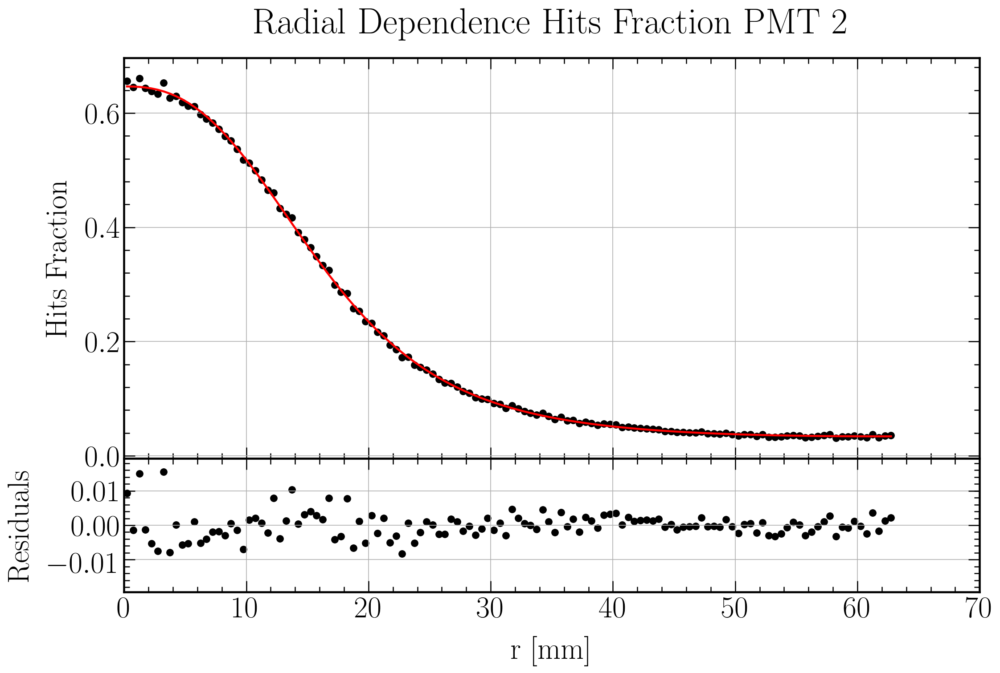

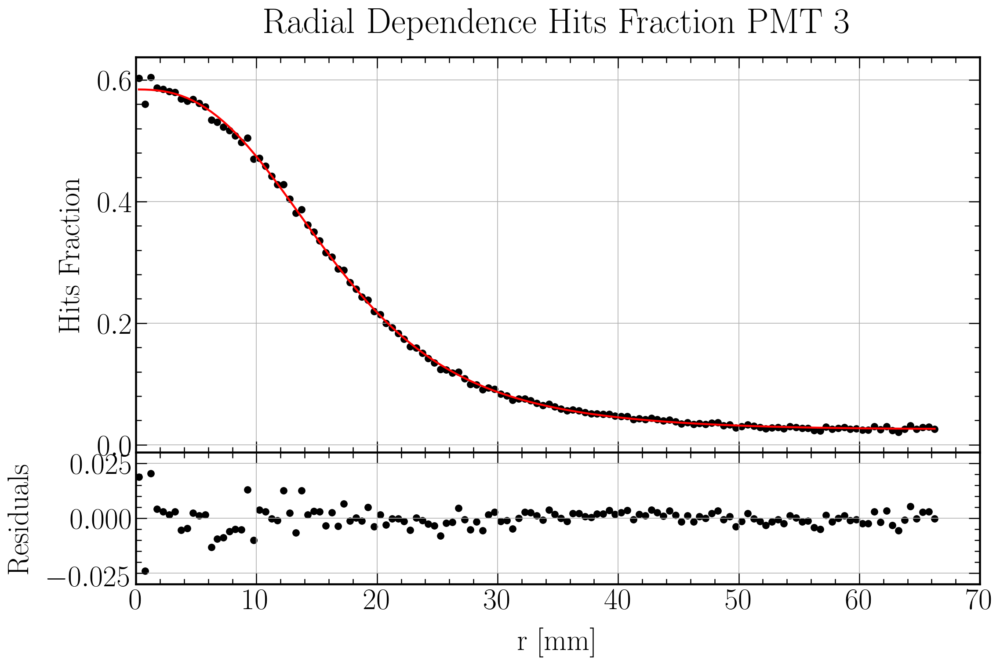

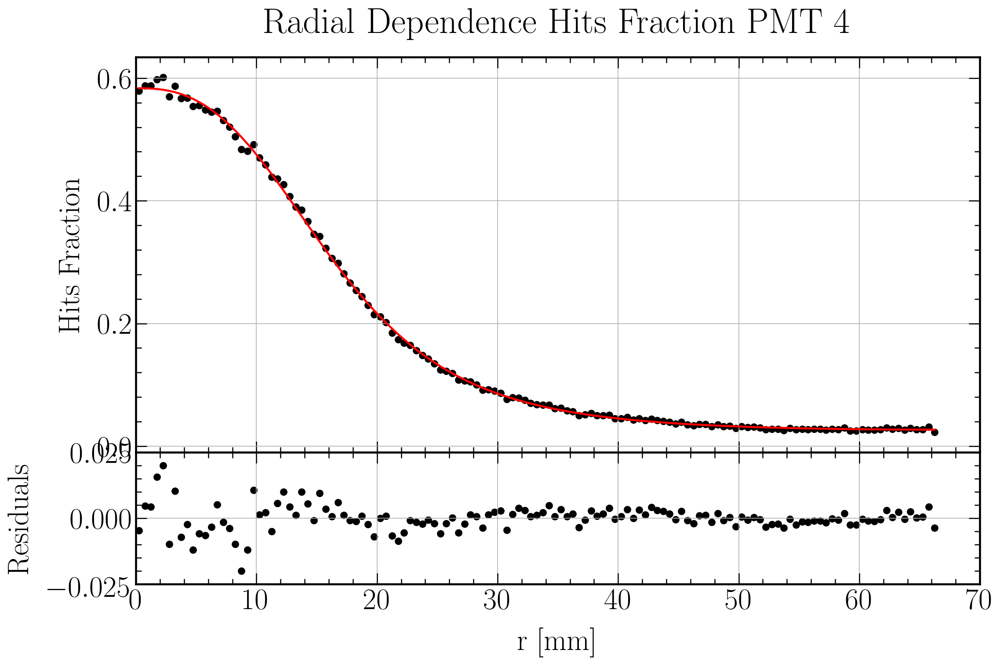

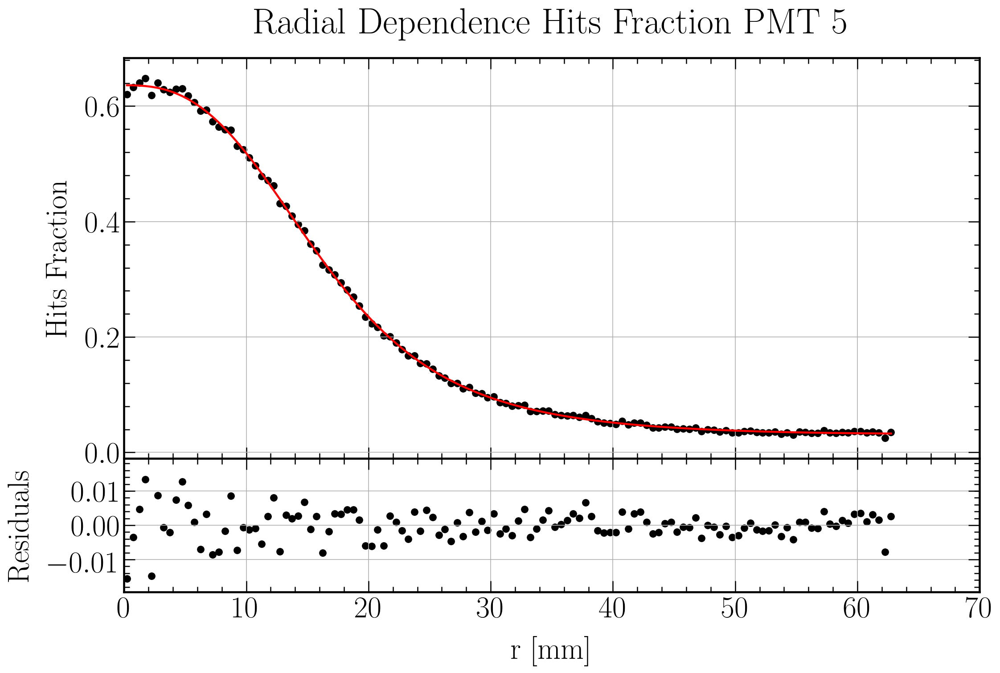

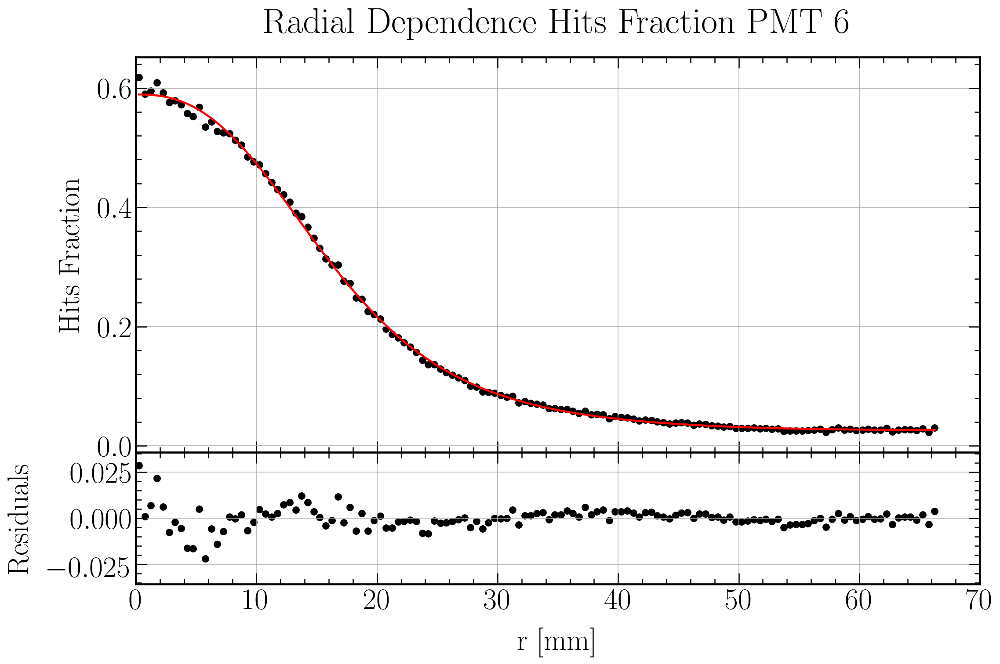

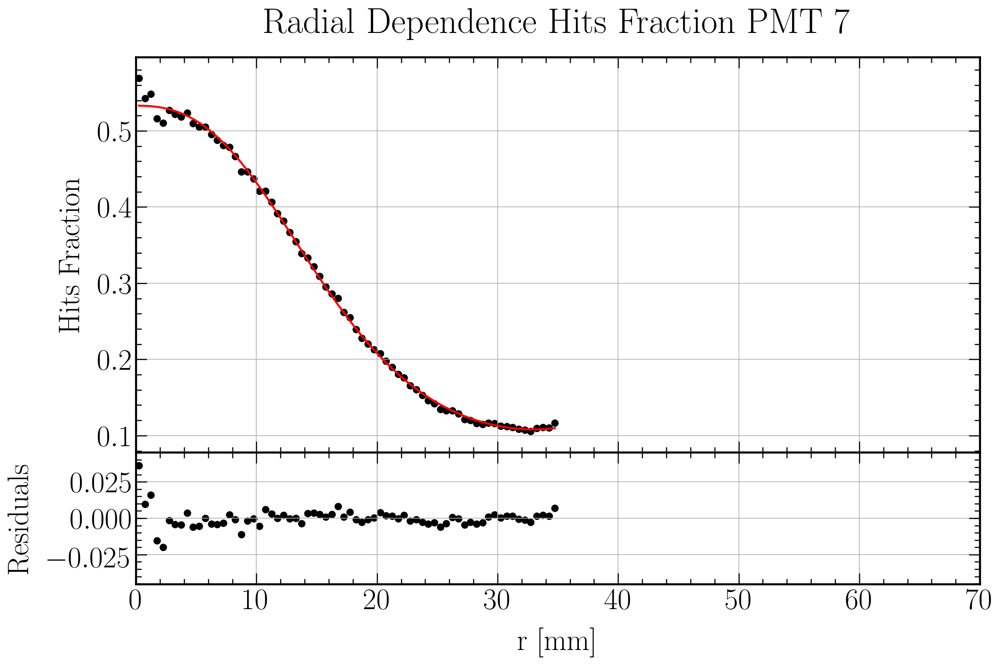

In [55]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)
    frame1=fig.add_axes((.1,.3,.8,.6))

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70

    # Data plot
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], color = 'k', s = 50)
    plt.plot(HF_R_hist['bins_center'][i], model(HF_R_hist['bins_center'][i], *eval("fit_parameters_"+modelstring)[i-1]), color = 'r', linewidth = 2.2)

    plt.xlim(0.,70.)
    frame1.set_xticklabels([])
    
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('Radial Dependence Hits Fraction PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.grid()
    #############################################
    frame2=fig.add_axes((.1,.1,.8,.2)) 
    
    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)  
    
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - model(HF_R_hist['bins_center'][i], *eval("fit_parameters_"+modelstring)[i-1]), color = 'k', s = 50)
    plt.ylabel('Residuals', fontsize = label_size, labelpad = label_pad)
       
    plt.ylim(-1.25 * max(abs(HF_R_hist['n'][i] - model(HF_R_hist['bins_center'][i], *eval("fit_parameters_"+modelstring)[i-1]))), 1.25 * max(abs(HF_R_hist['n'][i] - model(HF_R_hist['bins_center'][i], *eval("fit_parameters_"+modelstring)[i-1]))))
    plt.xlim(0.,70.)

    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)

    plt.grid()
    
    plt.show()
    
    fig.savefig(filenameprefix+"_Hits_Fraction_R_PMT"+str(i)+"_Fit_"+modelstring+"_Residuals.png", bbox_inches = "tight")

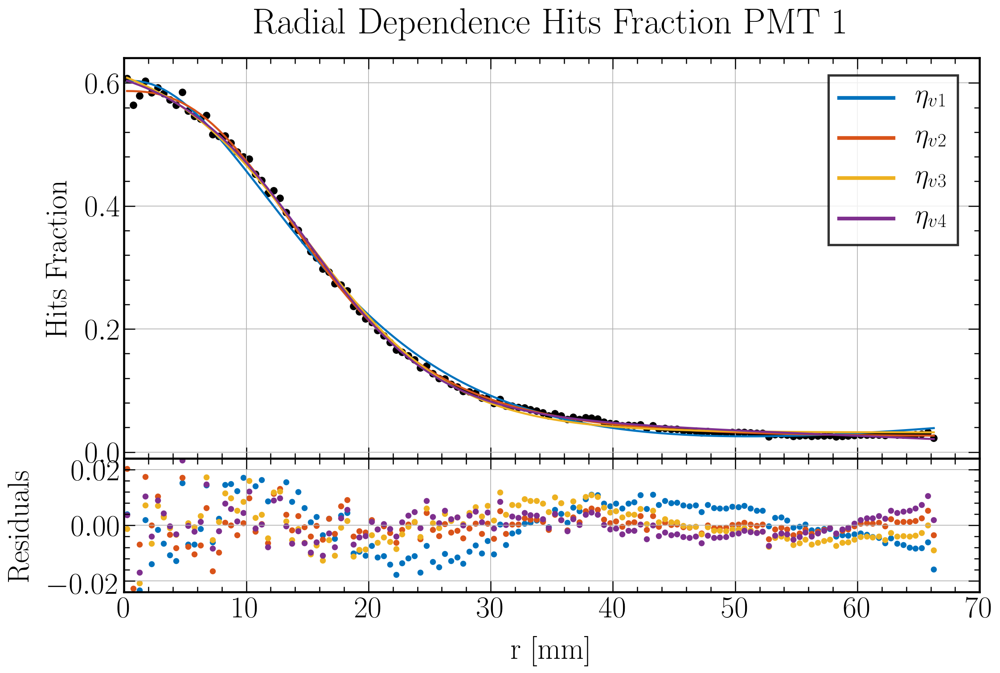

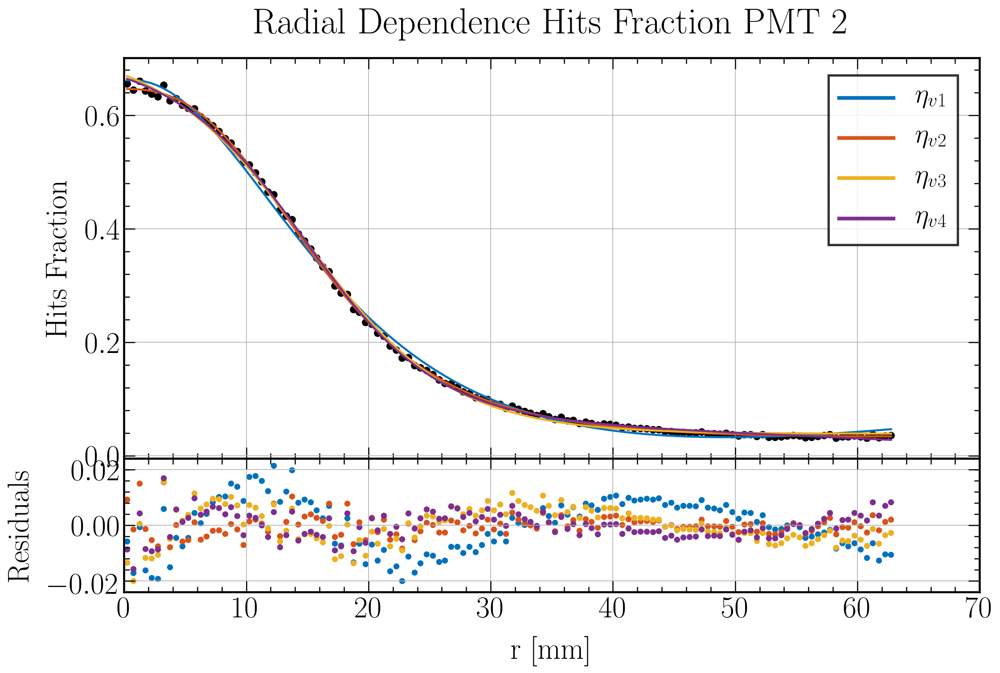

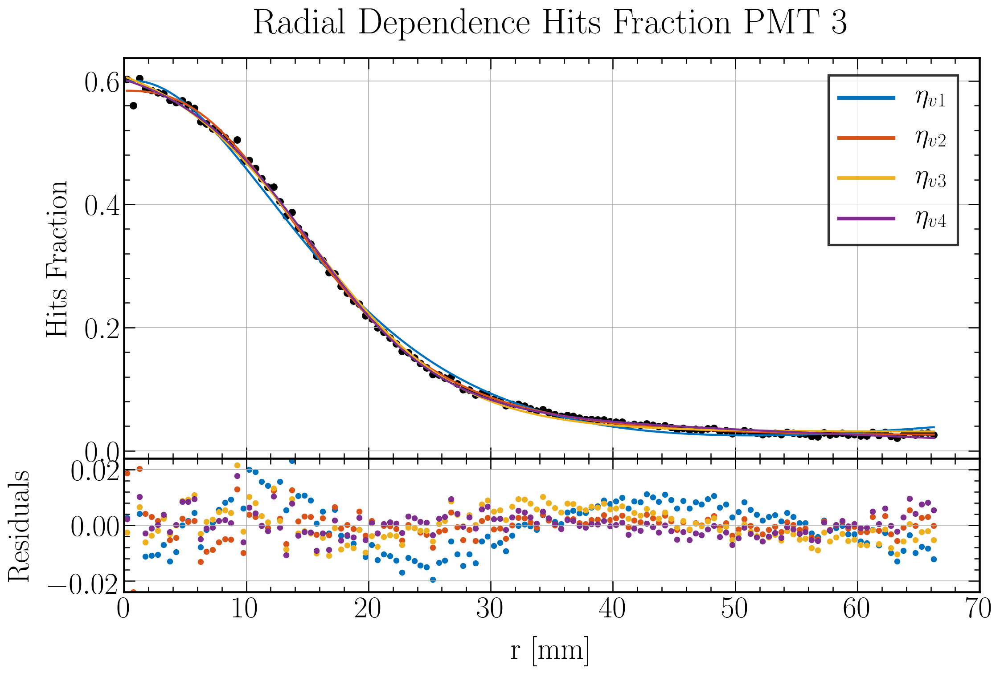

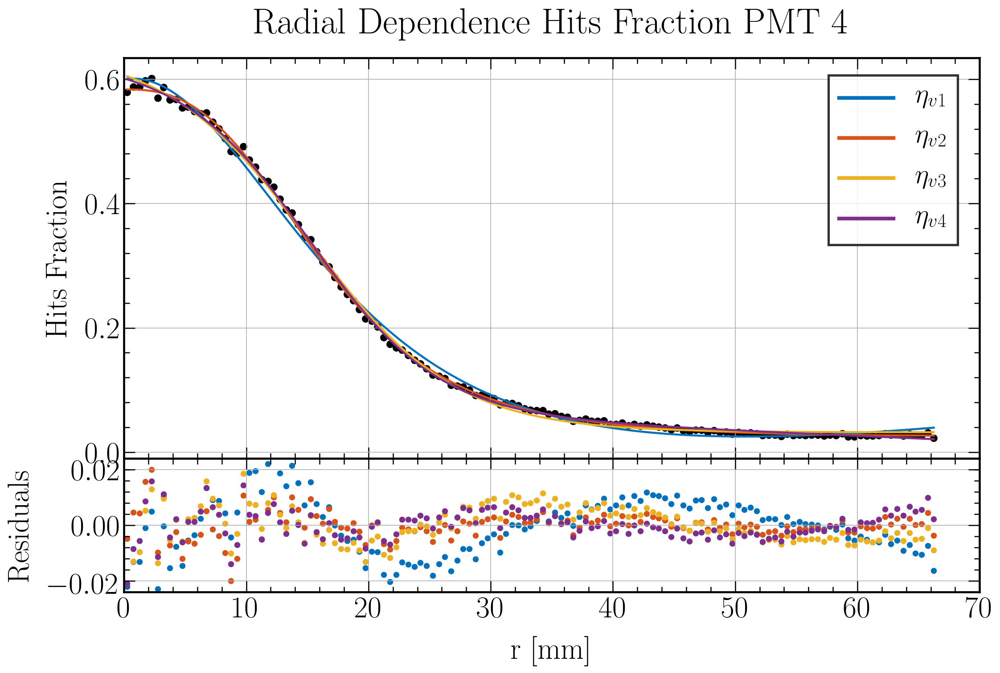

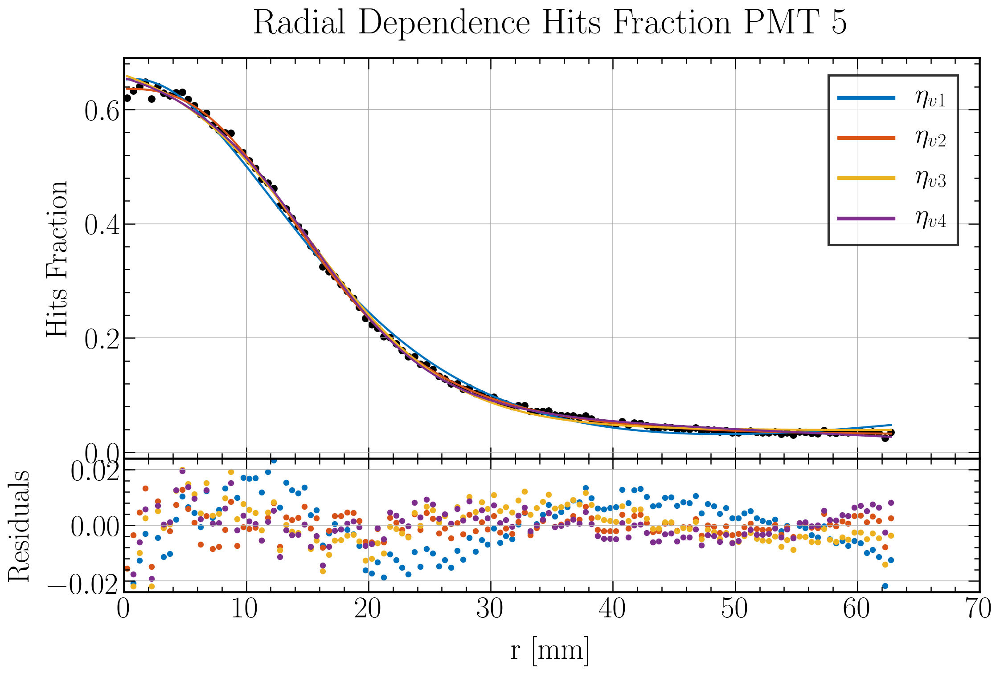

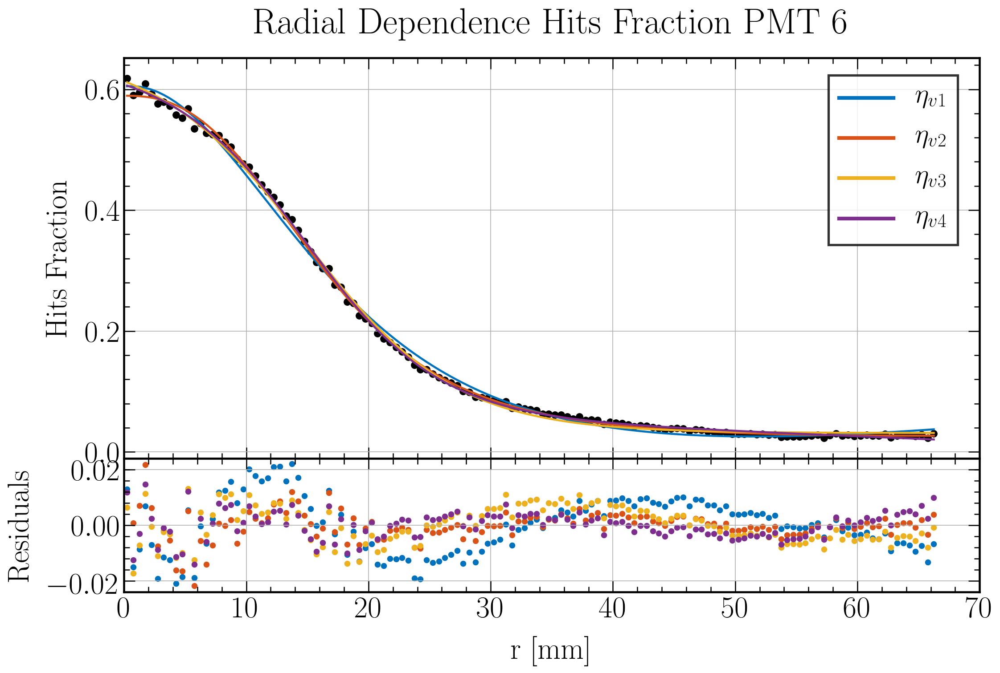

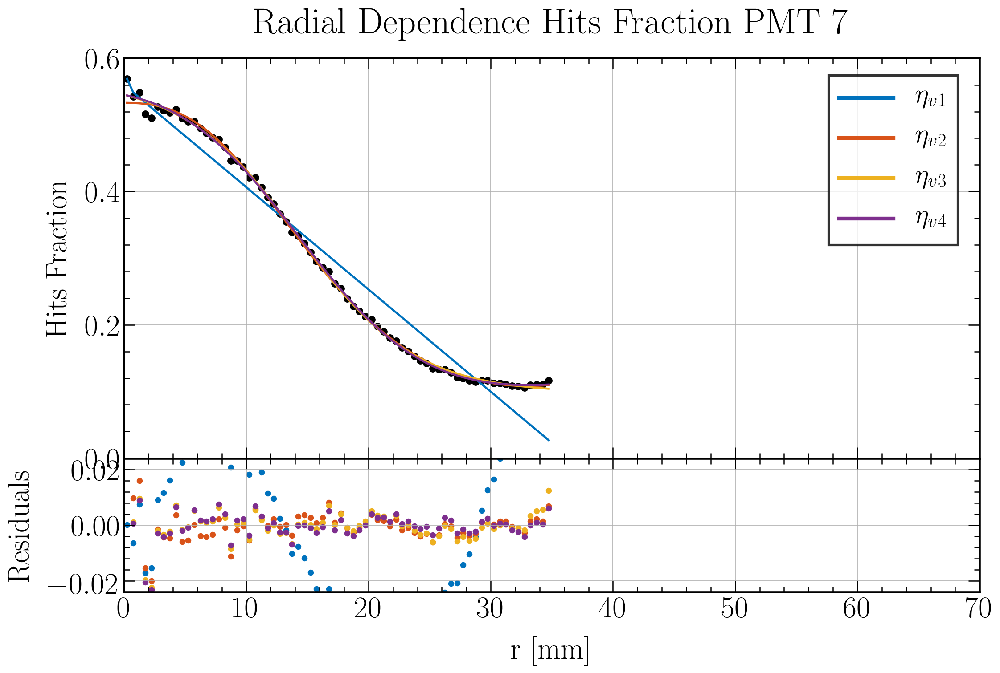

In [56]:
for i in range(1,8):
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)
    frame1=fig.add_axes((.1,.3,.8,.6))

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    numberbins = 70

    # Data plot
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i], color = 'k', s = 50)
    plt.plot(HF_R_hist['bins_center'][i], eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1]), color = [0, 0.4470, 0.7410], linewidth = 2.2, label = '$\eta_{v1}$')
    plt.plot(HF_R_hist['bins_center'][i], eta_v2(HF_R_hist['bins_center'][i], *fit_parameters_eta_v2[i-1]), color = [0.8500, 0.3250, 0.0980], linewidth = 2.2, label = '$\eta_{v2}$')
    plt.plot(HF_R_hist['bins_center'][i], eta_v3(HF_R_hist['bins_center'][i], *fit_parameters_eta_v3[i-1]), color = [0.9290, 0.6940, 0.1250], linewidth = 2.2, label = '$\eta_{v3}$')
    plt.plot(HF_R_hist['bins_center'][i], eta_v4(HF_R_hist['bins_center'][i], *fit_parameters_eta_v4[i-1]), color = [0.4940, 0.1840, 0.5560], linewidth = 2.2, label = '$\eta_{v4}$')

    plt.xlim(0.,70.)
    frame1.set_xticklabels([])
    
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('Radial Dependence Hits Fraction PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.grid()
    
    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)
    
    #############################################
    frame2=fig.add_axes((.1,.1,.8,.2)) 
    
    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)  
    
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1]), s = 30, color = [0, 0.4470, 0.7410], label = '$\eta_{v1}$')
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v2(HF_R_hist['bins_center'][i], *fit_parameters_eta_v2[i-1]), s = 30, color = [0.8500, 0.3250, 0.0980], label = '$\eta_{v2}$')
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v3(HF_R_hist['bins_center'][i], *fit_parameters_eta_v3[i-1]), s = 30, color = [0.9290, 0.6940, 0.1250], label = '$\eta_{v3}$')
    plt.scatter(HF_R_hist['bins_center'][i], HF_R_hist['n'][i] - eta_v4(HF_R_hist['bins_center'][i], *fit_parameters_eta_v4[i-1]), s = 30, color = [0.4940, 0.1840, 0.5560], label = '$\eta_{v4}$')
    plt.ylabel('Residuals', fontsize = label_size, labelpad = label_pad)
       
    #plt.ylim(-1.25 * max(abs(HF_R_hist['n'][i] - eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1]))), 1.25 * max(abs(HF_R_hist['n'][i] - eta_v1(HF_R_hist['bins_center'][i], *fit_parameters_eta_v1[i-1]))))
    plt.ylim(-0.024,0.024)
    plt.xlim(0.,70.)

    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)

    plt.grid()
    
    plt.show()
    
    fig.savefig(filenameprefix+"_Hits_Fraction_R_PMT"+str(i)+"_Fits_Residuals.png", bbox_inches = "tight")

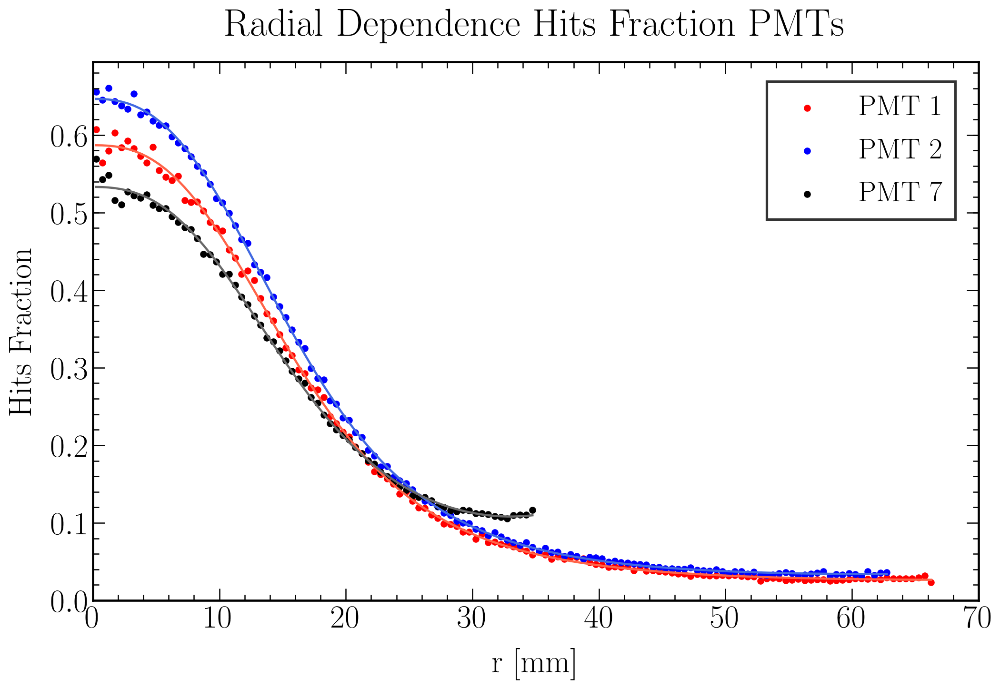

In [57]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
plt.scatter(HF_R_hist['bins_center'][1], HF_R_hist['n'][1], color = 'r', label = "PMT 1")
plt.scatter(HF_R_hist['bins_center'][2], HF_R_hist['n'][2], color = 'b', label = "PMT 2")
plt.scatter(HF_R_hist['bins_center'][7], HF_R_hist['n'][7], color = 'k', label = "PMT 7")

plt.plot(HF_R_hist['bins_center'][1], model(HF_R_hist['bins_center'][1], *eval("fit_parameters_"+modelstring)[1-1]), color = 'tomato', linewidth = 2.2)
plt.plot(HF_R_hist['bins_center'][2], model(HF_R_hist['bins_center'][2], *eval("fit_parameters_"+modelstring)[2-1]), color = 'royalblue', linewidth = 2.2)
plt.plot(HF_R_hist['bins_center'][7], model(HF_R_hist['bins_center'][7], *eval("fit_parameters_"+modelstring)[7-1]), color = 'dimgrey', linewidth = 2.2)

plt.ylim(bottom=0)
plt.xlim(0.,70.)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
plt.title('Radial Dependence Hits Fraction PMTs', fontsize = title_size, pad = title_pad)

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_Hits_Fraction_R_PMTs_Fit_"+str(modelstring)+".png")

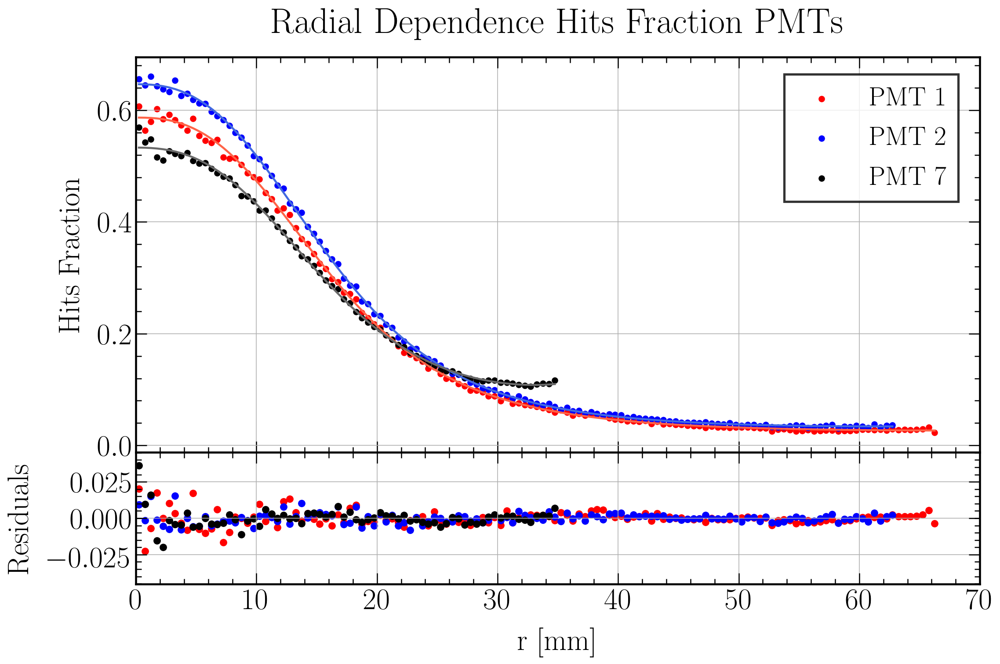

In [58]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)
frame1=fig.add_axes((.1,.3,.8,.6))

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
plt.scatter(HF_R_hist['bins_center'][1], HF_R_hist['n'][1], color = 'r', label = "PMT 1")
plt.scatter(HF_R_hist['bins_center'][2], HF_R_hist['n'][2], color = 'b', label = "PMT 2")
plt.scatter(HF_R_hist['bins_center'][7], HF_R_hist['n'][7], color = 'k', label = "PMT 7")

plt.plot(HF_R_hist['bins_center'][1], model(HF_R_hist['bins_center'][1], *eval("fit_parameters_"+modelstring)[1-1]), color = 'tomato', linewidth = 2.2)
plt.plot(HF_R_hist['bins_center'][2], model(HF_R_hist['bins_center'][2], *eval("fit_parameters_"+modelstring)[2-1]), color = 'royalblue', linewidth = 2.2)
plt.plot(HF_R_hist['bins_center'][7], model(HF_R_hist['bins_center'][7], *eval("fit_parameters_"+modelstring)[7-1]), color = 'dimgrey', linewidth = 2.2)

plt.xlim(0.,70.)
frame1.set_xticklabels([])

plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
plt.title('Radial Dependence Hits Fraction PMTs', fontsize = title_size, pad = title_pad)

plt.grid()

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

#############################################
frame2=fig.add_axes((.1,.1,.8,.2)) 

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)  

plt.scatter(HF_R_hist['bins_center'][1], HF_R_hist['n'][1] - model(HF_R_hist['bins_center'][1], *eval("fit_parameters_"+modelstring)[1-1]), color = 'r', s = 50)
plt.scatter(HF_R_hist['bins_center'][2], HF_R_hist['n'][2] - model(HF_R_hist['bins_center'][2], *eval("fit_parameters_"+modelstring)[2-1]), color = 'b', s = 50)
plt.scatter(HF_R_hist['bins_center'][7], HF_R_hist['n'][7] - model(HF_R_hist['bins_center'][7], *eval("fit_parameters_"+modelstring)[7-1]), color = 'k', s = 50)
plt.ylabel('Residuals', fontsize = label_size, labelpad = label_pad)

limit = max(max(abs(HF_R_hist['n'][1] - model(HF_R_hist['bins_center'][1], *eval("fit_parameters_"+modelstring)[1-1]))), max(abs(HF_R_hist['n'][2] - model(HF_R_hist['bins_center'][2], *eval("fit_parameters_"+modelstring)[2-1]))), max(abs(HF_R_hist['n'][7] - model(HF_R_hist['bins_center'][7], *eval("fit_parameters_"+modelstring)[7-1]))))
plt.ylim(-1.25 * limit, 1.25 * limit)
plt.xlim(0.,70.)

plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)

plt.grid()

plt.show()

fig.savefig(filenameprefix+"_Hits_Fraction_R_PMTs_Fit_"+modelstring+"_Residuals.png", bbox_inches = "tight")

In [59]:
#filenameprefix = "optPhot_S2_3e7"
#HF_x_y_hist2d_perPMT = pd.read_pickle("output/"+filenameprefix+"_HF_x_y_hist2d_perPMT.pkl")

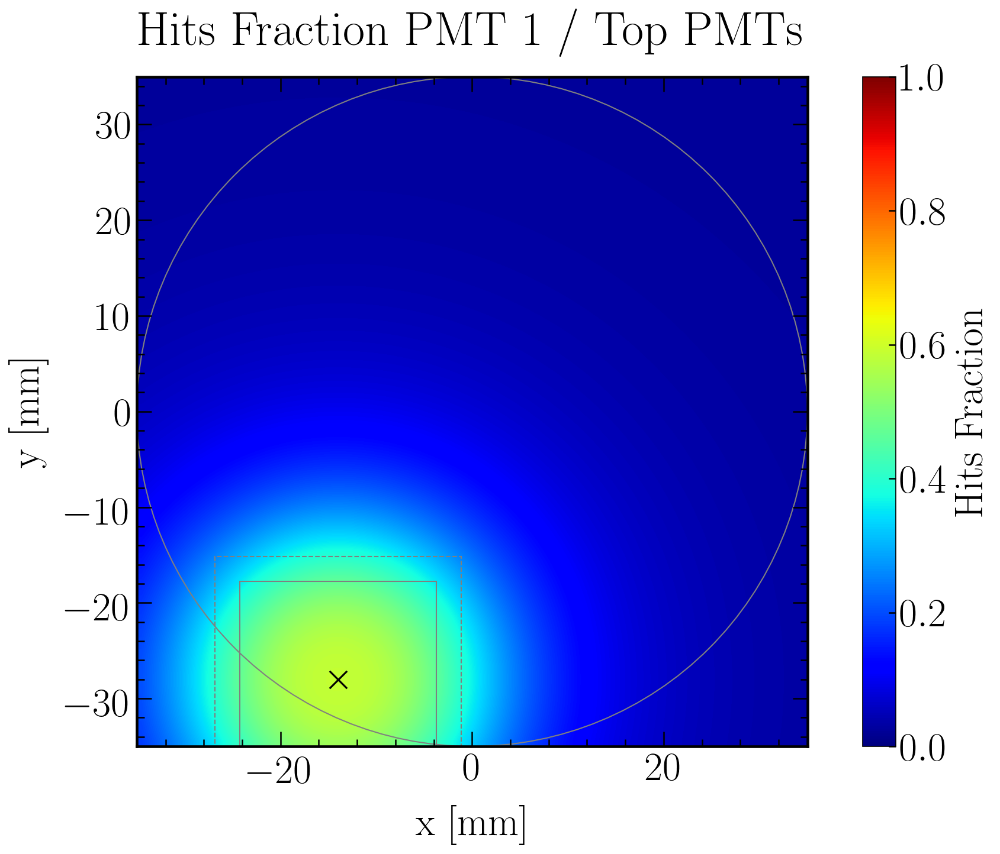

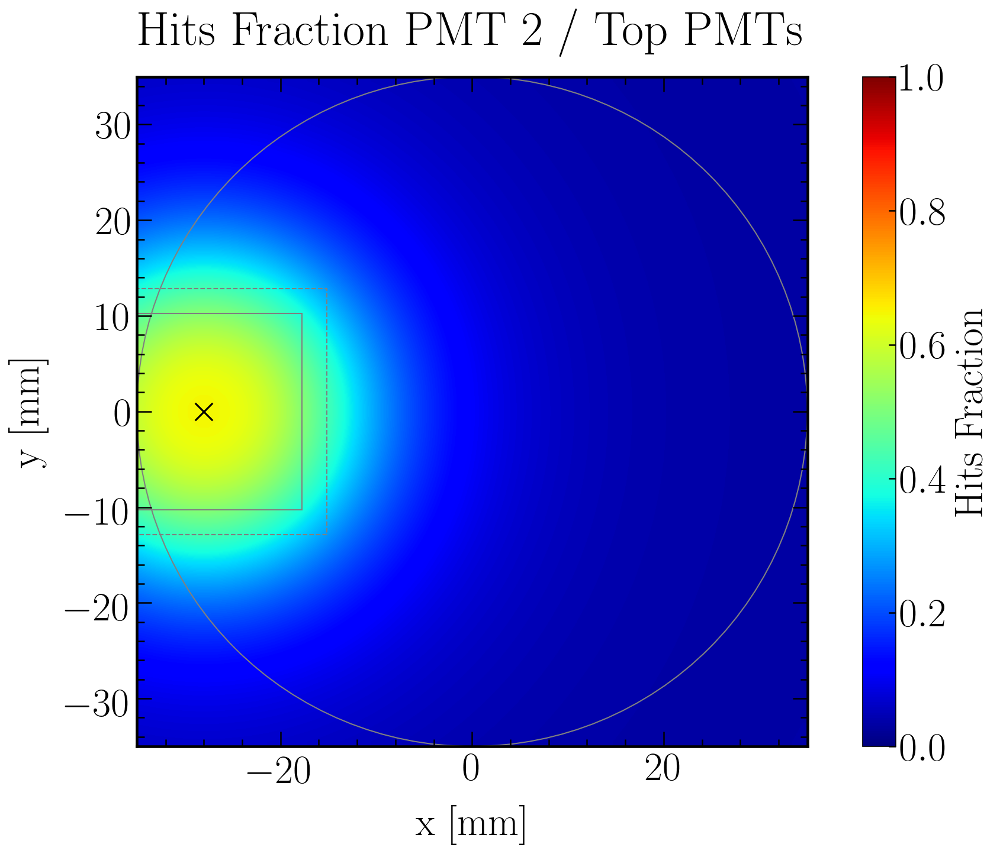

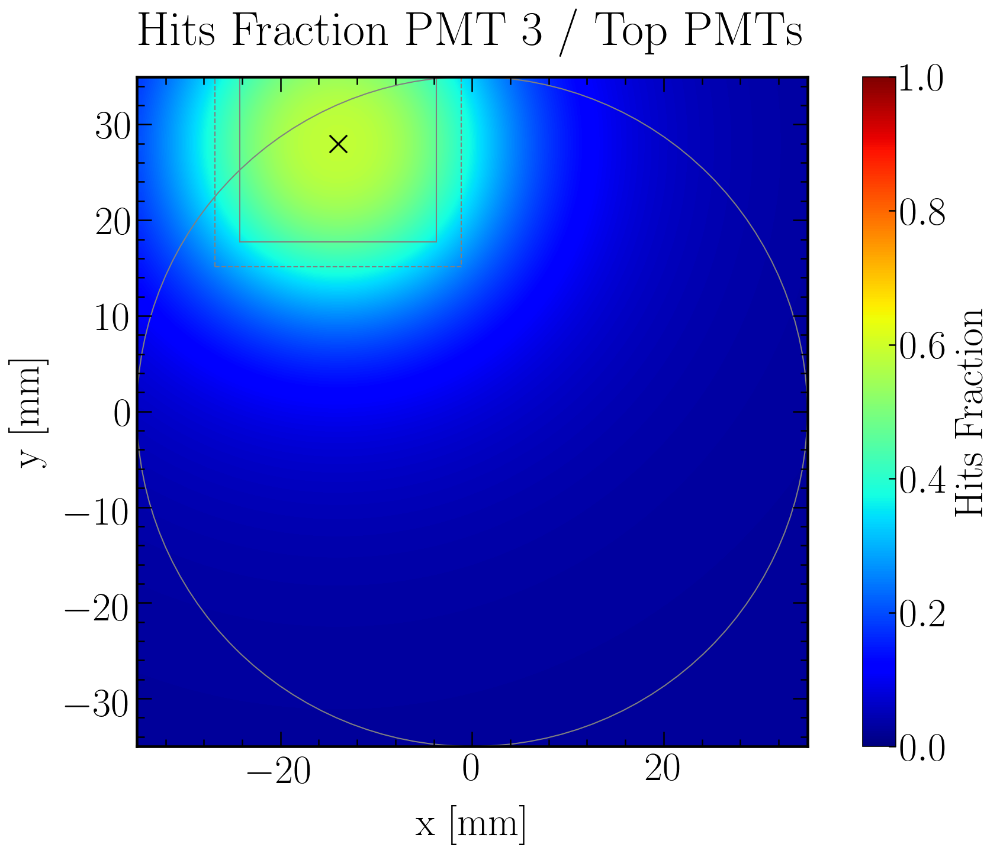

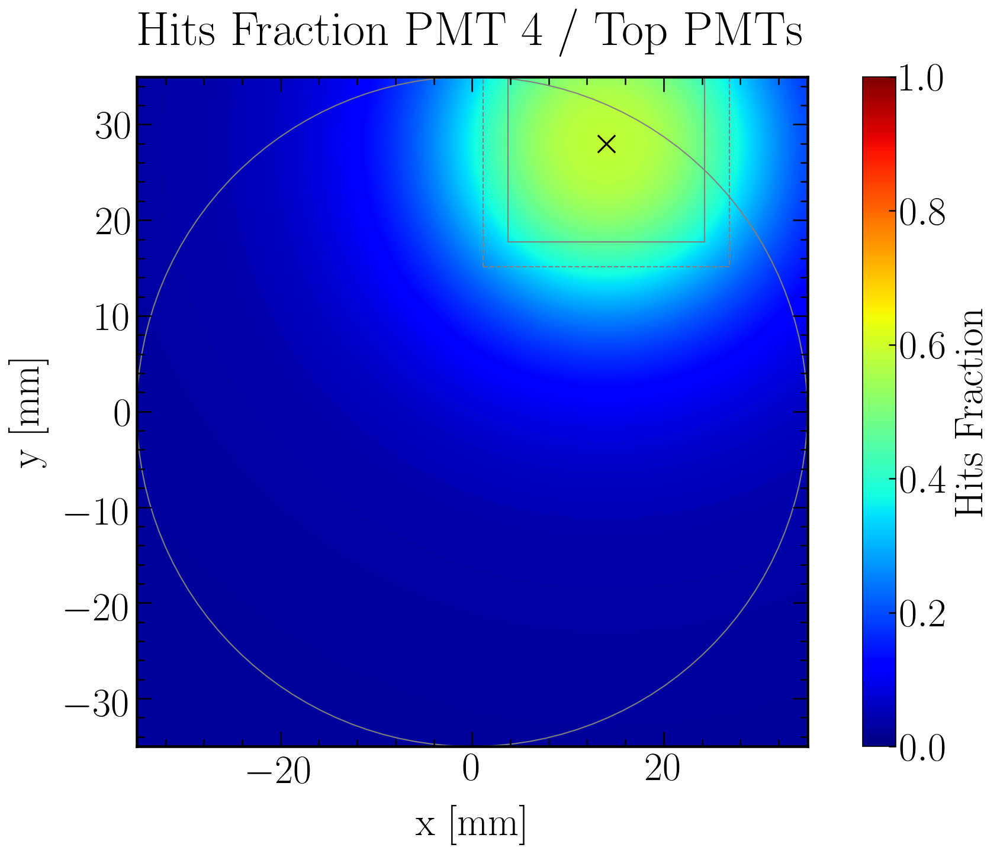

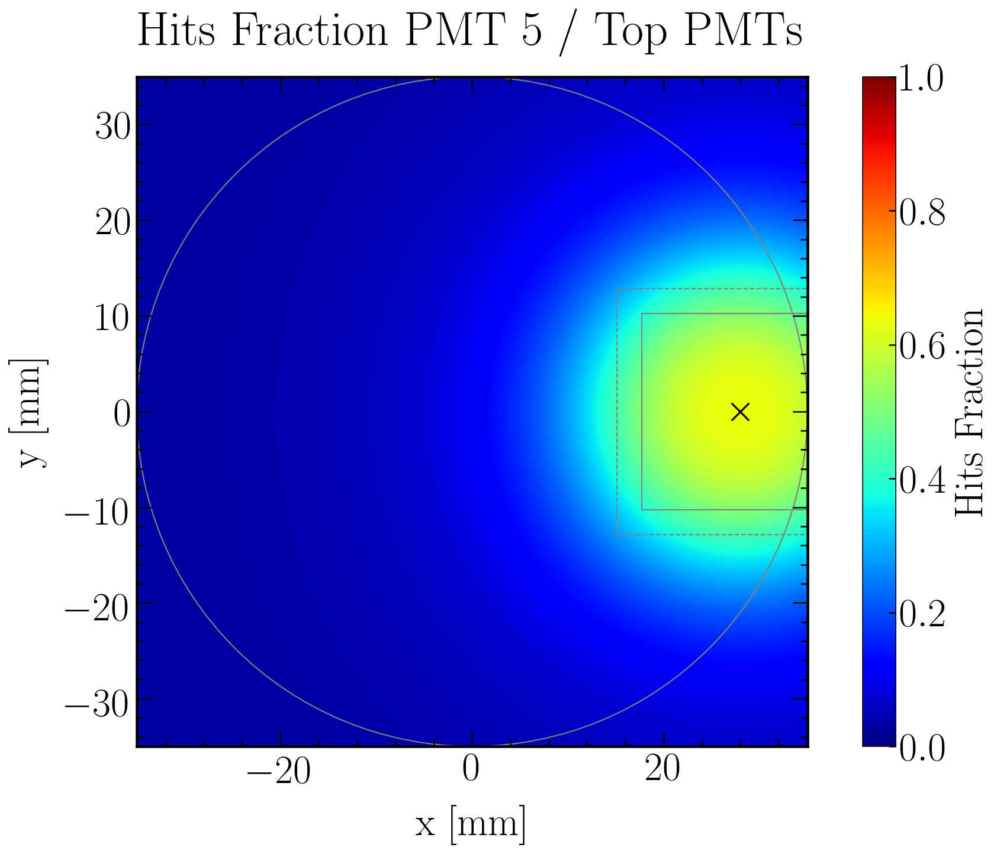

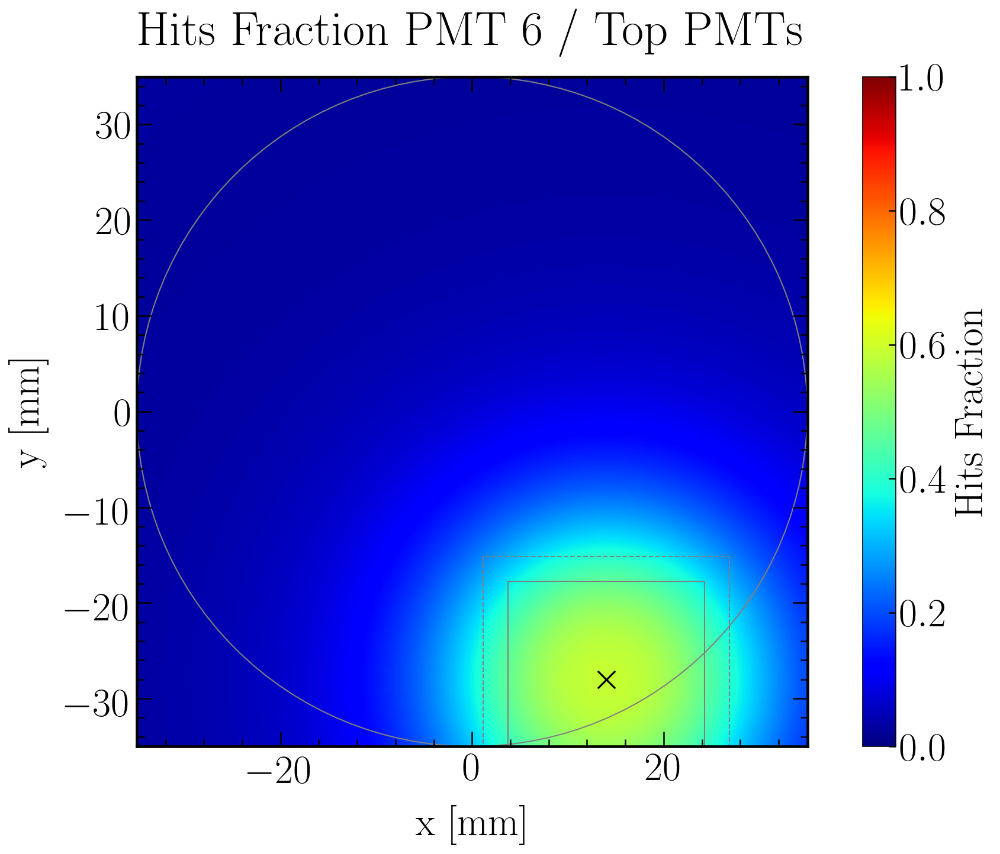

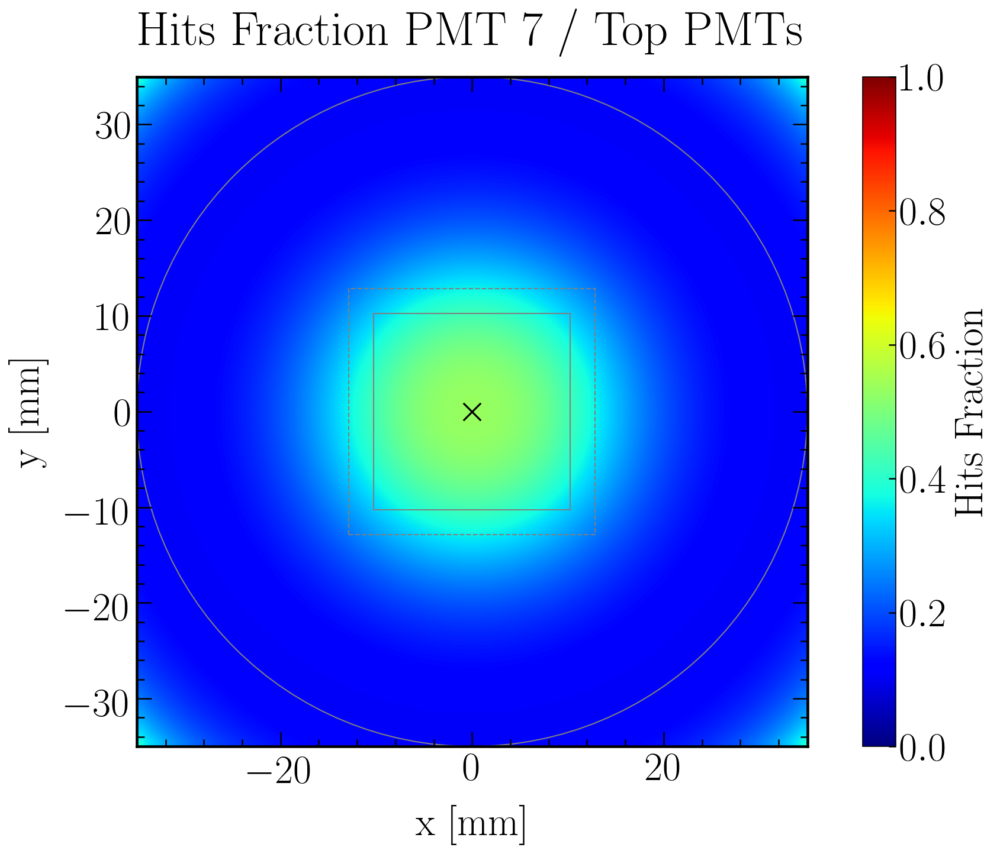

In [60]:
for i in range(1,8):

    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    def z_func(x,y):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1])

    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid

    im = plt.imshow(Z, origin='low', extent=[HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
    im.set_interpolation('bilinear')    
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Hits Fraction PMT '+str(i)+' / Top PMTs', fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(0.0, 1.0)

    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs_"+modelstring+".png")

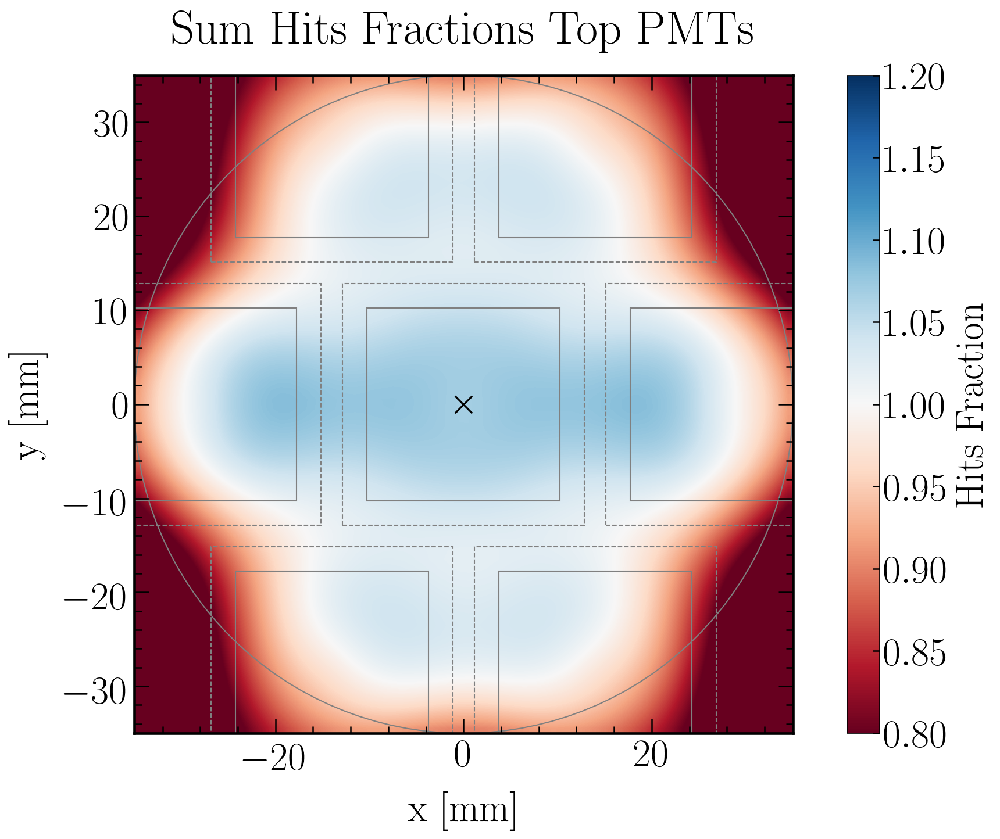

In [61]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
def z_func(x,y):
    return model(np.sqrt((x - PMT_positions['PMT_position_x'][1])**2 + (y - PMT_positions['PMT_position_y'][1])**2), *eval("fit_parameters_"+modelstring)[1-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][2])**2 + (y - PMT_positions['PMT_position_y'][2])**2), *eval("fit_parameters_"+modelstring)[2-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][3])**2 + (y - PMT_positions['PMT_position_y'][3])**2), *eval("fit_parameters_"+modelstring)[3-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][4])**2 + (y - PMT_positions['PMT_position_y'][4])**2), *eval("fit_parameters_"+modelstring)[4-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][5])**2 + (y - PMT_positions['PMT_position_y'][5])**2), *eval("fit_parameters_"+modelstring)[5-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][6])**2 + (y - PMT_positions['PMT_position_y'][6])**2), *eval("fit_parameters_"+modelstring)[6-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][7])**2 + (y - PMT_positions['PMT_position_y'][7])**2), *eval("fit_parameters_"+modelstring)[7-1])

x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
X, Y = meshgrid(x, y) # grid of point
Z = z_func(X, Y) # evaluation of the function on the grid

im = plt.imshow(Z, origin='low', extent=[HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = cm.RdBu)
im.set_interpolation('bilinear')    
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('Sum Hits Fractions Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='Hits Fraction', fontsize=label_size)
plt.clim(0.8, 1.2)

plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.show()
fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMTs_of_TopPMTs_"+modelstring+".png")

In [62]:
# Calculate HF map from LRF analogous to hist2D from "real" values

HF_x_y_LRF_perPMT = pd.DataFrame({'X' : [], 'Y' : [], 'Z' : []})
columns = ['X', 'Y', 'Z']

for i in range(1,8):
    def z_func(x,y):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1])
    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid
    HF_x_y_LRF_perPMT = HF_x_y_LRF_perPMT.append({'X': X, 'Y' : Y, 'Z' : Z}, ignore_index=True)

HF_x_y_LRF_perPMT = HF_x_y_LRF_perPMT.set_index(PMT_ID)
HF_x_y_LRF_perPMT.to_pickle(filenameprefix+"_HF_x_y_LRF_perPMT_"+modelstring+".pkl")

# sum of PMTs
HF_x_y_LRF_perPMT_Z_sum = HF_x_y_LRF_perPMT['Z'].sum()

HF_x_y_LRF_perPMT

,X,Y,Z
1,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.18528171209824265, 0.20310851201629637, 0...."
2,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.06650303343639051, 0.06720807501995672, 0...."
3,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.026365116005910634, 0.026383259010354612, ..."
4,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.02746775763743833, 0.027380520265551784, 0..."
5,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.03253049270211637, 0.03248107688051587, 0...."
6,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.032505632644194406, 0.033386697096248266, ..."
7,"[[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -2...","[[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -3...","[[0.37615512646551647, 0.3380441058817997, 0.3..."


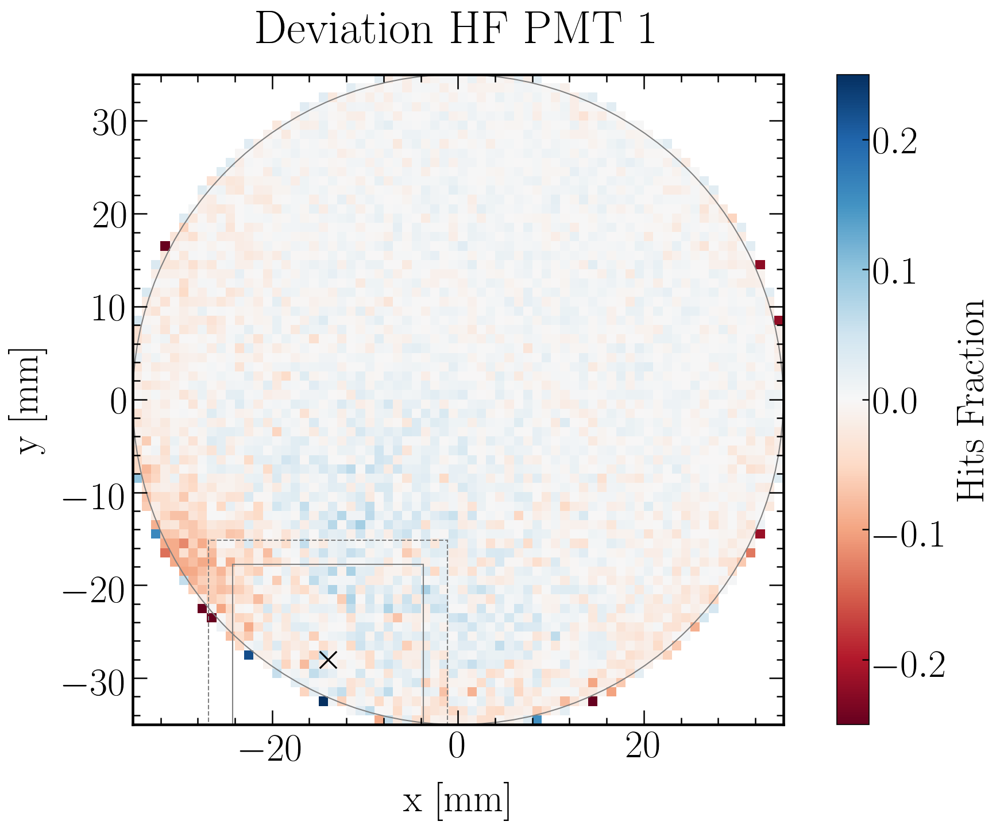

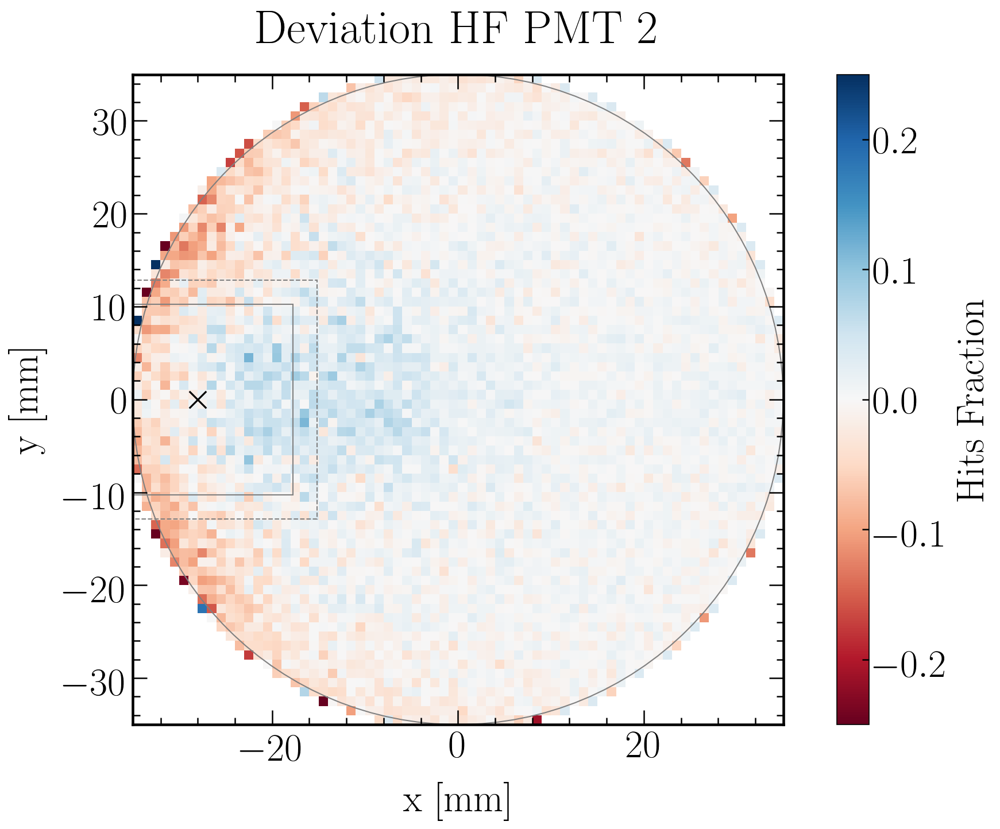

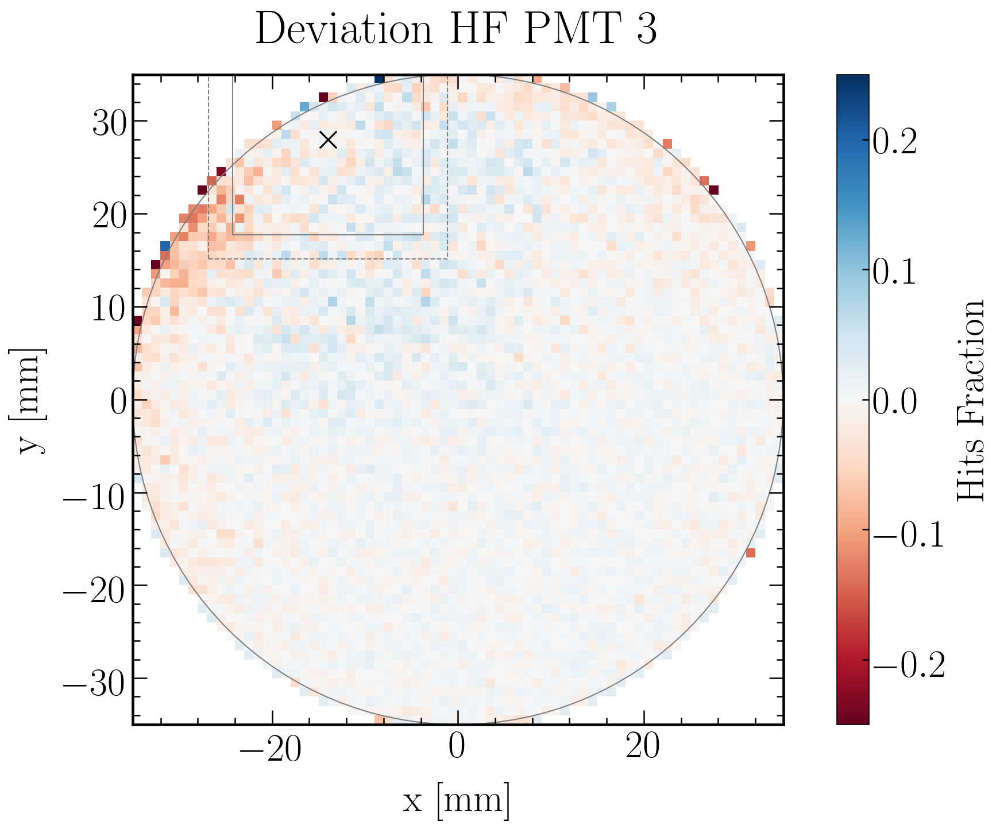

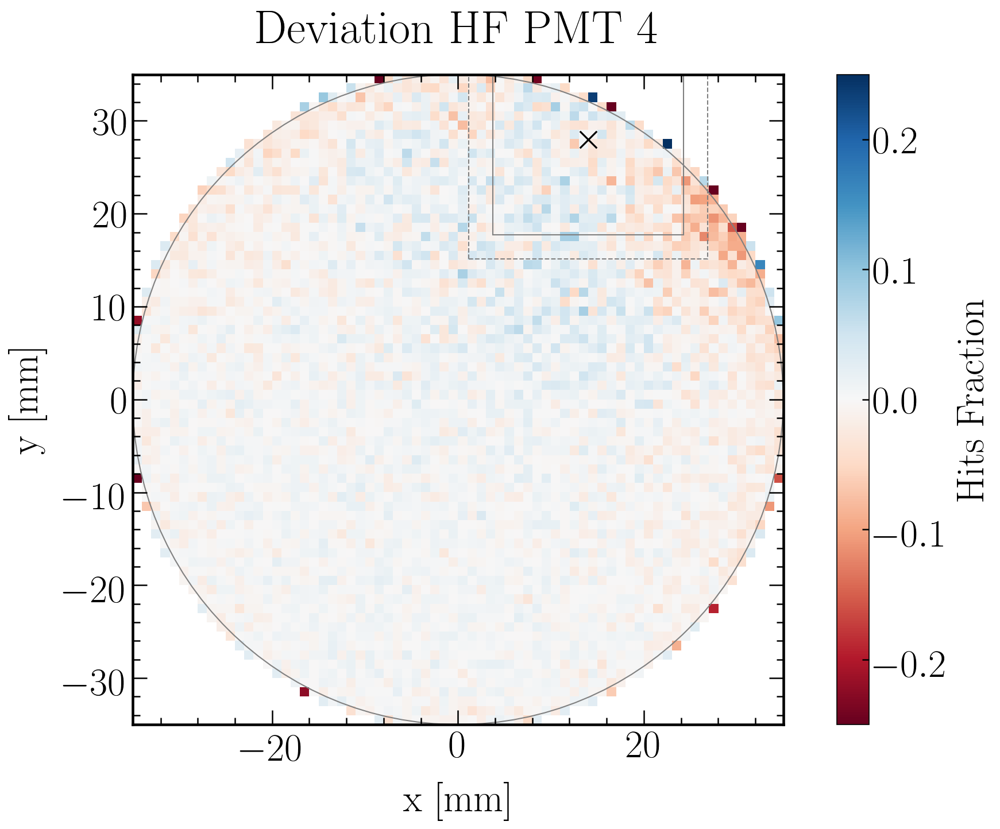

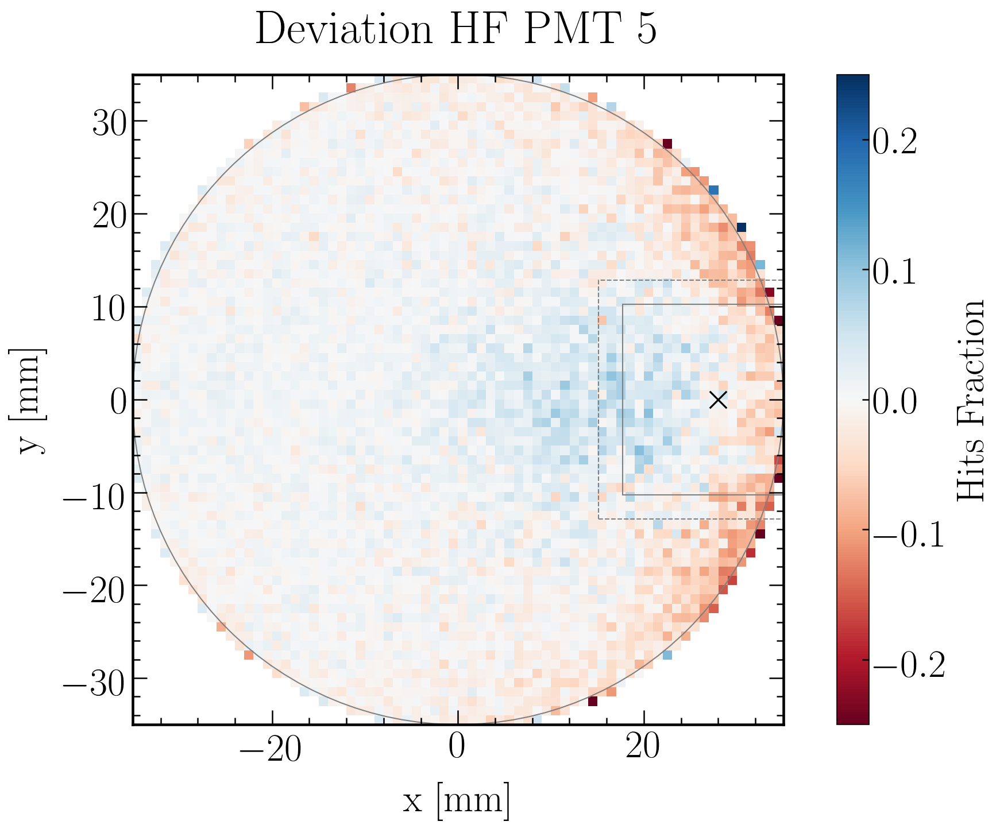

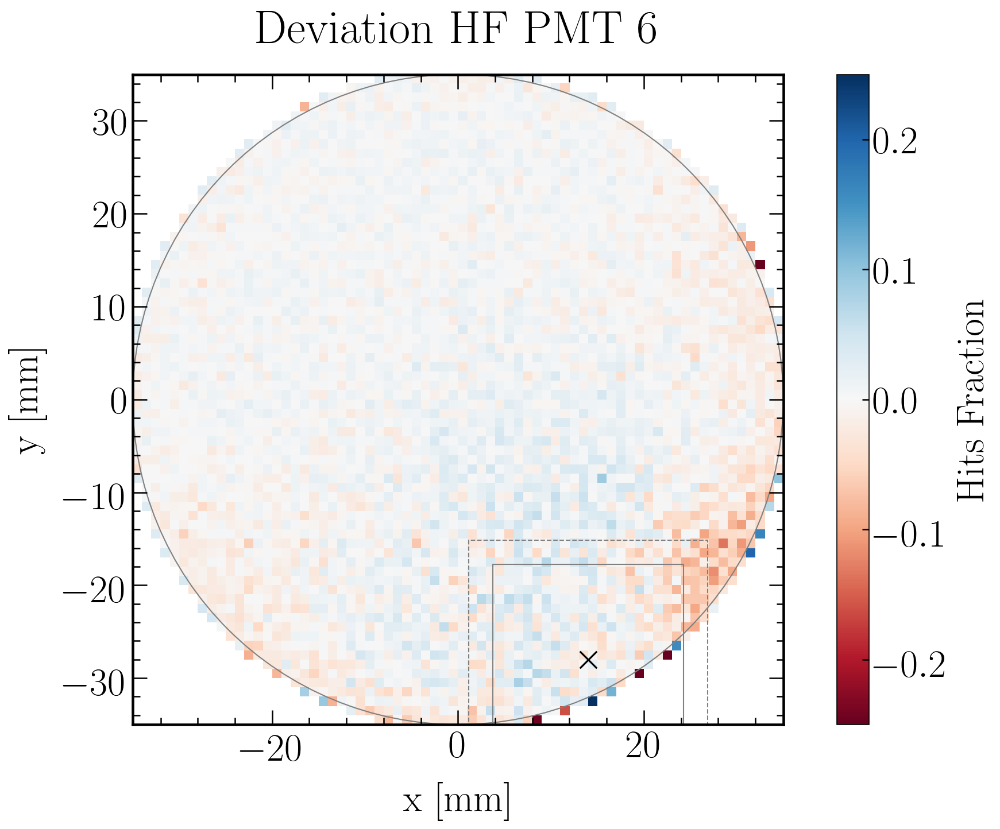

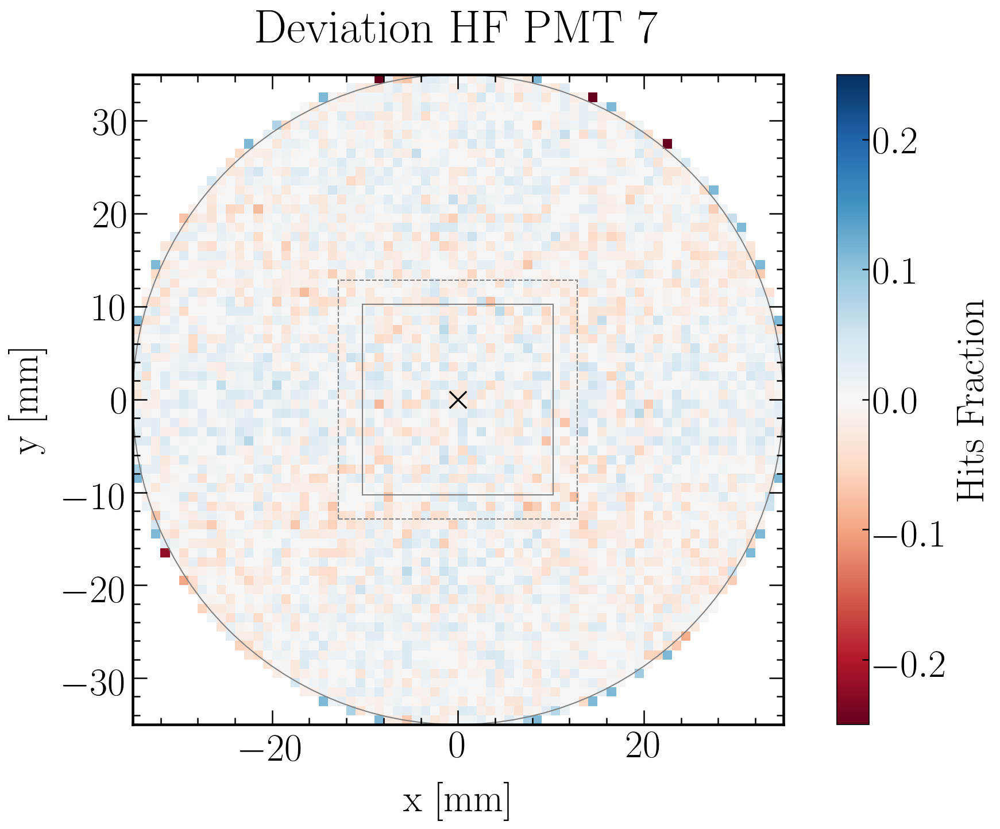

In [63]:
for i in range(1,8):
    
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    '''    
    def z_func(x,y):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1])

    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid
    '''
    Z = HF_x_y_LRF_perPMT['Z'].loc[i]

    #####################
    #data = HF_x_y_hist2d_perPMT['histT'].loc[i]
    #data = Z
    data = (Z - HF_x_y_hist2d_perPMT['histT'].loc[i])
    extent = [HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]]
    plt.imshow(data, interpolation='nearest', origin='low', extent=extent, cmap = cm.RdBu)
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Deviation HF PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(-0.25, 0.25)

    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    #cnt = contour(data, cmap=cm.RdBu, vmin=abs(Z).min(), vmax=abs(Z).max(), extent=extent)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs_"+modelstring+"_Deviation.png")

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:54: RuntimeWarning: divide by zero encountered in true_divide


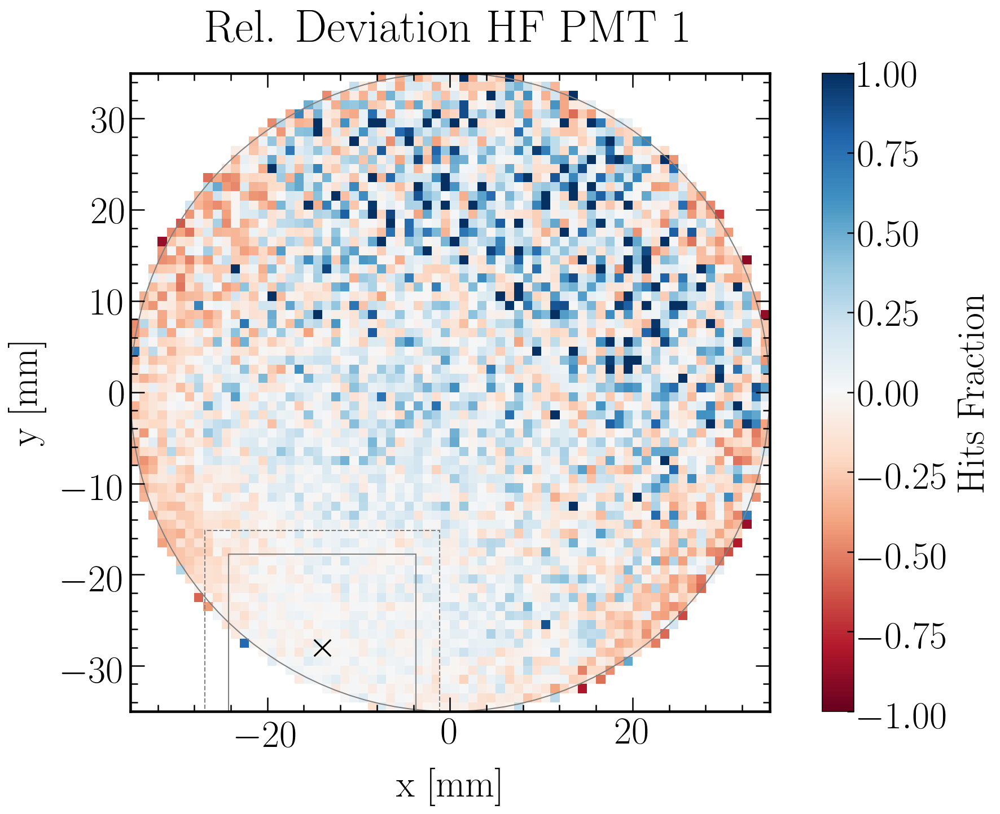

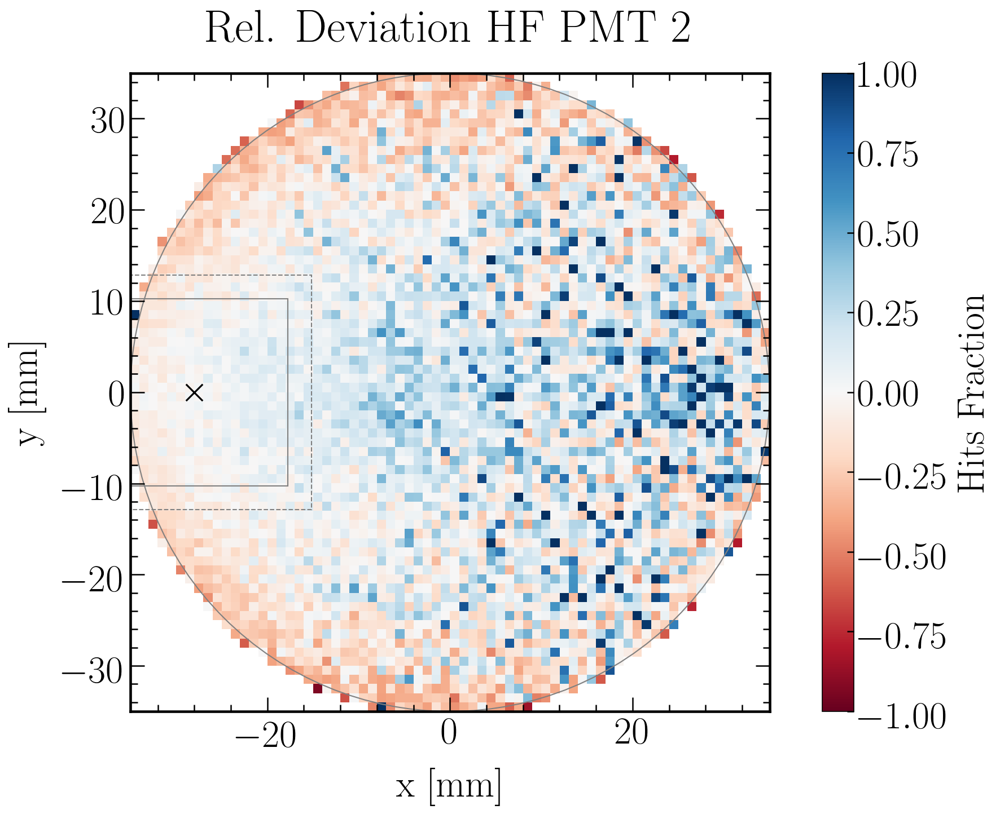

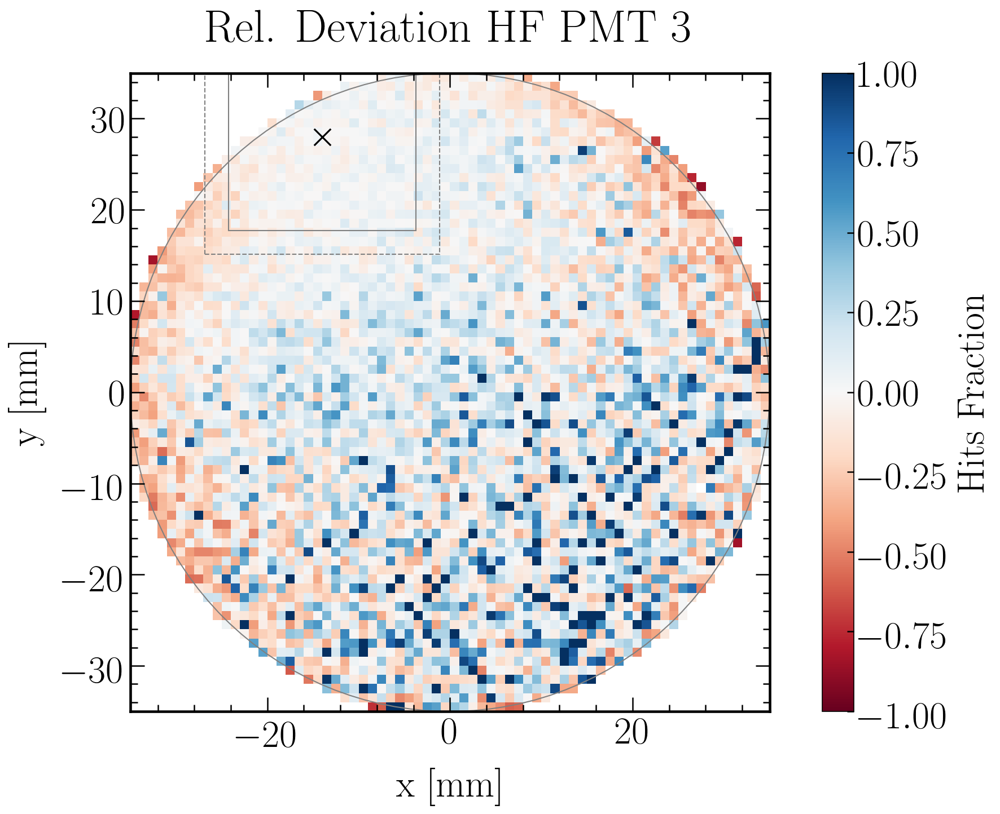

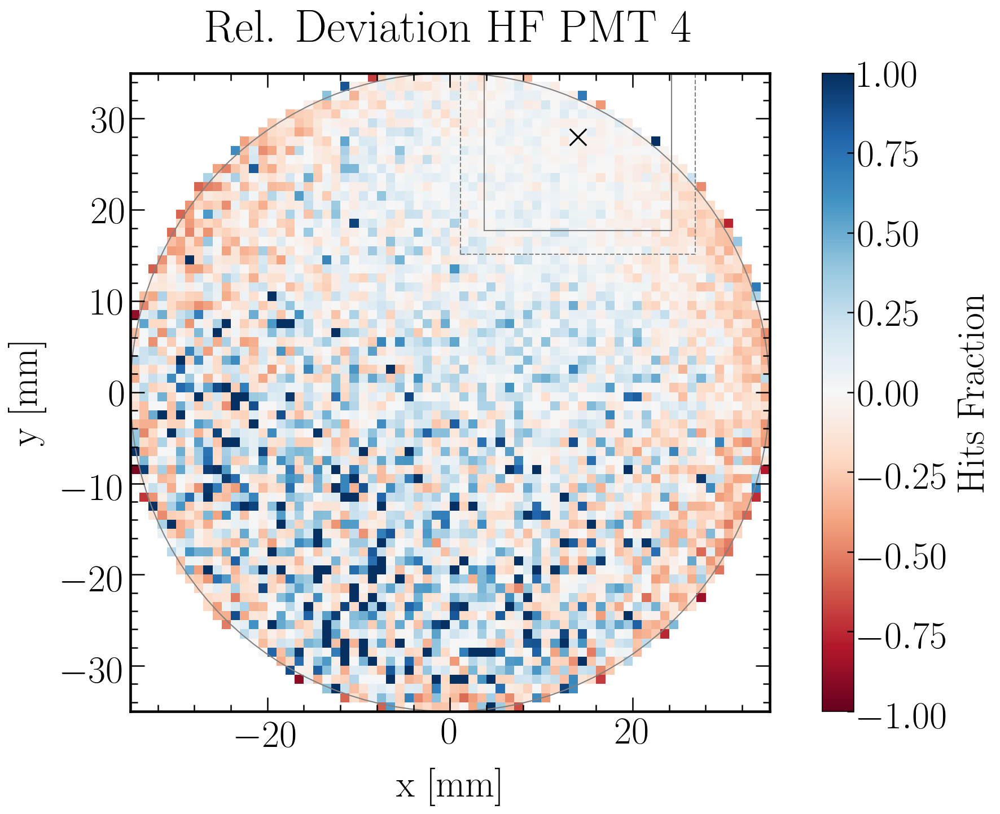

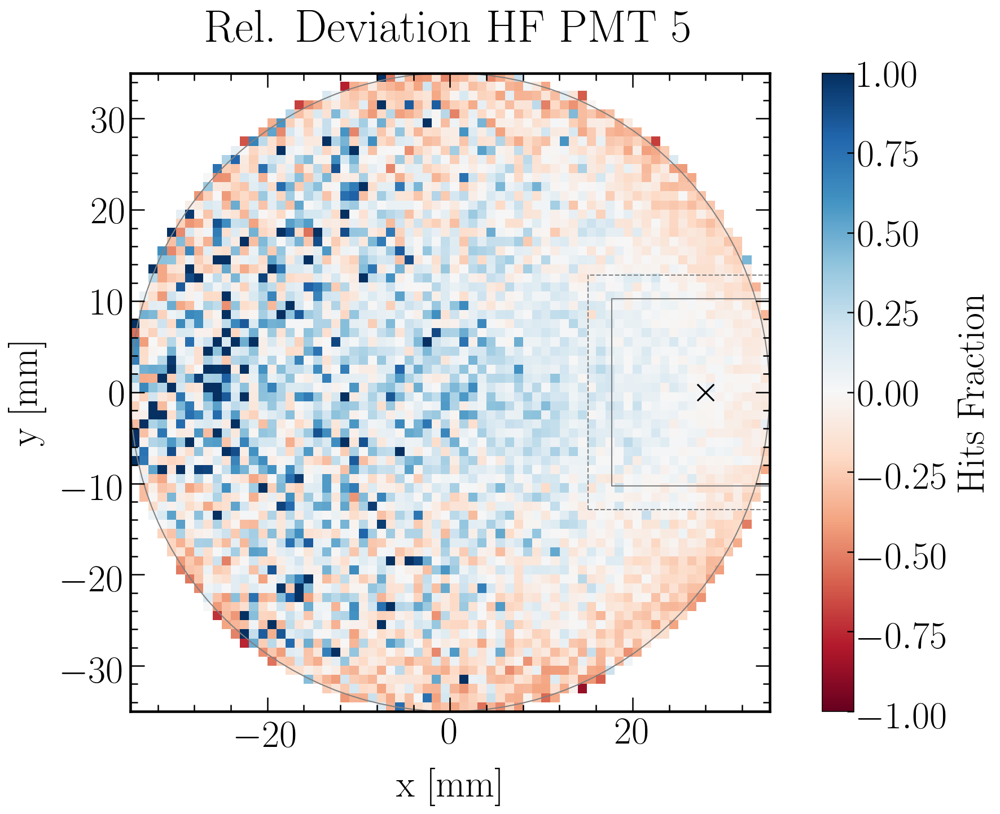

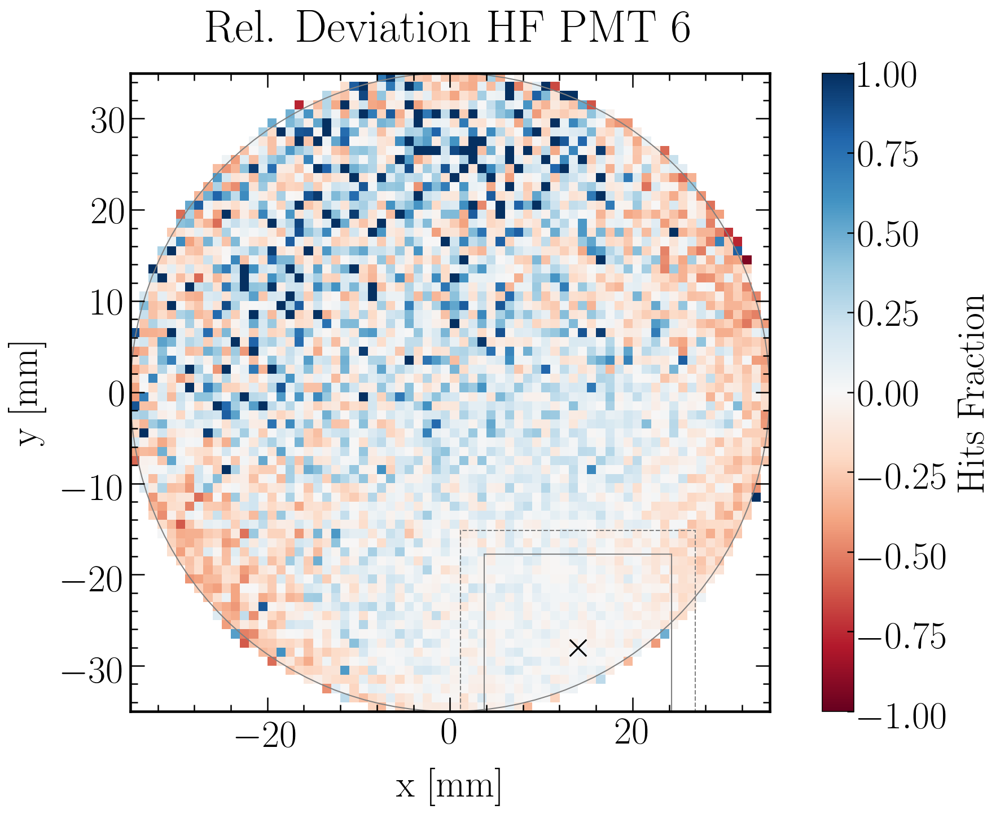

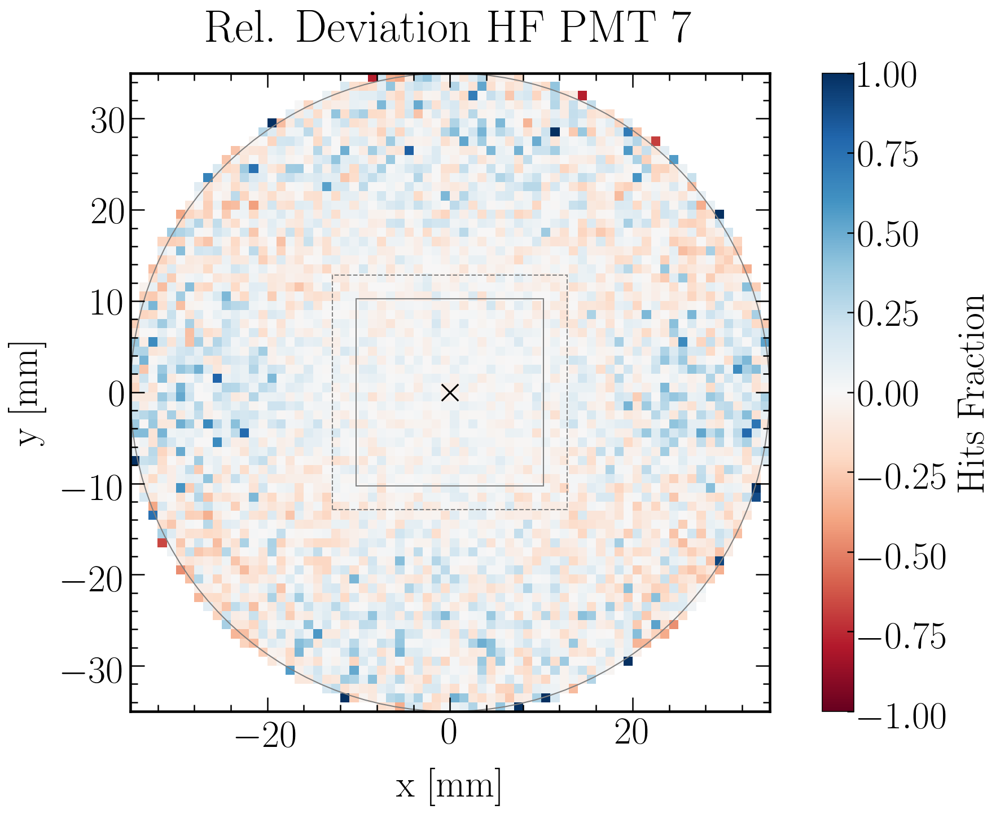

In [64]:
for i in range(1,8):
    
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    '''    
    def z_func(x,y):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1])

    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid
    '''
    Z = HF_x_y_LRF_perPMT['Z'].loc[i]

    #####################
    #data = HF_x_y_hist2d_perPMT['histT'].loc[i]
    #data = Z
    data = ((Z - HF_x_y_hist2d_perPMT['histT'].loc[i]) / (HF_x_y_hist2d_perPMT['histT'].loc[i]))
    extent = [HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]]
    plt.imshow(data, interpolation='nearest', origin='low', extent=extent, cmap = cm.RdBu)
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Rel. Deviation HF PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(-1, 1)

    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    #cnt = contour(data, cmap=cm.RdBu, vmin=abs(Z).min(), vmax=abs(Z).max(), extent=extent)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs_"+modelstring+"_RelDeviation.png")

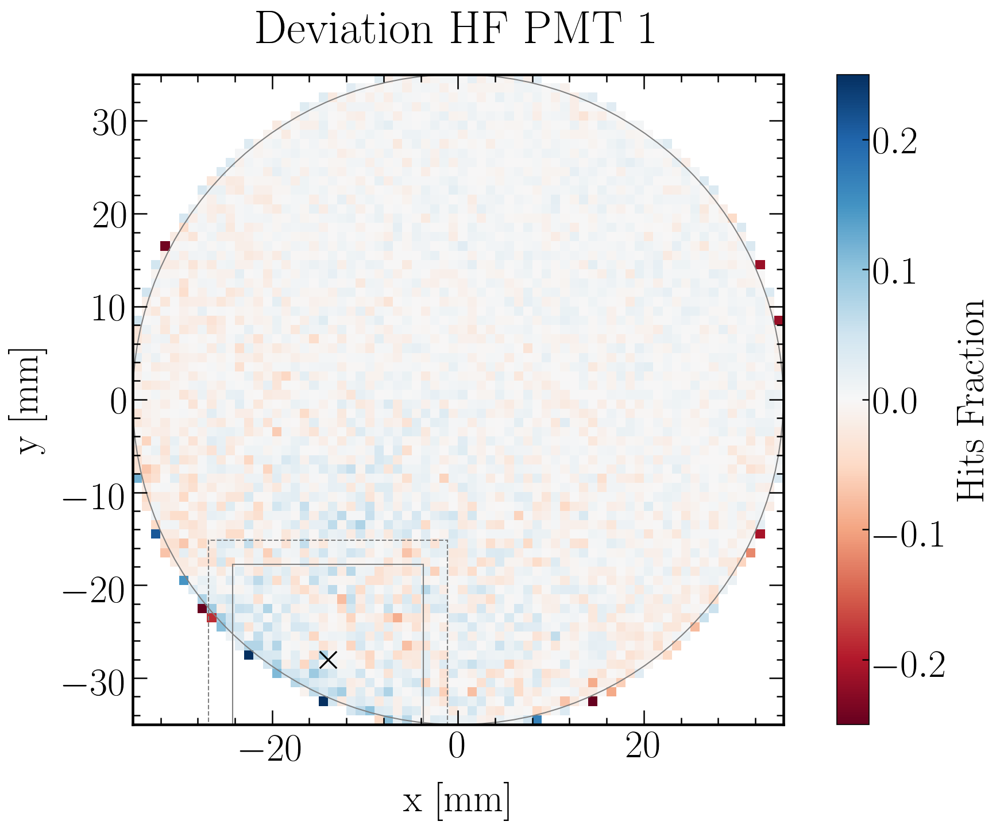

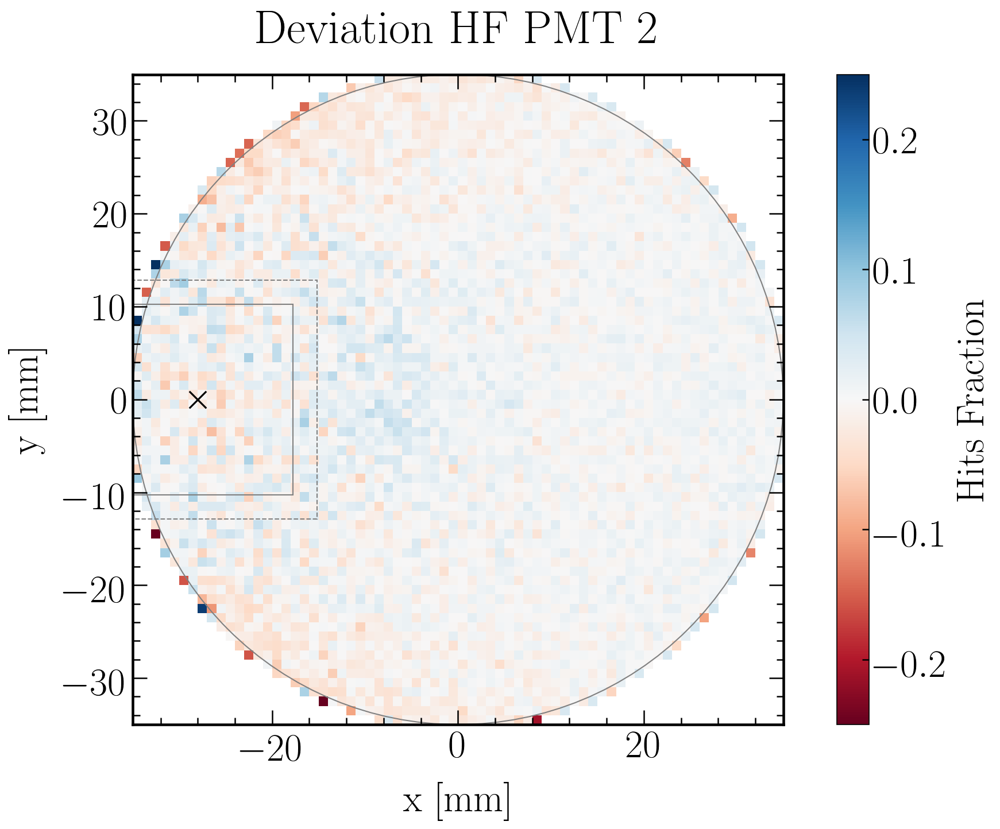

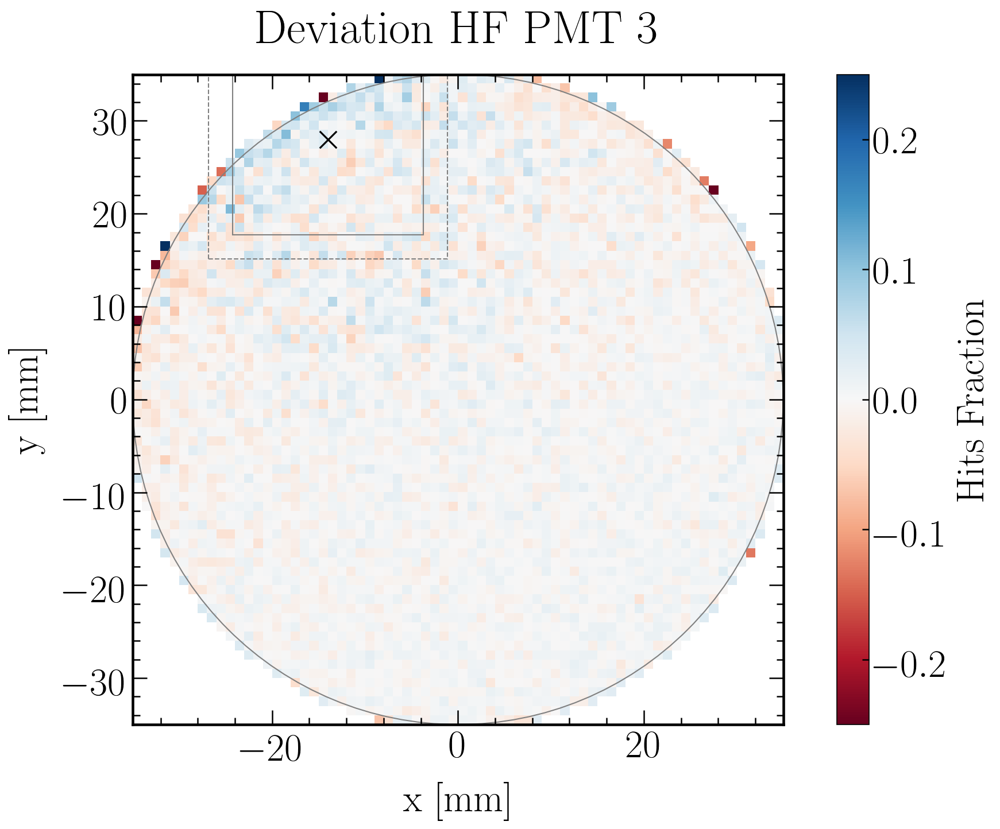

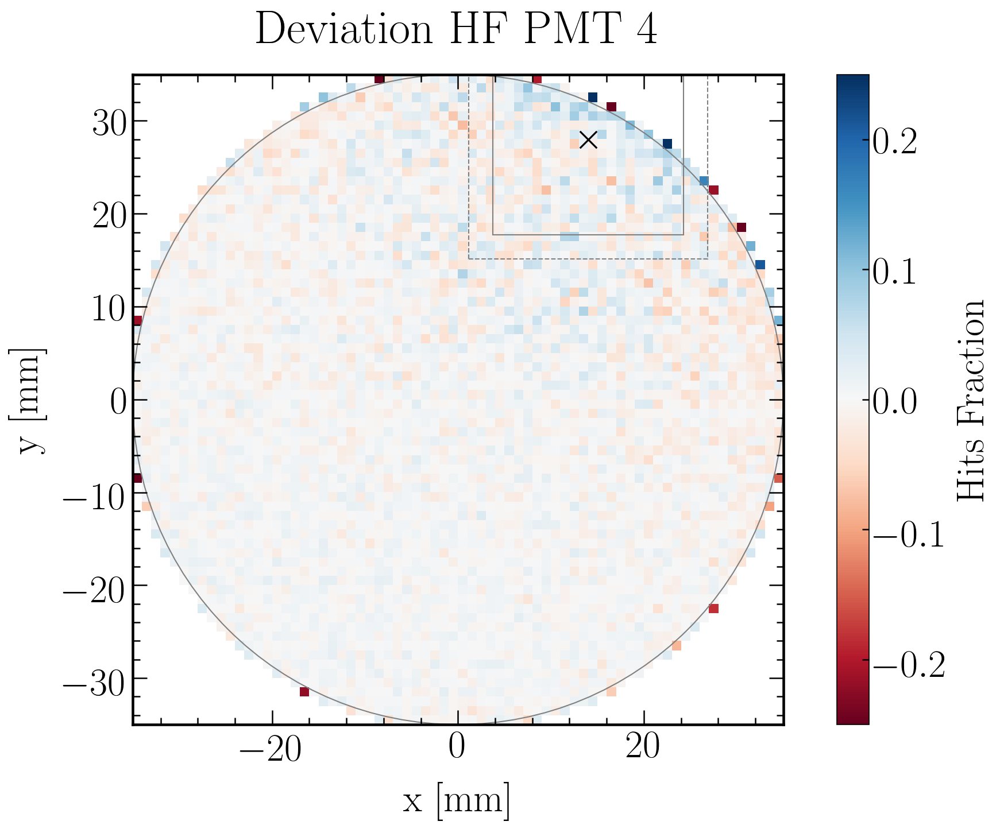

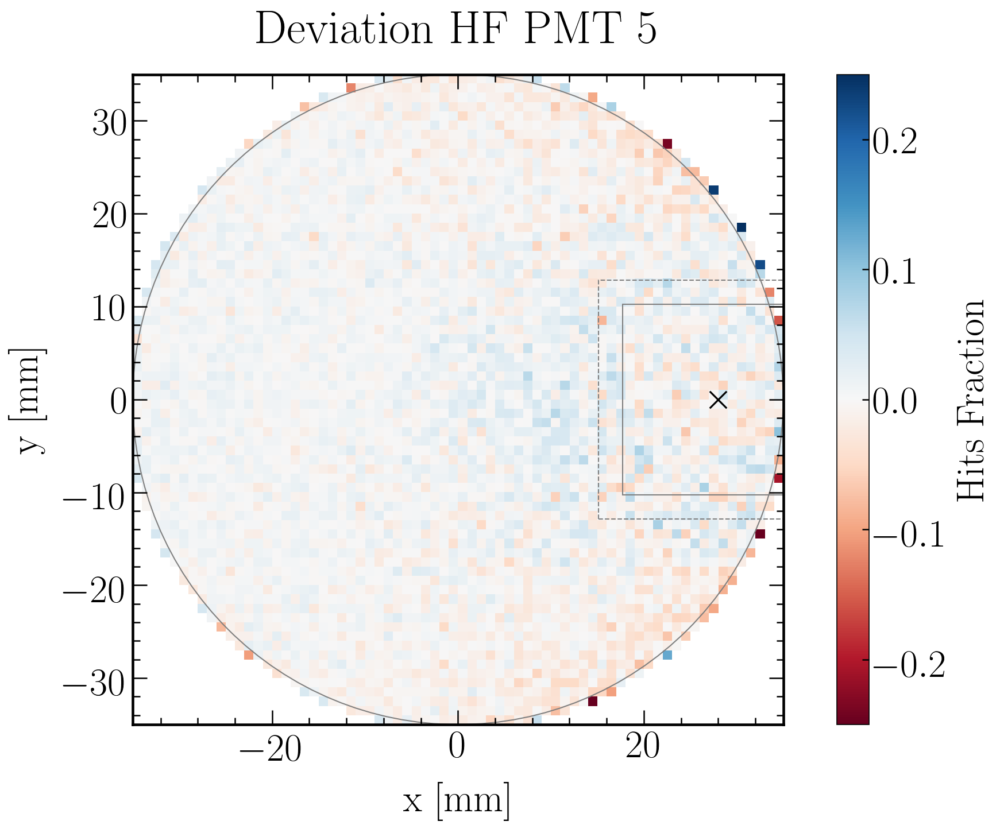

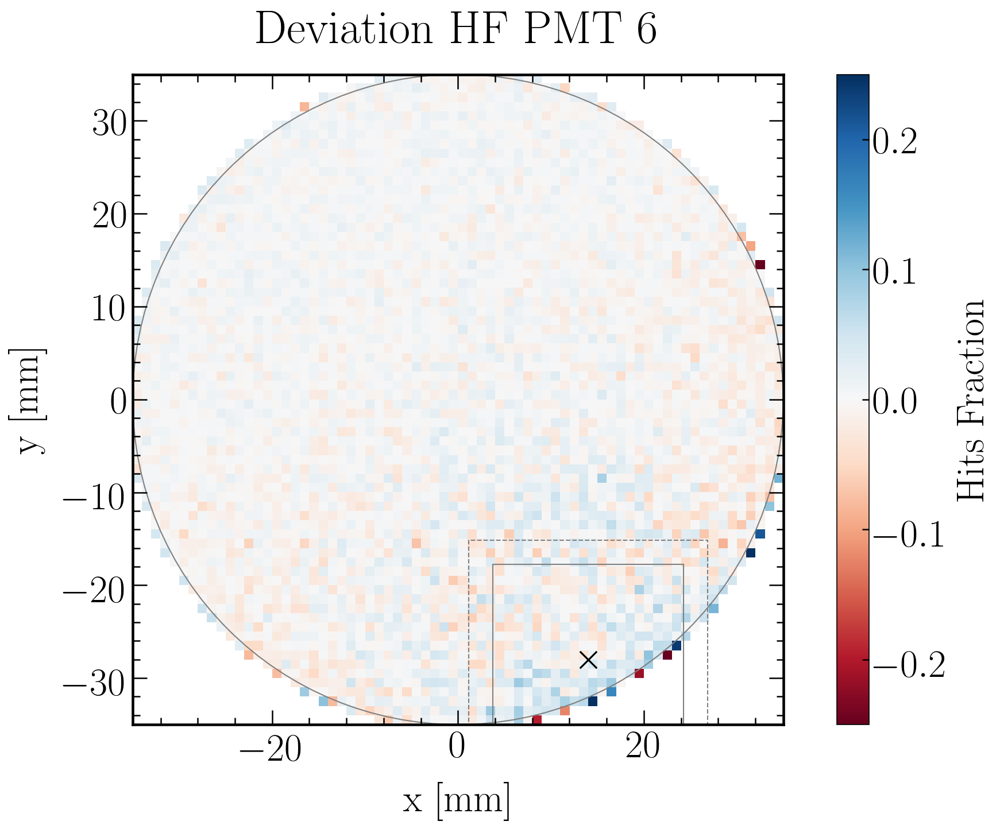

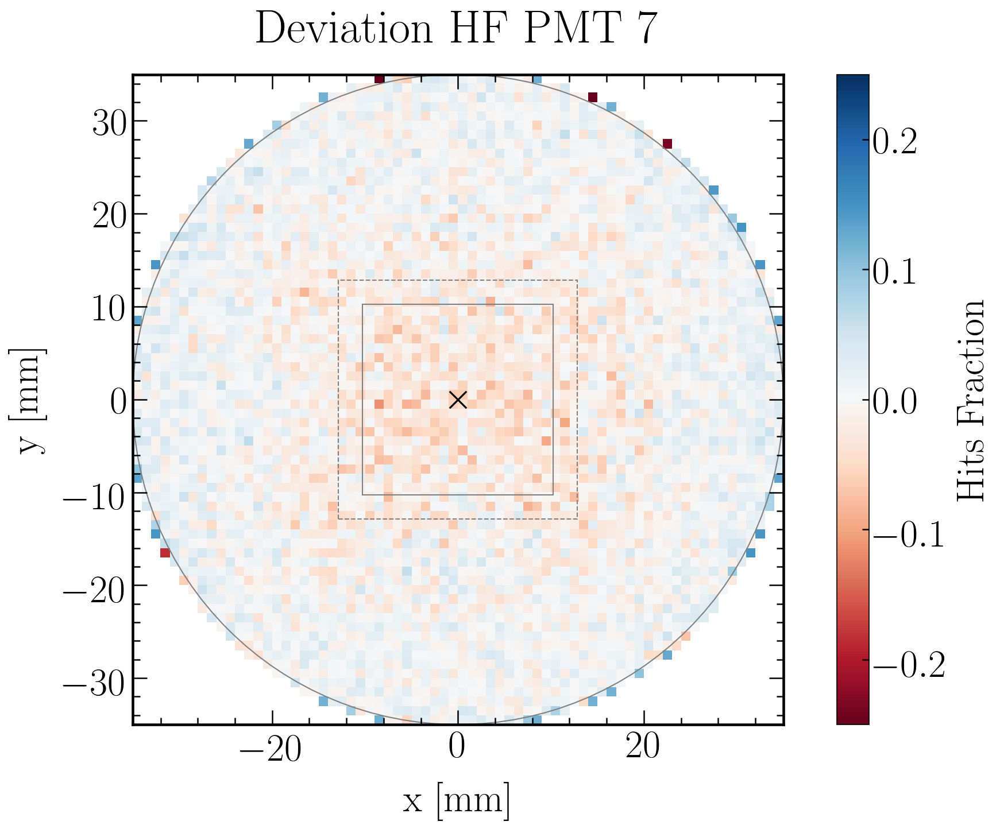

In [65]:
for i in range(1,8):
    
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    '''    
    def z_func(x,y):
        return (model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1]))/(model(np.sqrt((x - PMT_positions['PMT_position_x'][1])**2 + (y - PMT_positions['PMT_position_y'][1])**2), *eval("fit_parameters_"+modelstring)[1-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][2])**2 + (y - PMT_positions['PMT_position_y'][2])**2), *eval("fit_parameters_"+modelstring)[2-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][3])**2 + (y - PMT_positions['PMT_position_y'][3])**2), *eval("fit_parameters_"+modelstring)[3-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][4])**2 + (y - PMT_positions['PMT_position_y'][4])**2), *eval("fit_parameters_"+modelstring)[4-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][5])**2 + (y - PMT_positions['PMT_position_y'][5])**2), *eval("fit_parameters_"+modelstring)[5-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][6])**2 + (y - PMT_positions['PMT_position_y'][6])**2), *eval("fit_parameters_"+modelstring)[6-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][7])**2 + (y - PMT_positions['PMT_position_y'][7])**2), *eval("fit_parameters_"+modelstring)[7-1]))

    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid
    '''
    
    Z = HF_x_y_LRF_perPMT['Z'].loc[i] / HF_x_y_LRF_perPMT_Z_sum

    #####################
    #data = HF_x_y_hist2d_perPMT['histT'].loc[i]
    #data = Z
    data = (Z - HF_x_y_hist2d_perPMT['histT'].loc[i])
    extent = [HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]]
    plt.imshow(data, interpolation='nearest', origin='low', extent=extent, cmap = cm.RdBu)
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Deviation HF PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(-0.25, 0.25)

    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    #cnt = contour(data, cmap=cm.RdBu, vmin=abs(Z).min(), vmax=abs(Z).max(), extent=extent)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs_"+modelstring+"_Deviation_overSumLRFs.png")

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:55: RuntimeWarning: divide by zero encountered in true_divide


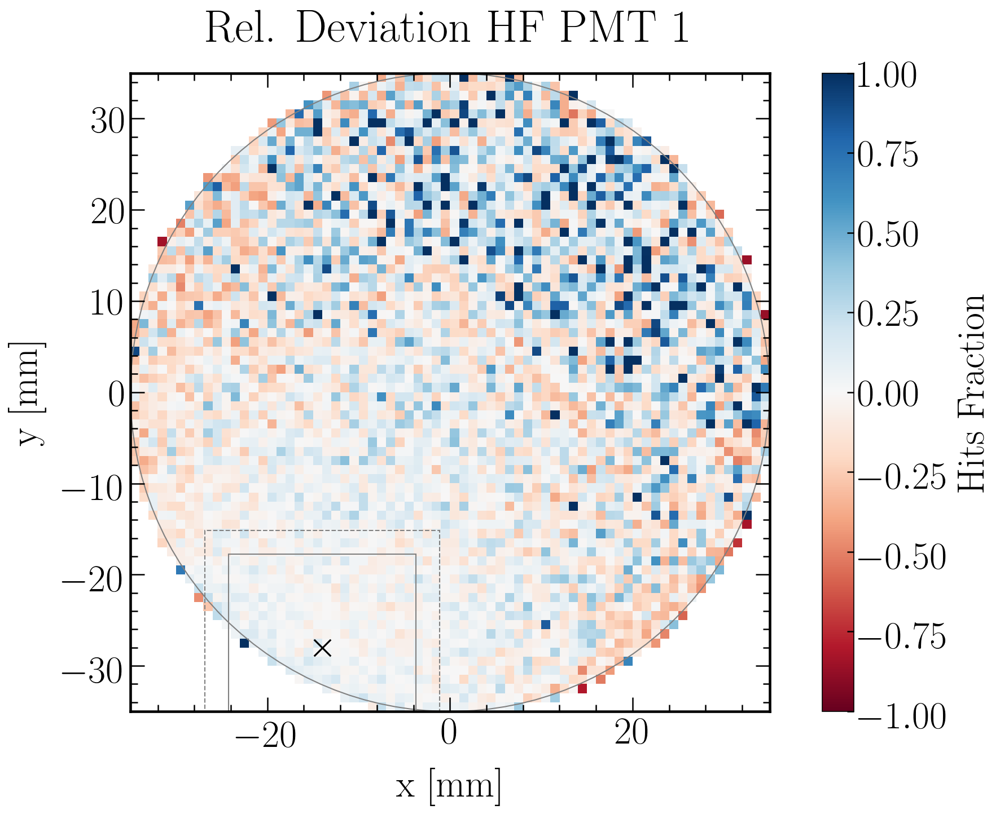

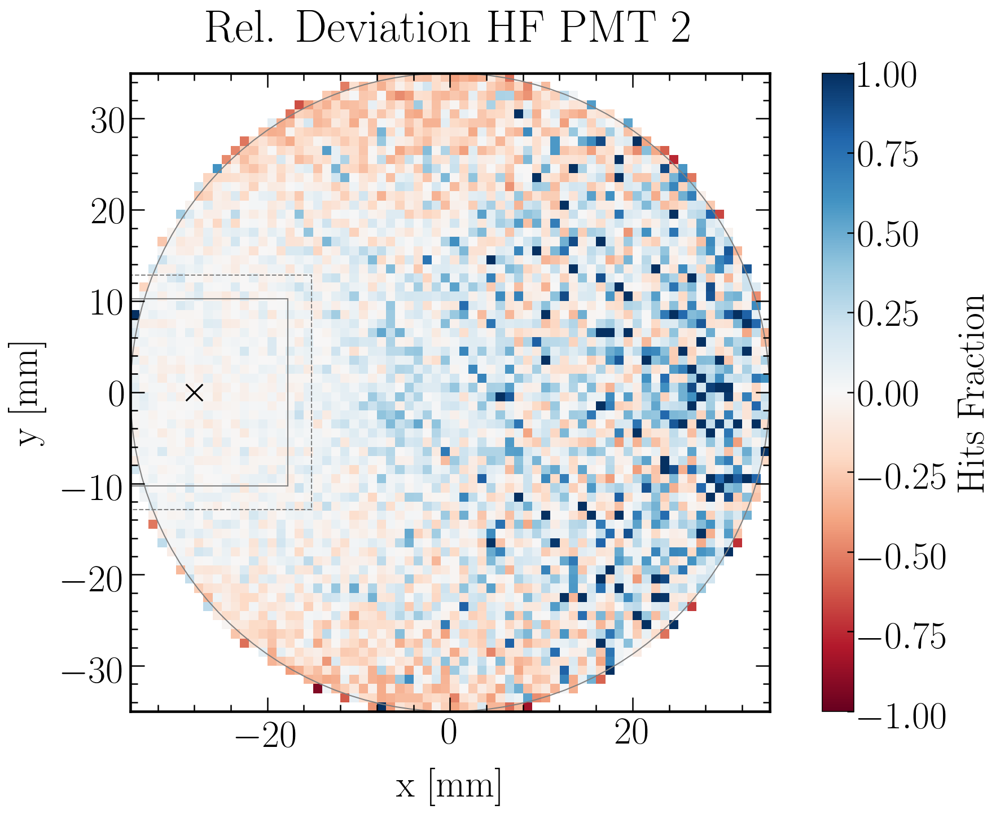

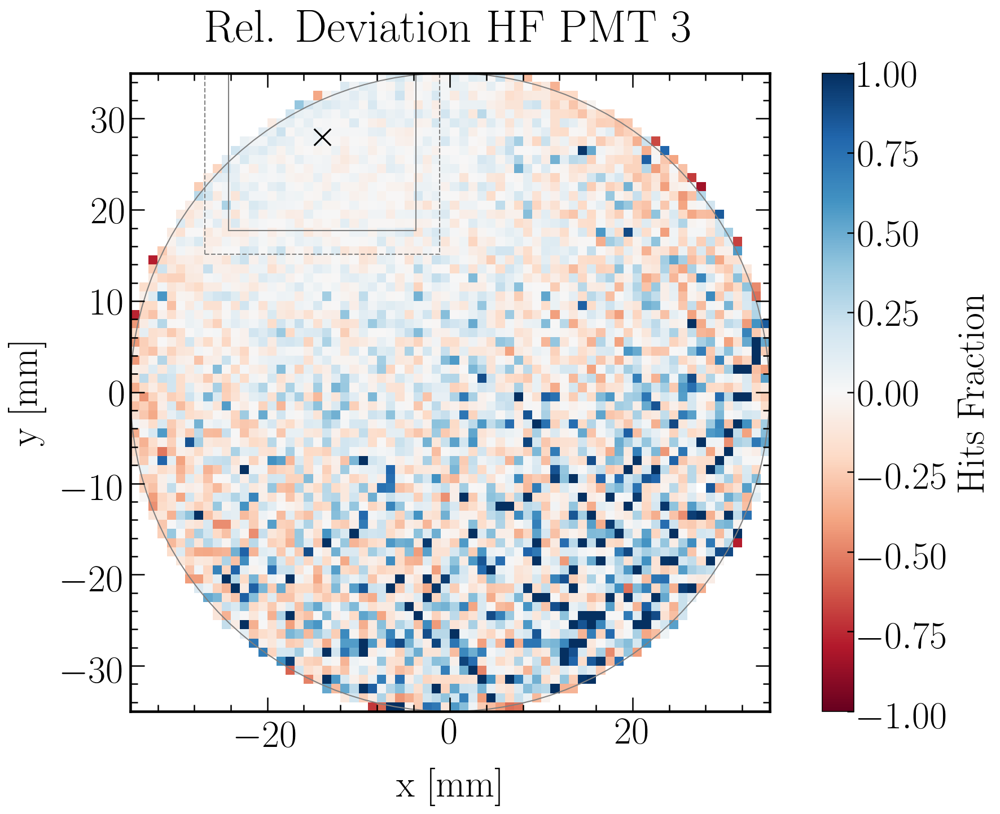

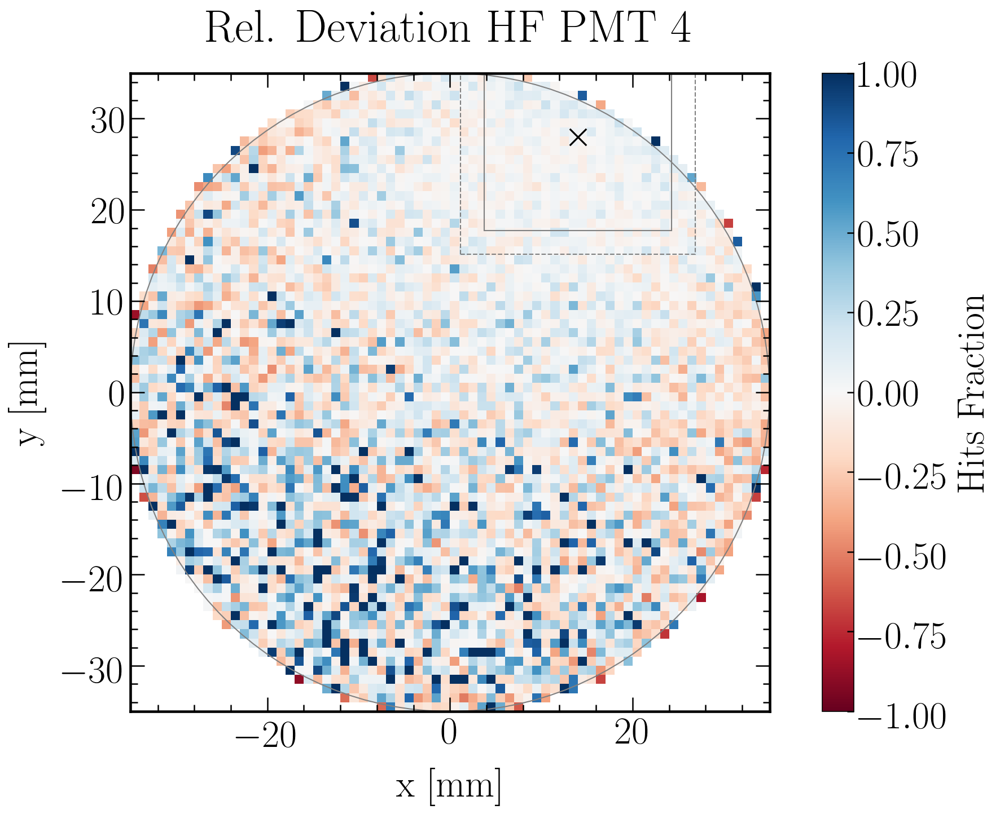

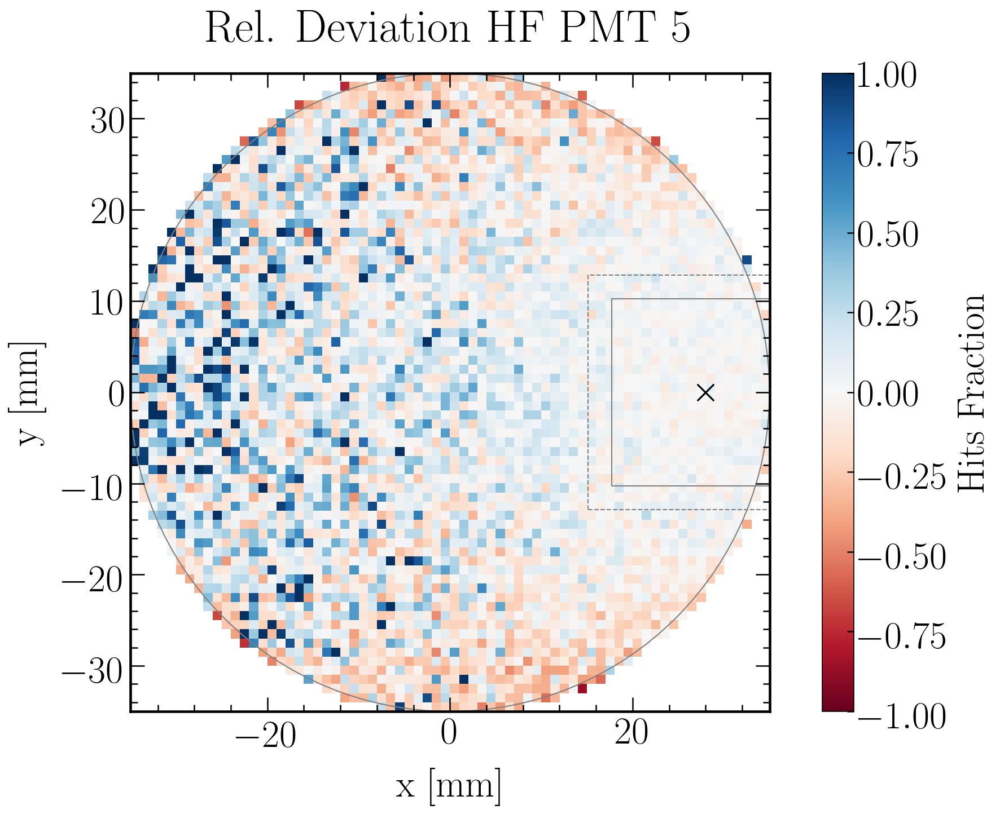

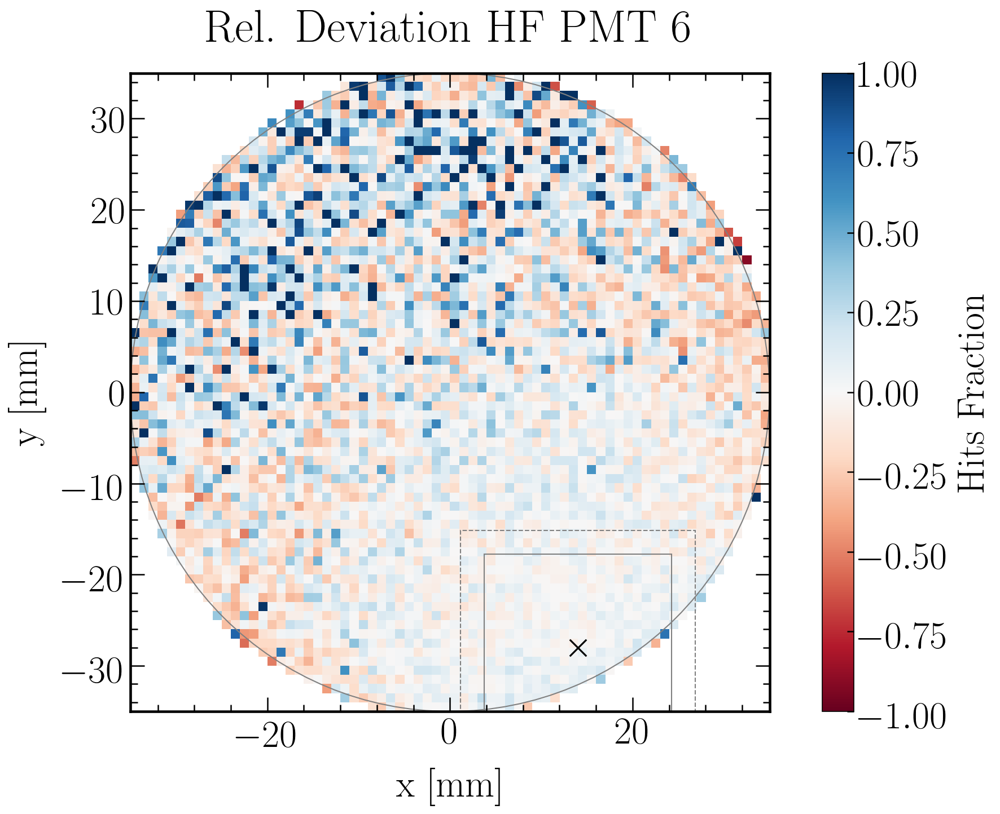

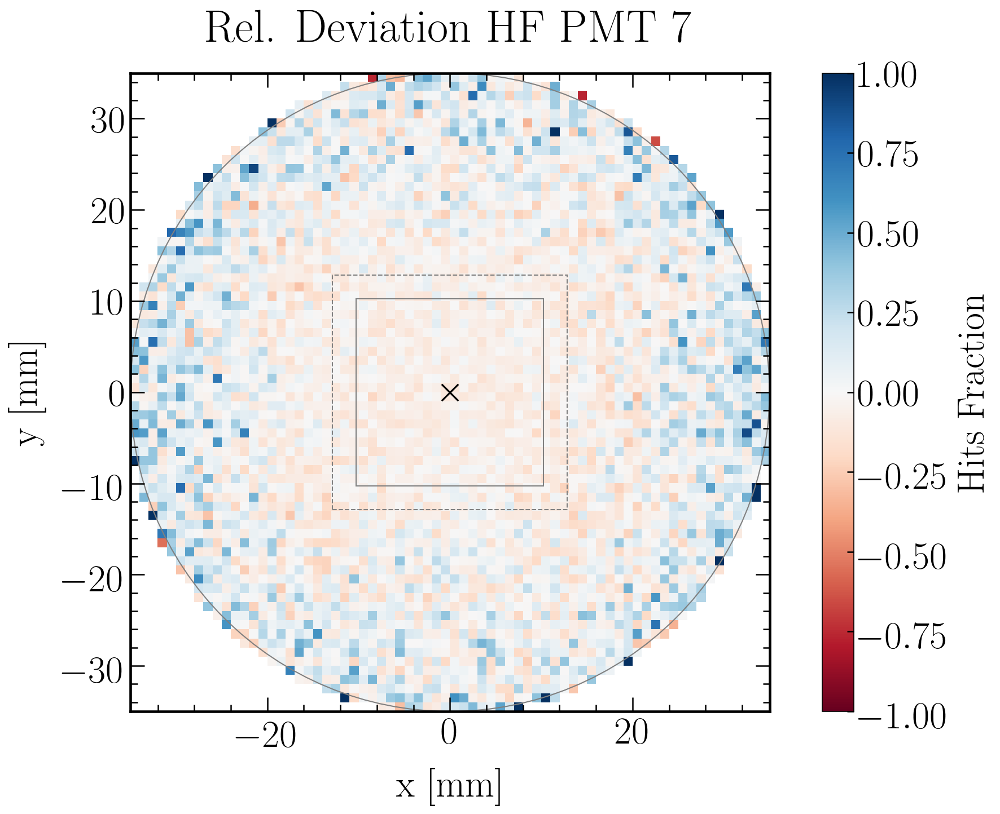

In [66]:
for i in range(1,8):
    
    #############################################
    ## Set plot styles:
    #############################################

    fig=plt.figure(figsize=(16, 10), dpi=150)

    # Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    # Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    # Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    # Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    # Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    #############################################
    ## Plot specific settings and plot data
    #############################################

    # Data plot
    #####################
    '''    
    def z_func(x,y):
        return (model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1]))/(model(np.sqrt((x - PMT_positions['PMT_position_x'][1])**2 + (y - PMT_positions['PMT_position_y'][1])**2), *eval("fit_parameters_"+modelstring)[1-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][2])**2 + (y - PMT_positions['PMT_position_y'][2])**2), *eval("fit_parameters_"+modelstring)[2-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][3])**2 + (y - PMT_positions['PMT_position_y'][3])**2), *eval("fit_parameters_"+modelstring)[3-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][4])**2 + (y - PMT_positions['PMT_position_y'][4])**2), *eval("fit_parameters_"+modelstring)[4-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][5])**2 + (y - PMT_positions['PMT_position_y'][5])**2), *eval("fit_parameters_"+modelstring)[5-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][6])**2 + (y - PMT_positions['PMT_position_y'][6])**2), *eval("fit_parameters_"+modelstring)[6-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][7])**2 + (y - PMT_positions['PMT_position_y'][7])**2), *eval("fit_parameters_"+modelstring)[7-1]))

    x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
    y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
    X, Y = meshgrid(x, y) # grid of point
    Z = z_func(X, Y) # evaluation of the function on the grid
    '''
    
    Z = HF_x_y_LRF_perPMT['Z'].loc[i] / HF_x_y_LRF_perPMT_Z_sum

    #####################
    #data = HF_x_y_hist2d_perPMT['histT'].loc[i]
    #data = Z
    data = ((Z - HF_x_y_hist2d_perPMT['histT'].loc[i]) / (HF_x_y_hist2d_perPMT['histT'].loc[i]))
    extent = [HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]]
    plt.imshow(data, interpolation='nearest', origin='low', extent=extent, cmap = cm.RdBu)
    #####################

    plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
    plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
    plt.title('Rel. Deviation HF PMT '+str(i), fontsize = title_size, pad = title_pad)

    plt.gca().set_aspect('equal', adjustable='box')

    # Colorbar
    cbar = plt.colorbar()
    cbar.outline.set_linewidth(2.2)
    cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
    cbar.set_label(label='Hits Fraction', fontsize=label_size)
    plt.clim(-1, 1)

    plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
    currentAxis = plt.gca()
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
    circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
    currentAxis.add_artist(circle)

    #cnt = contour(data, cmap=cm.RdBu, vmin=abs(Z).min(), vmax=abs(Z).max(), extent=extent)

    plt.show()
    fig.savefig(filenameprefix+"_Hits_Fraction_x_y_PMT"+str(i)+"_of_TopPMTs_"+modelstring+"_RelDeviation_overSumLRFs.png")

### Polar LRF

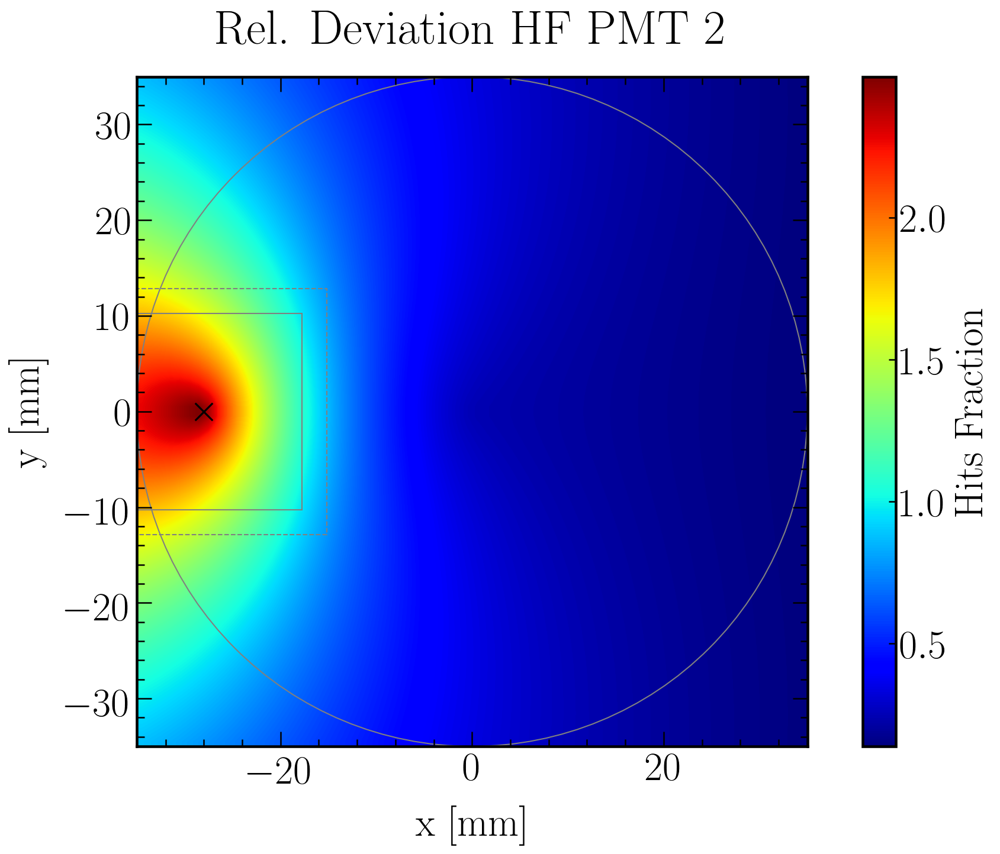

In [67]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
def z_func(x,y):
    return model(np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2), *eval("fit_parameters_"+modelstring)[i-1])

x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
X, Y = meshgrid(x, y) # grid of point
Z = z_func(X, Y) # evaluation of the function on the grid

#####################
i = 2

def z_func(x,y):
    r = np.sqrt((x - PMT_positions['PMT_position_x'][i])**2 + (y - PMT_positions['PMT_position_y'][i])**2)
    r_int = np.sqrt((x)**2 + (y)**2)
    return np.exp(- r/ 20)*np.exp(r_int /30)

x = HF_x_y_hist2d_perPMT['xedges_center'].loc[i]
y = HF_x_y_hist2d_perPMT['yedges_center'].loc[i]
X, Y = meshgrid(x, y) # grid of point
Z = z_func(X, Y) # evaluation of the function on the grid

im = plt.imshow(Z, origin='low', extent=[HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
im.set_interpolation('bilinear') 
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('Rel. Deviation HF PMT '+str(i), fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='Hits Fraction', fontsize=label_size)
#plt.clim(-0.25, 0.25)

plt.scatter(PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i], marker = "x", color = 'black', s = 200)  
currentAxis = plt.gca()
currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

#cnt = contour(data, cmap=cm.RdBu, vmin=abs(Z).min(), vmax=abs(Z).max(), extent=extent)

plt.show()

-> Postponed

### Directly reconstructed positions with Radial LRF

In [68]:
##############################################################
### Simulated 'measured' HF to be reconstructed

## Grid real positions
x = HF_x_y_hist2d_perPMT['xedges_center'].loc[6] # xedges_center hist2d
y = HF_x_y_hist2d_perPMT['yedges_center'].loc[6] # yedges_center hist2d
X, Y = meshgrid(x, y)
del(x)
del(y)
# selection in meshgrid(x, y): [y from low to high][x from low to high]
# same order in X, Y = meshgrid(x, y) and HF_x_y_hist2d_perPMT['histT'].loc[i]

## Index for selection array position
i_y = 23  # 20, issue 23
i_x = 12  # 7, issue 12
position_x_real = X[i_y][i_x]
position_y_real = Y[i_y][i_x]
position_real = np.array([position_x_real, position_y_real])
print('x_real = '+str(position_x_real)+' mm\ny_real = '+str(position_y_real)+' mm')

## Simulated measured hits fractions for input real position
HFs_measured = np.array([HF_x_y_hist2d_perPMT['histT'].loc[j][i_y][i_x] for j in range(1,8)])
print('HFs_measured = '+str(HFs_measured))

x_real = -22.5 mm
y_real = -11.5 mm
HFs_measured = [0.24369748 0.45938375 0.03921569 0.02240896 0.03641457 0.05042017
 0.14845938]


In [69]:
averagephotonsseen = 30
print(1/(averagephotonsseen-np.sqrt(averagephotonsseen)))

0.04077842020120881


In [70]:
##############################################################

## Function q to minimize for position reconstruction 
## Choose from: 'ChiSquared' 'LogLikelihoodRatio' 'WeightedChiSquared'
minimizer = 'ChiSquared'      # 'ChiSquared'

## Choice for LRF model
model = eta_v2                # eta_v2
modelstring = 'eta_v2'        # 'eta_v2'

## Normalize LRFs to sum LRFs for all PMTs
normalization_to_sum = True   # True

## Ignore PMTs (i.e. set HF and LRF to 0) with light share below a specific threshold
cut_LS_PMT = False             # False

if cut_LS_PMT == True:
    cut_LS_PMT_threshold = 0.04 # start playing around with 0.04 - 0.05

##############################################################

## Mask to exclude PMTs not passing cut_LS_PMT_threshold
def pass_cut_LS_PMT_threshold(HFs_input):
    if cut_LS_PMT == True:
        return (HFs_input >= cut_LS_PMT_threshold).astype(int)
    if cut_LS_PMT == False:
        return (np.array([1]*7))

'''
## LRF values for above conditions
if normalization_to_sum == False: ## radial LRFs only
    modelstring_save = modelstring
    def LRF_PMTi(x, y, PMT):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][PMT])**2 + (y - PMT_positions['PMT_position_y'][PMT])**2), *eval("fit_parameters_"+modelstring)[PMT-1])
        
if normalization_to_sum == True: ## radial LRFs normalized to sum radial LRFs
    modelstring_save = modelstring+'_overSum'
    def LRF_PMTi(x, y, PMT):
        return (model(np.sqrt((x - PMT_positions['PMT_position_x'][PMT])**2 + (y - PMT_positions['PMT_position_y'][PMT])**2), *eval("fit_parameters_"+modelstring)[PMT-1]))/(model(np.sqrt((x - PMT_positions['PMT_position_x'][1])**2 + (y - PMT_positions['PMT_position_y'][1])**2), *eval("fit_parameters_"+modelstring)[1-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][2])**2 + (y - PMT_positions['PMT_position_y'][2])**2), *eval("fit_parameters_"+modelstring)[2-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][3])**2 + (y - PMT_positions['PMT_position_y'][3])**2), *eval("fit_parameters_"+modelstring)[3-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][4])**2 + (y - PMT_positions['PMT_position_y'][4])**2), *eval("fit_parameters_"+modelstring)[4-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][5])**2 + (y - PMT_positions['PMT_position_y'][5])**2), *eval("fit_parameters_"+modelstring)[5-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][6])**2 + (y - PMT_positions['PMT_position_y'][6])**2), *eval("fit_parameters_"+modelstring)[6-1]) + model(np.sqrt((x - PMT_positions['PMT_position_x'][7])**2 + (y - PMT_positions['PMT_position_y'][7])**2), *eval("fit_parameters_"+modelstring)[7-1]))

## LRF values for all PMTs
def LRF_PMTs(x, y):
    return np.array([LRF_PMTi(x, y, j) for j in range(1,8)])
'''

## LRF values for above conditions
if normalization_to_sum == False: ## radial LRFs only
    modelstring_save = modelstring
    def LRF_PMTi(x, y, PMT):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][PMT])**2 + (y - PMT_positions['PMT_position_y'][PMT])**2), *eval("fit_parameters_"+modelstring)[PMT-1])
    def LRF_PMTs(x, y, HFs_input):
        return np.array([LRF_PMTi(x, y, j) for j in range(1,8)])*pass_cut_LS_PMT_threshold(HFs_input)
    
if normalization_to_sum == True: ## radial LRFs normalized to sum radial LRFs
    modelstring_save = modelstring+'_overSum'
    def LRF_PMTi(x, y, PMT):
        return model(np.sqrt((x - PMT_positions['PMT_position_x'][PMT])**2 + (y - PMT_positions['PMT_position_y'][PMT])**2), *eval("fit_parameters_"+modelstring)[PMT-1])
    def LRF_PMTs(x, y, HFs_input):
        LRF_PMTs_array = np.array([LRF_PMTi(x, y, j) for j in range(1,8)])*pass_cut_LS_PMT_threshold(HFs_input)
        LRF_PMTs_array_uncut = np.array([LRF_PMTi(x, y, j) for j in range(1,8)])
        return LRF_PMTs_array / (np.sum(LRF_PMTs_array_uncut))
print('HFs_measured         '+str(HFs_measured*pass_cut_LS_PMT_threshold(HFs_measured)))
print('HFs_measured_uncut = '+str(HFs_measured))    
print('HFs_LRFs =           '+str(LRF_PMTs(position_x_real, position_y_real, HFs_measured)))
print('HFs_LRFs_uncut =     '+str(LRF_PMTs(position_x_real, position_y_real, np.array([1]*7))))


##############################################################
## Unweighted Chi squared from LRFs:

if minimizer == 'ChiSquared':
    modelstring_save = modelstring_save+'_Chi2'
    
    ## numerator [top of the fraction]
    def numerator(x, y, HFs_input):
        return (LRF_PMTs(x, y, HFs_input) - HFs_input*pass_cut_LS_PMT_threshold(HFs_input))**2
    
    ## denominator [bottom of a fraction]
    def denominator(x, y):
        return LRF_PMTs(x, y, (np.array([1]*7)))
    
    ## Chi²
    def q(x, y, HFs_input):
        return np.sum(numerator(x, y, HFs_input) / denominator(x, y))

## Weighted Chi squared from LRFs:
    
if minimizer == 'WeightedChiSquared':
    modelstring_save = modelstring_save+'_WChi2'
    sigma = 1./3. # excess noise factor for each PMT
    
    ## numerator [top of the fraction]
    def numerator(x, y, HFs_input):
        return (LRF_PMTs(x, y, HFs_input) - HFs_input*pass_cut_LS_PMT_threshold(HFs_input))**2
    
    ## denominator [bottom of a fraction]
    def denominator(x, y):
        return LRF_PMTs(x, y, (np.array([1]*7))) * (1 + sigma**2)
    
    ## Chi²
    def q(x, y, HFs_input):
        return np.sum(numerator(x, y, HFs_input) / denominator(x, y))

## Log Likelihood Ratio from LRFs:    

if minimizer == 'LogLikelihoodRatio':
    modelstring_save = modelstring_save+'_LLR'
    
    def q(x, y, HFs_input):
        summed = 0
        for i in range(0,7):
            if pass_cut_LS_PMT_threshold(HFs_input)[i] > 0:
                summed += 2 * (LRF_PMTs(x, y, HFs_input)[i] - HFs_input[i]*pass_cut_LS_PMT_threshold(HFs_input)[i] + HFs_input[i]*pass_cut_LS_PMT_threshold(HFs_input)[i] * np.log( (HFs_input[i]*pass_cut_LS_PMT_threshold(HFs_input)[i]) / (LRF_PMTs(x, y, HFs_input)[i]) ))
        return summed

if cut_LS_PMT == True:
    modelstring_save = modelstring_save+'_normalization_to_sum_'+str(normalization_to_sum)+'_cut_LS_PMT_'+str(cut_LS_PMT_threshold)
else:
    modelstring_save = modelstring_save+'_normalization_to_sum_'+str(normalization_to_sum)
print(modelstring_save)
print('q = '+str(q(position_x_real, position_y_real, HFs_measured)))

HFs_measured         [0.24369748 0.45938375 0.         0.         0.         0.05042017
 0.14845938]
HFs_measured_uncut = [0.24369748 0.45938375 0.03921569 0.02240896 0.03641457 0.05042017
 0.14845938]
HFs_LRFs =           [0.25089699 0.44662957 0.         0.         0.         0.04606435
 0.14356754]
HFs_LRFs_uncut =     [0.25089699 0.44662957 0.04522085 0.03031913 0.03730157 0.04606435
 0.14356754]
eta_v2_overSum_Chi2_normalization_to_sum_True_cut_LS_PMT_0.04
q = 0.0011493709129300116


In [71]:
# Function to return non-negative value corresponding to (radial position - radius TPC) if inside TPC
# used for constraints

def insidevolume(inputs):
    return (35 - np.sqrt(inputs[0]**2 + inputs[1]**2))

## Reconstruct position by minimizing q

def reconstructed(HFs_input):
    reconstruct = lambda x: q(x[0], x[1], HFs_input) # The objective function to be minimized.
    x0 = [0.001,0.001] # Initial guess.
    bnds = ((-35, 35), (-35, 35)) # Bounds on variables for L-BFGS-B, TNC, SLSQP and trust-constr methods.
    meth = 'SLSQP' # Type of solver. 'BFGS' / 'L-BFGS-B' / 'SLSQP' / ...
    cons = ({'type': 'ineq', "fun": insidevolume}) # Constraints definition (only for COBYLA, SLSQP and trust-constr).
    ################################
    # The optimization result represented as a OptimizeResult object:
    #res = minimize(reconstruct, x0, method = meth)
    #res = minimize(reconstruct, x0, bounds = bnds)
    res = minimize(reconstruct, x0, method=meth, constraints=cons)
    return res

reconstructed(HFs_measured)
#reconstructed(HFs_measured).x

     fun: 0.0012895705089934501
     jac: array([0.00023998, 0.00011717])
 message: 'Optimization terminated successfully.'
    nfev: 65
     nit: 16
    njev: 16
  status: 0
 success: True
       x: array([-31.4426383 , -15.37402018])

In [72]:
## 2D plot of q

q_2dArray = np.zeros_like(X)
for j_y in range(0, q_2dArray.shape[1]):
    for j_x in range(0, q_2dArray.shape[0]):
        #q_2dArray[j_y][j_x] = X[j_y][j_x]
        #q_2dArray[j_y][j_x] = Y[j_y][j_x]
        q_2dArray[j_y][j_x] = q(X[j_y][j_x], Y[j_y][j_x], HFs_measured)

q_2dArray_log = np.log10(q_2dArray)

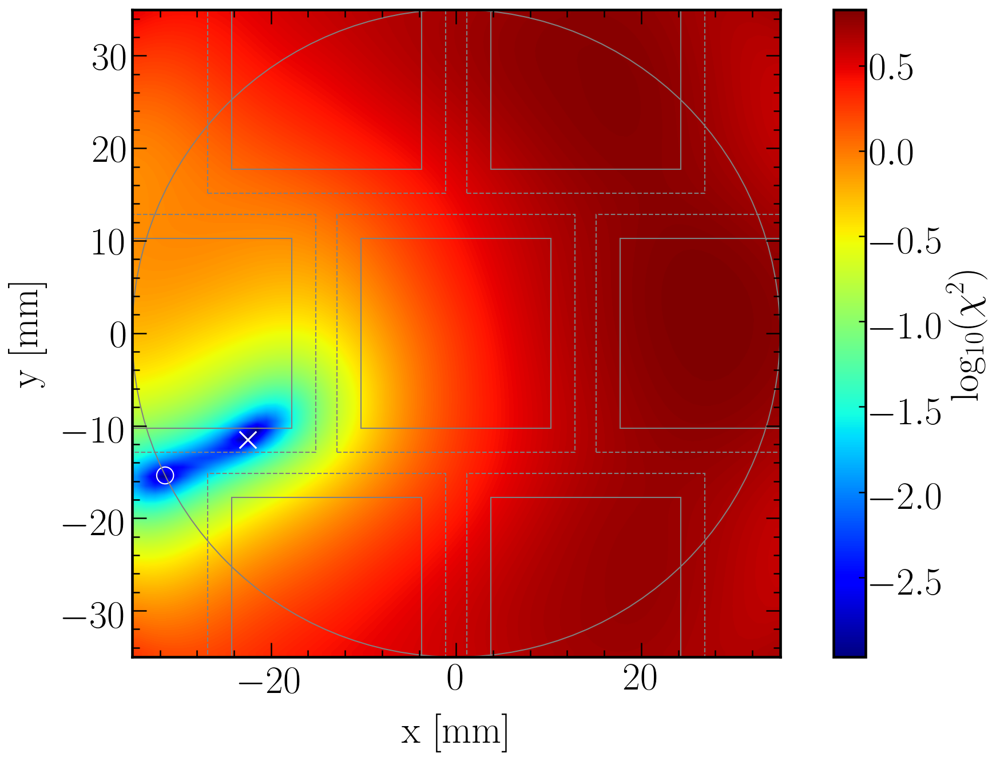

In [73]:
i = 1

#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
extent = [HF_x_y_hist2d_perPMT['xedges'].loc[i][0], HF_x_y_hist2d_perPMT['xedges'].loc[i][-1], HF_x_y_hist2d_perPMT['yedges'].loc[i][0], HF_x_y_hist2d_perPMT['yedges'].loc[i][-1]]
if minimizer == 'ChiSquared':
    im = plt.imshow(q_2dArray_log, origin='low', extent=extent, cmap = 'jet')
elif minimizer == 'LogLikelihoodRatio':
    im = plt.imshow(q_2dArray_log, origin='low', extent=extent, cmap = 'jet')
elif minimizer == 'WeightedChiSquared':
    im = plt.imshow(q_2dArray_log, origin='low', extent=extent, cmap = 'jet')
else:
    im = plt.imshow(q_2dArray, origin='low', extent=extent, cmap = 'jet')
im.set_interpolation('bilinear')    
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
#plt.title('Hits Fraction PMT '+str(i)+' / Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
if minimizer == 'ChiSquared':
    cbar.set_label(label = 'log$_{10}(\chi^{2})$', fontsize=label_size)
elif minimizer == 'LogLikelihoodRatio':
    cbar.set_label(label = 'log$_{10}(-2[\ln \mathcal{L} - \ln \mathcal{L}_0])$', fontsize=label_size)
elif minimizer == 'WeightedChiSquared':
    cbar.set_label(label = 'log$_{10}(\chi^{2}_{weighted})$', fontsize=label_size)
else:
    cbar.set_label(label = 'q', fontsize=label_size)
#plt.clim(0.0, 1.0)

plt.scatter(position_x_real, position_y_real, marker = "x", color = 'white', s = 200, label = 'Real position')  
plt.scatter(reconstructed(HFs_measured).x[0], reconstructed(HFs_measured).x[1], marker = "o", color = 'white', s = 200, facecolors='none', label = 'Reconstructed position') 
currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
currentAxis.add_artist(circle)

# Legend
'''leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)'''

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPosition_"+str(position_x_real)+'_'+str(position_y_real)+'_'+modelstring_save+".png", bbox_inches = "tight")

In [74]:
X_reconstructed = np.zeros_like(X)
Y_reconstructed = np.zeros_like(Y)

for j_y in range(0, q_2dArray.shape[1]):
    print(str(round(j_y/q_2dArray.shape[1]*100, 1))+'%', end=' ')
    for j_x in range(0, q_2dArray.shape[0]):
        if f_polar_R(X[j_y][j_x], Y[j_y][j_x]) < 35:
            X_reconstructed[j_y][j_x] = reconstructed(np.array([HF_x_y_hist2d_perPMT['histT'].loc[j][j_y][j_x] for j in range(1,8)])).x[0]
            Y_reconstructed[j_y][j_x] = reconstructed(np.array([HF_x_y_hist2d_perPMT['histT'].loc[j][j_y][j_x] for j in range(1,8)])).x[1]
        else:
            X_reconstructed[j_y][j_x] = None
            Y_reconstructed[j_y][j_x] = None
            
print('100.0%', end=' ')

#np.savetxt(filenameprefix+"_Xreconstructed_"+modelstring_save+".csv", X_reconstructed, delimiter=",")
#np.savetxt(filenameprefix+"_Yreconstructed_"+modelstring_save+".csv", Y_reconstructed, delimiter=",")
Reconstructed_Positions = pd.DataFrame({'X_position' : [X, X_reconstructed], 'Y_position' : [Y, Y_reconstructed]}, index=['true', 'reconstructed'])
Reconstructed_Positions.to_pickle(filenameprefix+"_Reconstructed_Positions_"+modelstring_save+".pkl")
print(filenameprefix+"_Reconstructed_Positions_"+modelstring_save+".pkl")

0.0% 1.4% 2.9% 4.3% 5.7% 7.1% 8.6% 10.0% 11.4% 12.9% 14.3% 15.7% 17.1% 18.6% 20.0% 21.4% 22.9% 24.3% 25.7% 27.1% 28.6% 30.0% 31.4% 32.9% 34.3% 35.7% 37.1% 

/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:61: RuntimeWarning: invalid value encountered in true_divide
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:84: RuntimeWarning: divide by zero encountered in true_divide
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:84: RuntimeWarning: invalid value encountered in true_divide


38.6% 40.0% 41.4% 42.9% 44.3% 45.7% 47.1% 48.6% 50.0% 51.4% 52.9% 54.3% 55.7% 57.1% 58.6% 60.0% 61.4% 62.9% 64.3% 65.7% 67.1% 68.6% 70.0% 71.4% 72.9% 74.3% 75.7% 77.1% 78.6% 80.0% 81.4% 82.9% 84.3% 85.7% 87.1% 88.6% 90.0% 91.4% 92.9% 94.3% 95.7% 97.1% 98.6% 100.0% optPhot_S2_1.0e+07_pmtGap4.5_RPTFE0.95_LXeAbs100_Tmesh0.89770509_writeEmptyFalse_Reconstructed_Positions_eta_v2_overSum_Chi2_normalization_to_sum_True_cut_LS_PMT_0.04.pkl


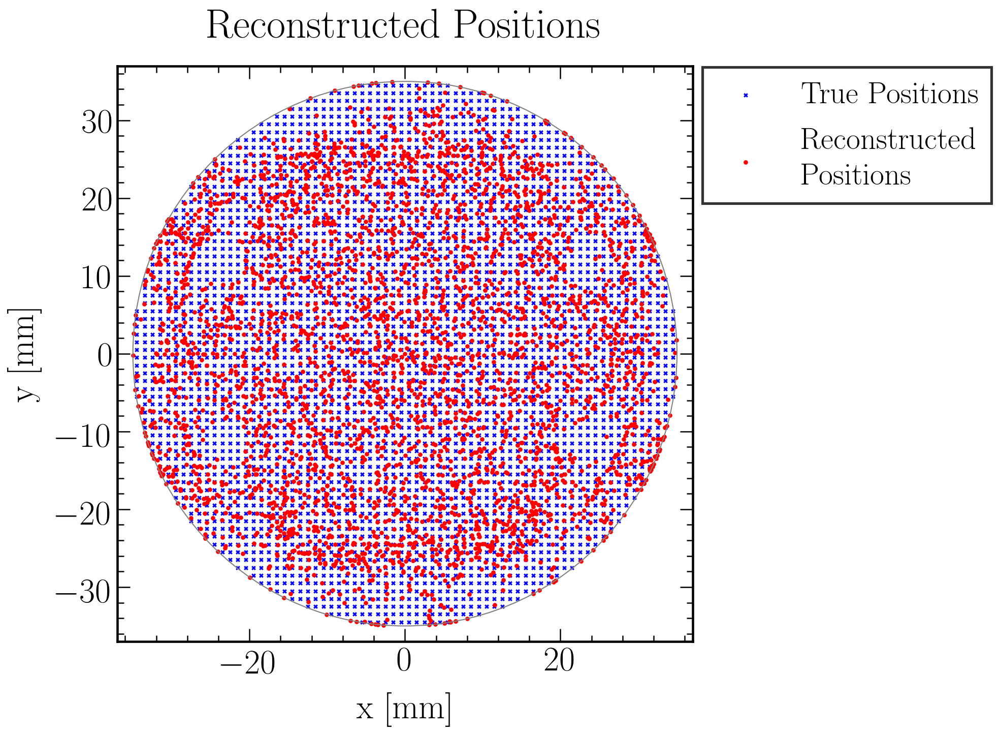

In [75]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
plt.scatter(X[f_polar_R(X, Y) < 35], Y[f_polar_R(X, Y) < 35], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35], color = 'red', s = 10, label = 'Reconstructed\nPositions')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPosition_"+modelstring_save+".png", bbox_inches = "tight")

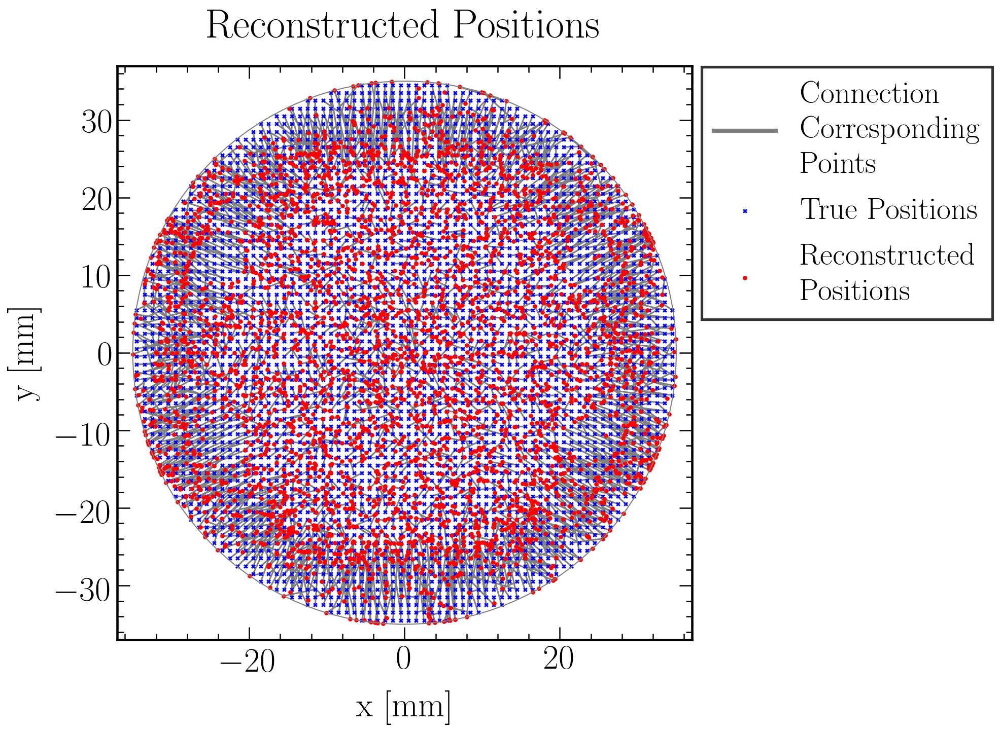

In [76]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Connect real and reconstructed position
plt.plot([X[f_polar_R(X, Y) < 35][0], X_reconstructed[f_polar_R(X, Y) < 35][0]],[Y[f_polar_R(X, Y) < 35][0], Y_reconstructed[f_polar_R(X, Y) < 35][0]], 'grey', label = 'Connection\nCorresponding\nPoints', zorder=0)
for i in range(1, len(X[f_polar_R(X, Y) < 35])):
    plt.plot([X[f_polar_R(X, Y) < 35][i], X_reconstructed[f_polar_R(X, Y) < 35][i]],[Y[f_polar_R(X, Y) < 35][i], Y_reconstructed[f_polar_R(X, Y) < 35][i]], 'grey', zorder=0)

# Data plot
plt.scatter(X[f_polar_R(X, Y) < 35], Y[f_polar_R(X, Y) < 35], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35], color = 'red', s = 10, label = 'Reconstructed\nPositions')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionConnected_"+modelstring_save+".png", bbox_inches = "tight")

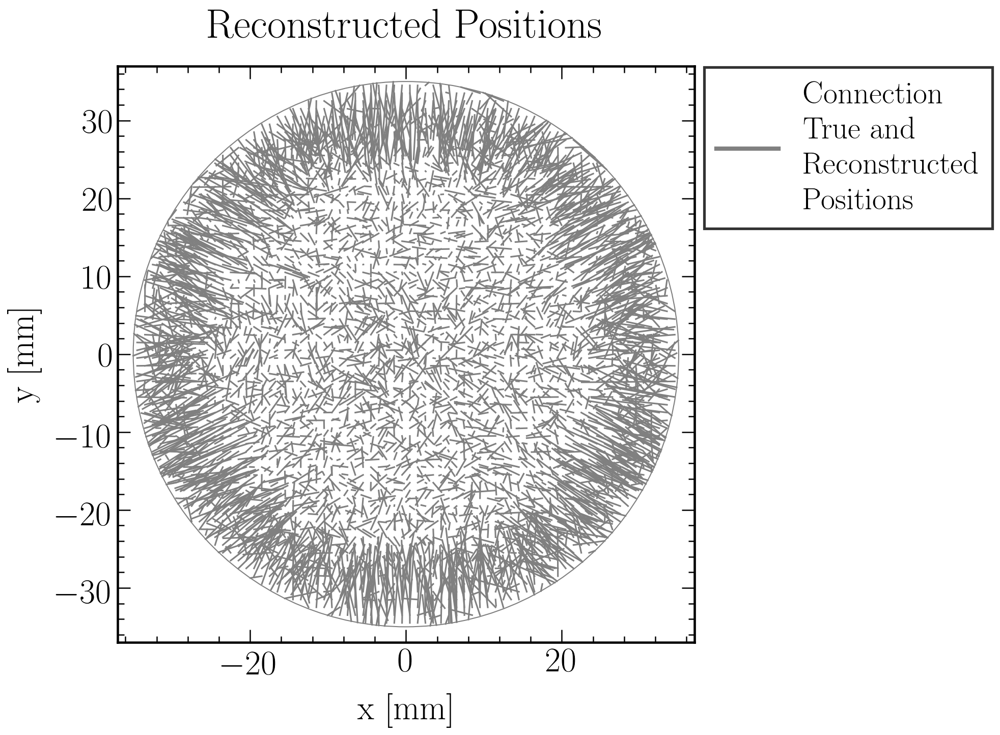

In [77]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot

# Connect real and reconstructed position
plt.plot([X[f_polar_R(X, Y) < 35][0], X_reconstructed[f_polar_R(X, Y) < 35][0]],[Y[f_polar_R(X, Y) < 35][0], Y_reconstructed[f_polar_R(X, Y) < 35][0]], 'grey', label = 'Connection\nTrue and\nReconstructed\nPositions')
for i in range(1, len(X[f_polar_R(X, Y) < 35])):
    plt.plot([X[f_polar_R(X, Y) < 35][i], X_reconstructed[f_polar_R(X, Y) < 35][i]],[Y[f_polar_R(X, Y) < 35][i], Y_reconstructed[f_polar_R(X, Y) < 35][i]], 'grey')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionConnections_"+modelstring_save+".png", bbox_inches = "tight")

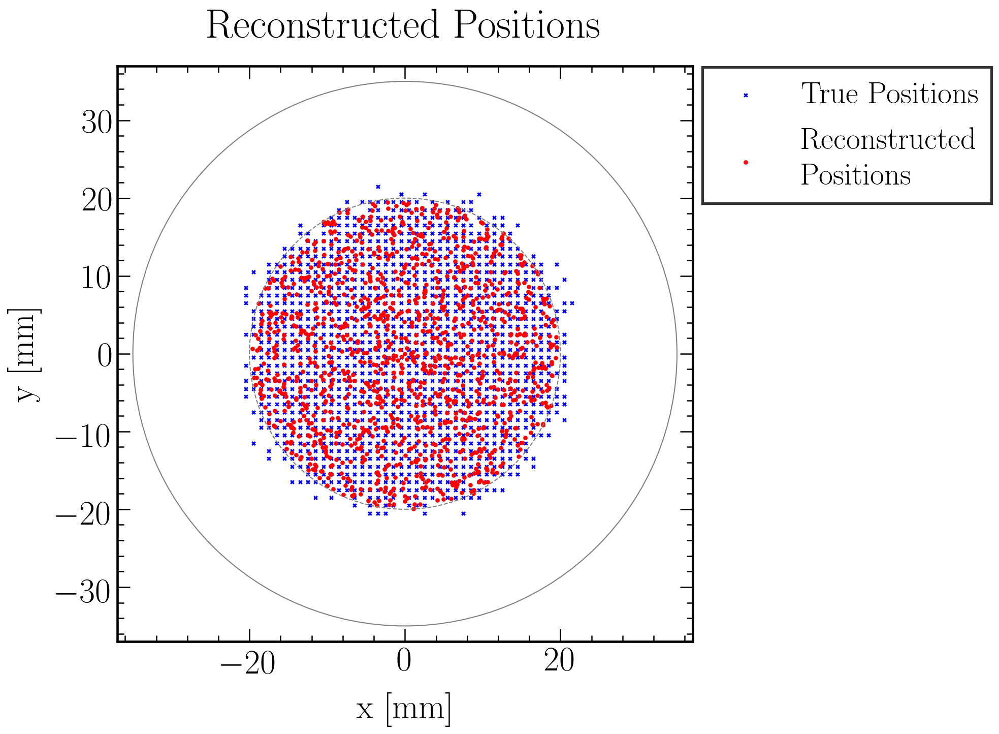

In [78]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
cnf = 20 #25
plt.scatter(X[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], Y[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(X_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], Y_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], color = 'red', s = 10, label = 'Reconstructed\nPositions')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)
circle2 = plt.Circle((0., 0.), cnf, color='gray', linestyle = '--', fill=False)
currentAxis.add_artist(circle2)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionConfined"+str(cnf)+"_"+modelstring_save+".png", bbox_inches = "tight")

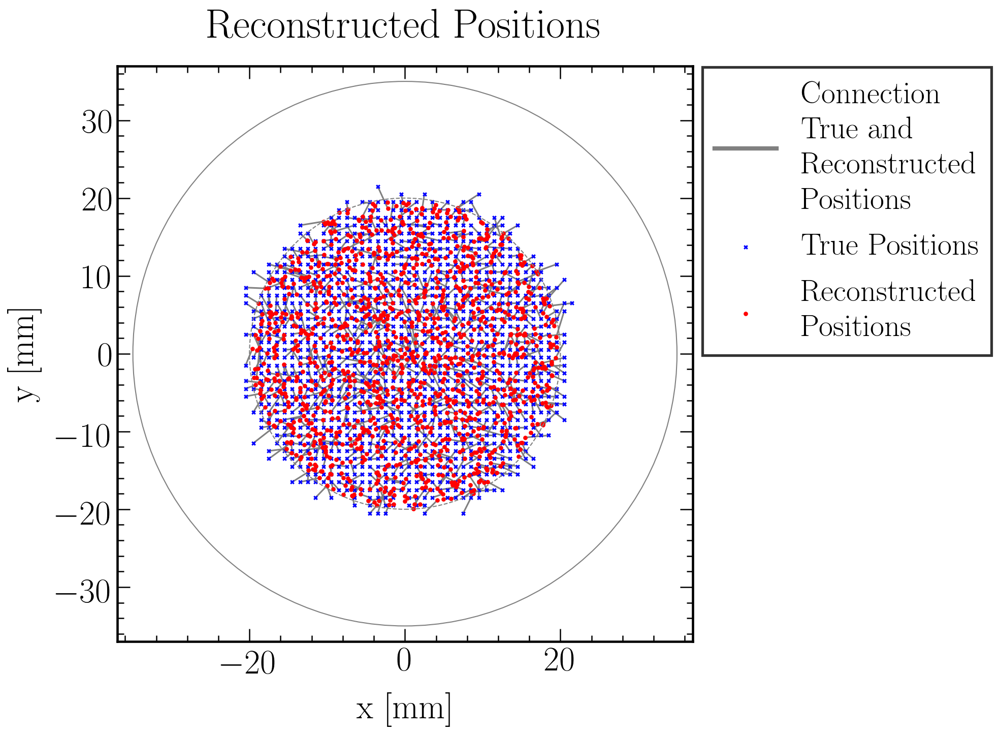

In [97]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Connect real and reconstructed position
plt.plot([X[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][0], X_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][0]],[Y[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][0], Y_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][0]], 'grey', label = 'Connection\nTrue and\nReconstructed\nPositions', zorder=0)
for i in range(1, len(X[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf])):
    plt.plot([X[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][i], X_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][i]],[Y[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][i], Y_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf][i]], 'grey', zorder=0)

# Data plot
cnf = 20 #20
plt.scatter(X[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], Y[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], color = 'blue', s = 10, marker = 'x', label = 'True Positions')
plt.scatter(X_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], Y_reconstructed[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], color = 'red', s = 10, label = 'Reconstructed\nPositions')

currentAxis = plt.gca()
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)
circle2 = plt.Circle((0., 0.), cnf, color='gray', linestyle = '--', fill=False)
currentAxis.add_artist(circle2)

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad)
plt.title('Reconstructed Positions', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(-37.,37.)
plt.ylim(-37.,37.)

# Legend
leg = plt.legend(loc=2, bbox_to_anchor=(0.99,1.025), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPositionConfinedConnected"+str(cnf)+"_"+modelstring_save+".png", bbox_inches = "tight")

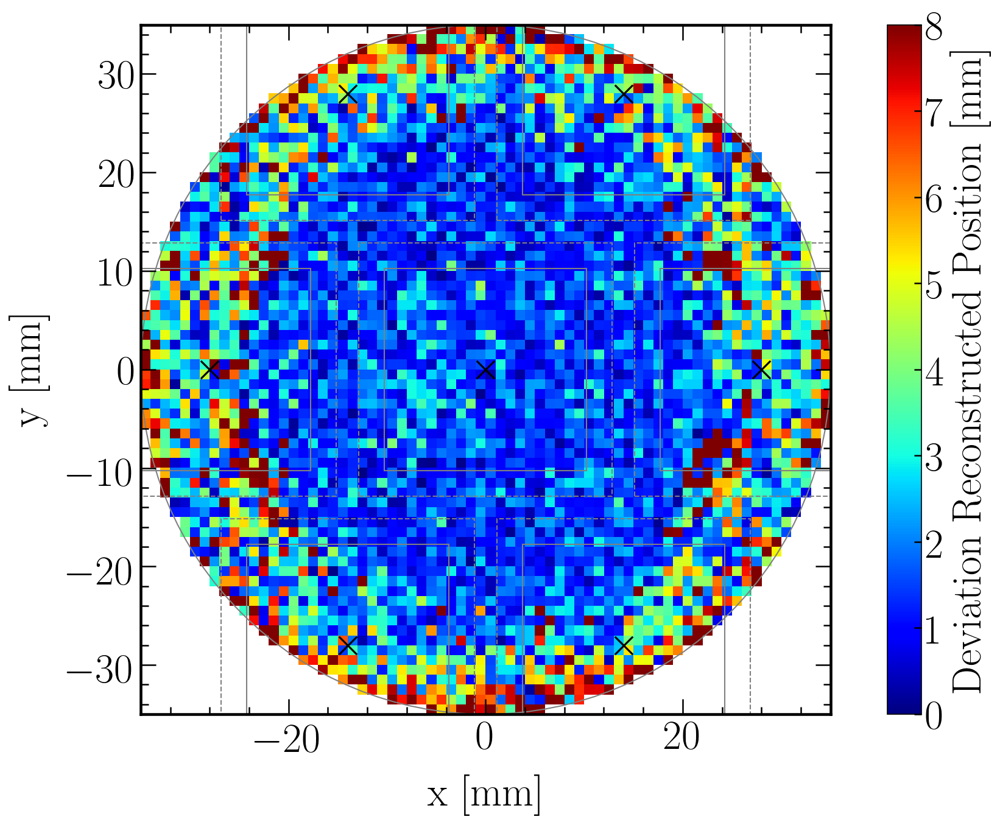

In [80]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################
i = 1
plt.imshow(f_polar_R(X_reconstructed - X, Y_reconstructed - Y), interpolation='nearest', origin='low', extent=[LCE_x_y_hist2d_perPMT['xedges'].loc[i][0], LCE_x_y_hist2d_perPMT['xedges'].loc[i][-1], LCE_x_y_hist2d_perPMT['yedges'].loc[i][0], LCE_x_y_hist2d_perPMT['yedges'].loc[i][-1]], cmap = 'jet')
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
#plt.title('Hits Fraction Map Top PMTs', fontsize = title_size, pad = title_pad)

plt.gca().set_aspect('equal', adjustable='box')

# Colorbar
cbar = plt.colorbar()
cbar.outline.set_linewidth(2.2)
cbar.ax.tick_params(direction='in', labelsize=label_size, width=1.2, length=6)
cbar.set_label(label='Deviation Reconstructed Position [mm]', fontsize=label_size)
plt.clim(0, 8)

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

plt.show()
fig.savefig(filenameprefix+"_ReconstructedPosition_Deviations_"+modelstring_save+".png", bbox_inches = "tight")

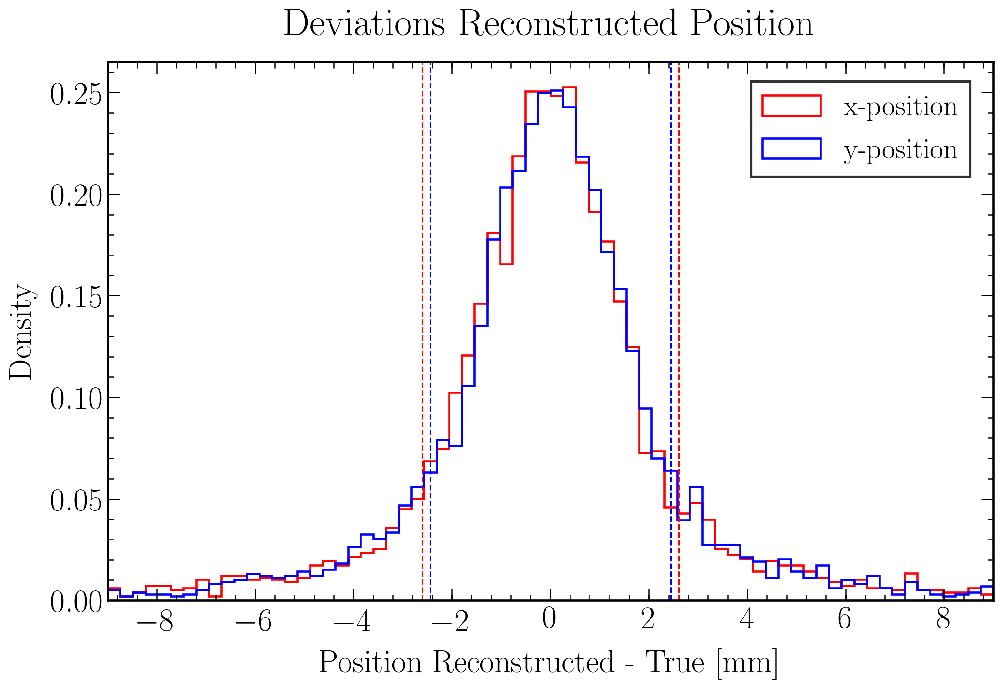

In [81]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
rng = (-9, 9)
plt.hist((X_reconstructed - X)[f_polar_R(X, Y) < 35], bins = numberbins, density=True, range=rng, histtype = 'step', linewidth = 2.2, label = 'x-position', color = 'red')
plt.hist((Y_reconstructed - Y)[f_polar_R(X, Y) < 35], bins = numberbins, density=True, range=rng, histtype = 'step', linewidth = 2.2, label = 'y-position', color = 'blue')

plt.xlabel('Position Reconstructed - True [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Density', fontsize = label_size, labelpad = label_pad)
plt.title('Deviations Reconstructed Position', fontsize = title_size, pad = title_pad)

plt.xlim(-9,9)

plt.axvline(x=np.sqrt(np.var((X_reconstructed - X)[f_polar_R(X, Y) < 35])), color='red', linestyle='dashed')
plt.axvline(x=-np.sqrt(np.var((X_reconstructed - X)[f_polar_R(X, Y) < 35])), color='red', linestyle='dashed')
plt.axvline(x=np.sqrt(np.var((Y_reconstructed - Y)[f_polar_R(X, Y) < 35])), color='blue', linestyle='dashed')
plt.axvline(x=-np.sqrt(np.var((Y_reconstructed - Y)[f_polar_R(X, Y) < 35])), color='blue', linestyle='dashed')

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_ReconstructedPosition_DeviationsHist_"+modelstring_save+".png", bbox_inches = "tight")
plt.show()

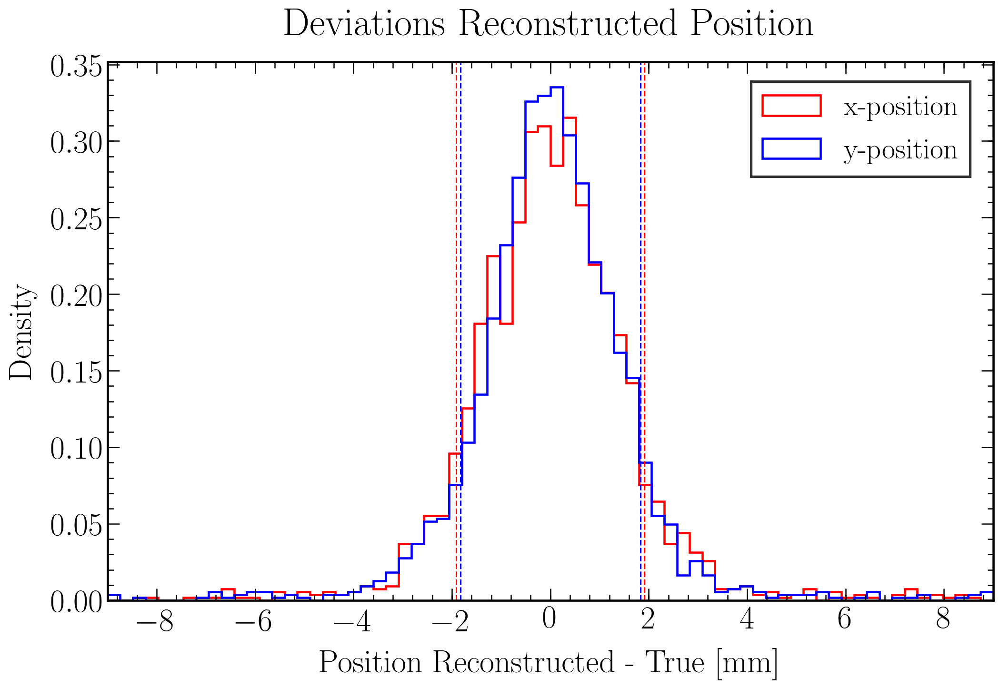

In [82]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)
    
# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

# Grid
#plt.grid(True)
    
#############################################
## Plot specific settings and plot data
#############################################

numberbins = 70

# Data plot
cnf = 25

rng = (-9, 9)
plt.hist(((X_reconstructed - X)[f_polar_R(X, Y) < 35])[f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], bins = numberbins, density=True, range=rng, histtype = 'step', linewidth = 2.2, label = 'x-position', color = 'red')
plt.hist(((Y_reconstructed - Y)[f_polar_R(X, Y) < 35])[f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf], bins = numberbins, density=True, range=rng, histtype = 'step', linewidth = 2.2, label = 'y-position', color = 'blue')

plt.xlabel('Position Reconstructed - True [mm]', fontsize = label_size, labelpad = label_pad)
plt.ylabel('Density', fontsize = label_size, labelpad = label_pad)
plt.title('Deviations Reconstructed Position', fontsize = title_size, pad = title_pad)

plt.xlim(-9,9)

plt.axvline(x=np.sqrt(np.var((X_reconstructed - X)[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf])), color='red', linestyle='dashed')
plt.axvline(x=-np.sqrt(np.var((X_reconstructed - X)[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf])), color='red', linestyle='dashed')
plt.axvline(x=np.sqrt(np.var((Y_reconstructed - Y)[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf])), color='blue', linestyle='dashed')
plt.axvline(x=-np.sqrt(np.var((Y_reconstructed - Y)[f_polar_R(X, Y) < 35][f_polar_R(X_reconstructed[f_polar_R(X, Y) < 35], Y_reconstructed[f_polar_R(X, Y) < 35]) < cnf])), color='blue', linestyle='dashed')

# Legend
leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
for line in leg.get_lines(): # enumerated
    line.set_linewidth(4)
leg.get_frame().set_linewidth(2.5)

fig.savefig(filenameprefix+"_ReconstructedPosition_DeviationsHistConfined"+str(cnf)+"_"+modelstring_save+".png", bbox_inches = "tight")
plt.show()

In [83]:
for cnf in [35, 40 , 45, 50]:
    print(model(cnf, *eval("fit_parameters_"+modelstring)[1-1]))
    
print('')
    
for cnf in [35, 40 , 45, 50]:
    print(model(cnf, *eval("fit_parameters_"+modelstring)[2-1]))

0.05976457166114729
0.04527002251538231
0.03693497820012668
0.032030958624054834

0.06694160471507038
0.0513269106040802
0.04255847105809764
0.03766702958350607


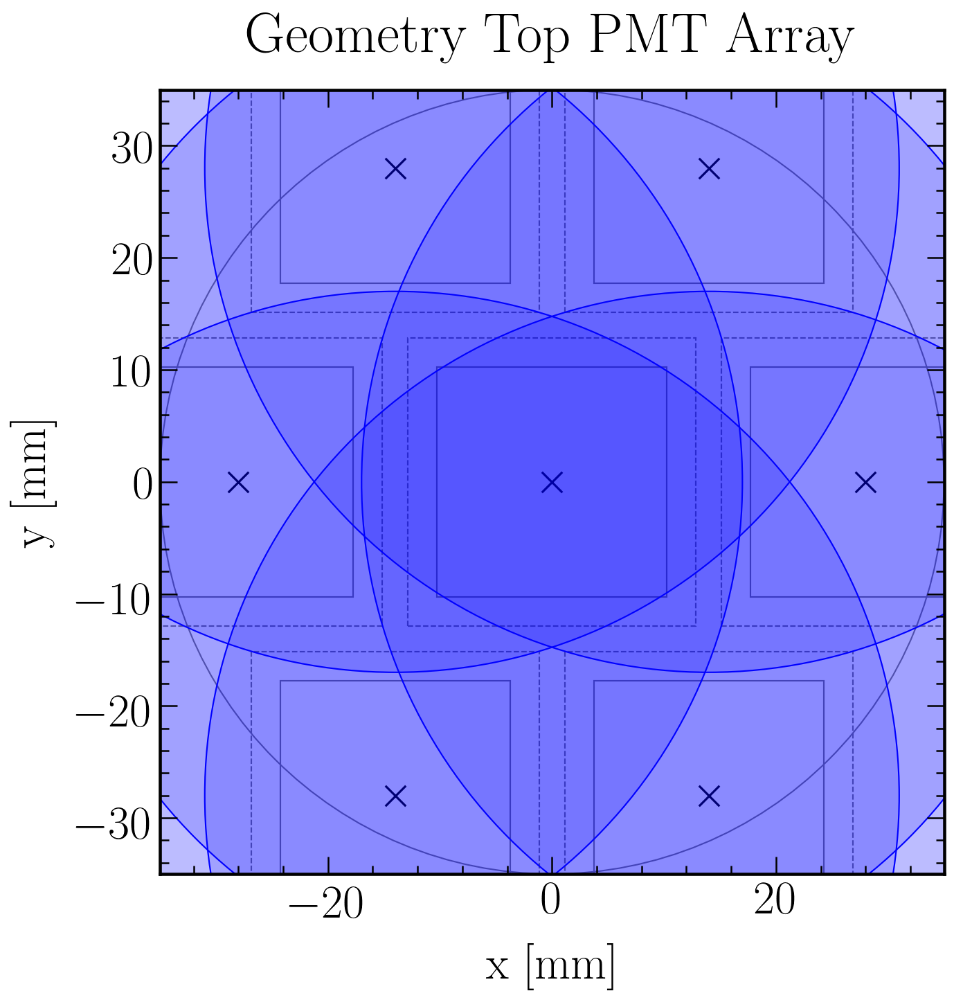

In [84]:
#############################################
## Set plot styles:
#############################################

fig=plt.figure(figsize=(16, 10), dpi=150)

# Text options
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Labels
label_size = 32.5 #25
label_pad = 13 #10
title_size = 39 #30
title_pad = 26 #20

# Axes Parameters
axes = plt.gca()
axes.tick_params(axis='both') 

# Axes ---> Linewidth
for axis in ['top','bottom','left','right']:
    axes.spines[axis].set_linewidth(2.2)

# Axes ---> Ticks
axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
axes.yaxis.set_minor_locator(AutoMinorLocator(5))
plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

#############################################
## Plot specific settings and plot data
#############################################

# Data plot
#####################

plt.xlabel('x [mm]', fontsize = label_size, labelpad = label_pad) # -35*mm,35*mm = 70
plt.ylabel('y [mm]', fontsize = label_size, labelpad = label_pad) # 68.5*mm - 2*0.15*mm
plt.title('Geometry Top PMT Array', fontsize = title_size, pad = title_pad)

plt.xlim(-35,35)
plt.ylim(-35,35)
plt.gca().set_aspect('equal', adjustable='box')

plt.scatter(PMT_positions['PMT_position_x'], PMT_positions['PMT_position_y'], marker = "x", color = 'black', s = 200)
currentAxis = plt.gca()
for i in range(1,8):
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_photocathode_width/2, PMT_positions['PMT_position_y'][i] - R8520_photocathode_width/2), R8520_photocathode_width, R8520_photocathode_width, alpha=1, color = 'gray', fill = False))
    currentAxis.add_patch(Rectangle((PMT_positions['PMT_position_x'][i] - R8520_body_width/2, PMT_positions['PMT_position_y'][i] - R8520_body_width/2), R8520_body_width, R8520_body_width, alpha=1, color = 'gray', fill = False, linestyle = "--"))
circle = plt.Circle((0., 0.), 35., color='gray', linestyle = '-', fill=False)
currentAxis.add_artist(circle)

'''
cnf0 = 20

pos_x = 0
pos_y = 0
color = 'k'
circle = plt.Circle((pos_x, pos_y), cnf0, color=color, linestyle = '--', fill=False)
plt.scatter(pos_x, pos_y, marker = "x", color = color, s = 100)
currentAxis.add_artist(circle)
'''

cnf = 45 # min 35
c = 'blue'

#color=iter(cm.rainbow(np.linspace(0,1,7)))
for i in range(1,8):
    #c=next(color)
    circle = plt.Circle((PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i]), cnf, linestyle = '-', alpha = 1/7, color = c)
    currentAxis.add_artist(circle)
    
#color=iter(cm.rainbow(np.linspace(0,1,7)))
for i in range(1,8):
    #c=next(color)
    circle = plt.Circle((PMT_positions['PMT_position_x'][i], PMT_positions['PMT_position_y'][i]), cnf, linestyle = '-', fill = False, color = c)
    currentAxis.add_artist(circle)

plt.show()

### Iterative reconstruciton

In [754]:
#### General settings

## Maximum number of iterations
iterations = 5

## Fiducial radial cut in mm
rfiducial = 20

## Fiducial radial cut 0th iteration in mm
rfiducial0 = 34 # np.inf or 35 or 34

In [755]:
#### Prepare empty pandas data frame for outputs from iterative fitting

## Indices
## real = exact / real positions
## direct = directly reconstructed above
## 0 = fitted as below starting from exact positions
## >= 1 = fitted with positions reconstructed in iteration before
ind = [str(i) for i in range(0,iterations +1)]

## Data frame
d = {'rfiducial': [None]*len(ind), 'HF': [None]*len(ind), 'HF_binned': [None]*len(ind), 'x_pos': [None]*len(ind), 'y_pos': [None]*len(ind), 'R_pos': [None]*len(ind), 'r_pos': [[None]*7]*len(ind), 'r_pos_binned': [[None]*7]*len(ind), 'fit_parameter': [[None]*7]*len(ind)}
Iterative_Reconstruciton = pd.DataFrame(data=d, index = ind)

## Fill generalities and 'real' row
Iterative_Reconstruciton['rfiducial'] = [rfiducial0]+[rfiducial]*iterations
#Iterative_Reconstruciton['HF'] = [flatten_tuples(HF_x_y_hist2d_perPMT['histT'].loc[i])]*len(ind)
Iterative_Reconstruciton['HF'] = [np.array([flatten_tuples(HF_x_y_hist2d_perPMT['histT'].loc[i]) for i in range(1,8)])]*len(ind)

iteration = '0'
Iterative_Reconstruciton.at[iteration, 'x_pos'] = flatten_tuples(Reconstructed_Positions['X_position'].loc['true'])
Iterative_Reconstruciton.at[iteration, 'y_pos'] = flatten_tuples(Reconstructed_Positions['Y_position'].loc['true'])
Iterative_Reconstruciton.at[iteration, 'R_pos'] = f_polar_R(Iterative_Reconstruciton.at[iteration, 'x_pos'], Iterative_Reconstruciton.at[iteration, 'y_pos'])
Iterative_Reconstruciton.at[iteration, 'r_pos'] = np.array([f_polar_R(Iterative_Reconstruciton.at[iteration, 'x_pos'] - PMT_positions['PMT_position_x'][i], Iterative_Reconstruciton.at[iteration, 'y_pos'] - PMT_positions['PMT_position_y'][i]) for i in range(1,8)])

/home/ab602/anaconda3/lib/python3.7/site-packages/scipy/stats/_binned_statistic.py:607: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  result = result[core]
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in power
  if __name__ == '__main__':
/home/ab602/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: divide by zero encountered in power
  if __name__ == '__main__':


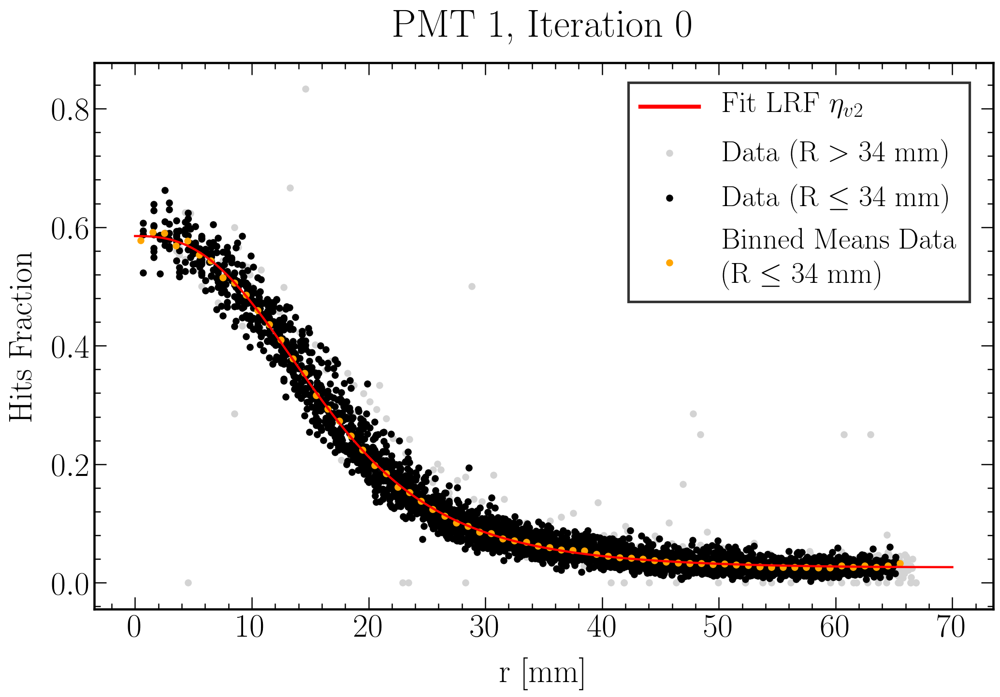

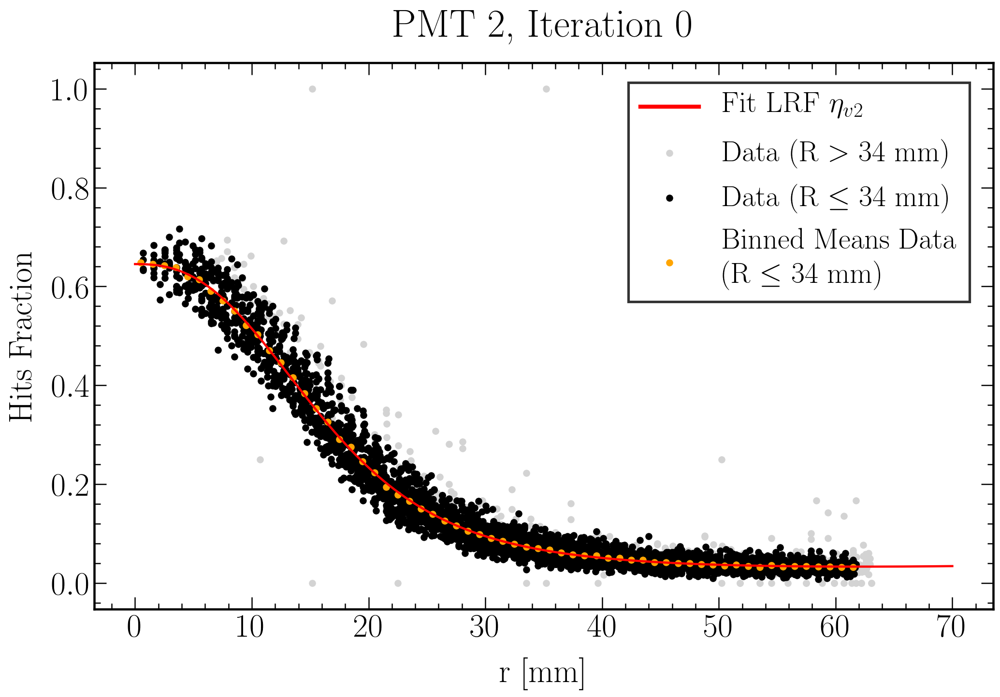

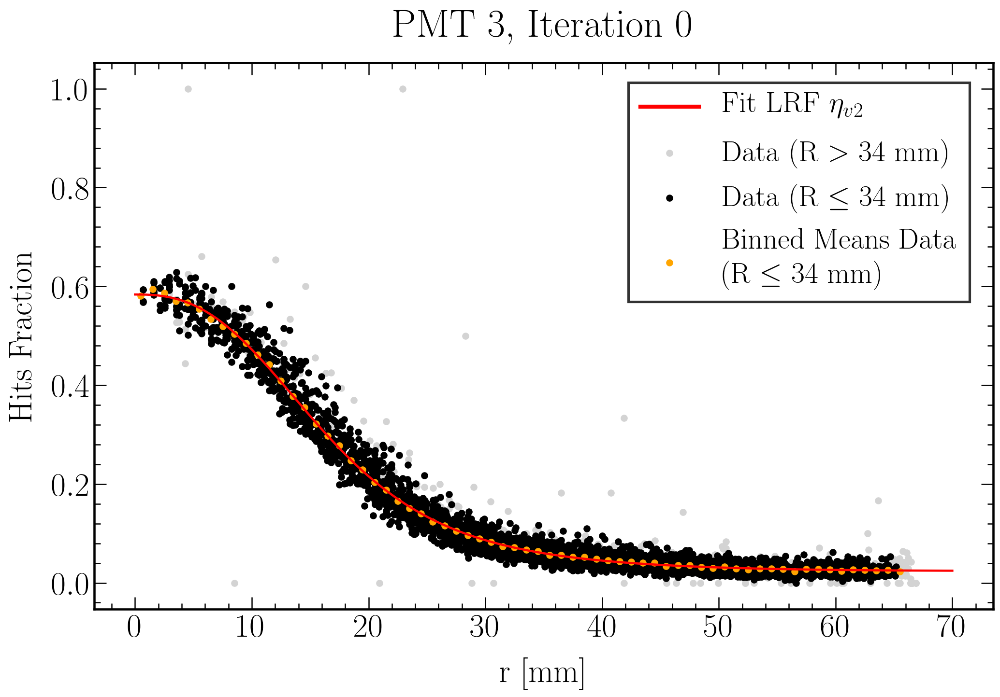

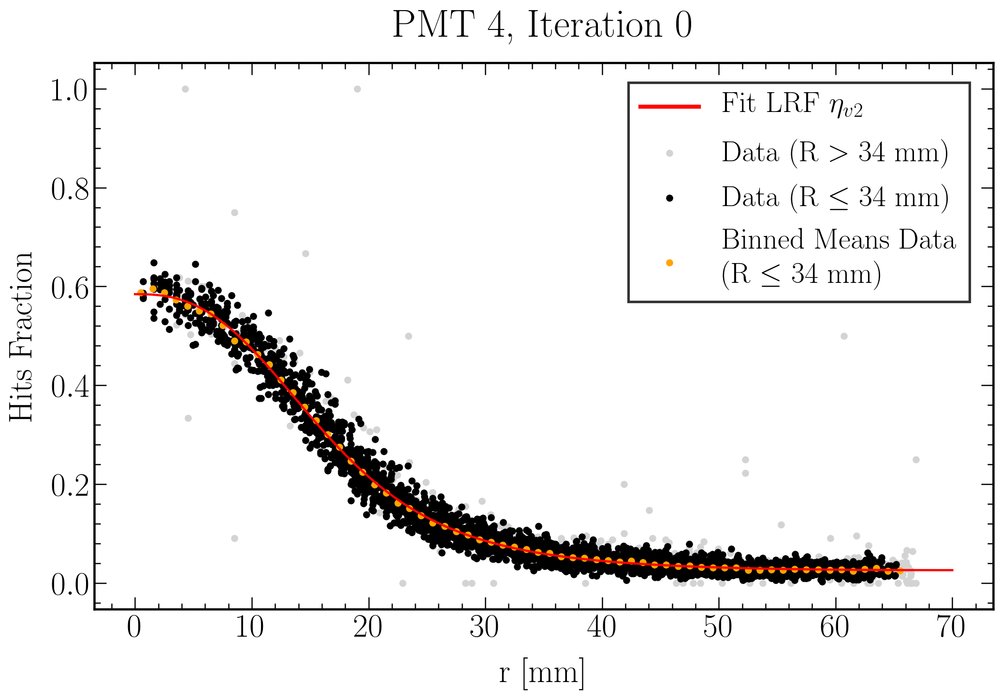

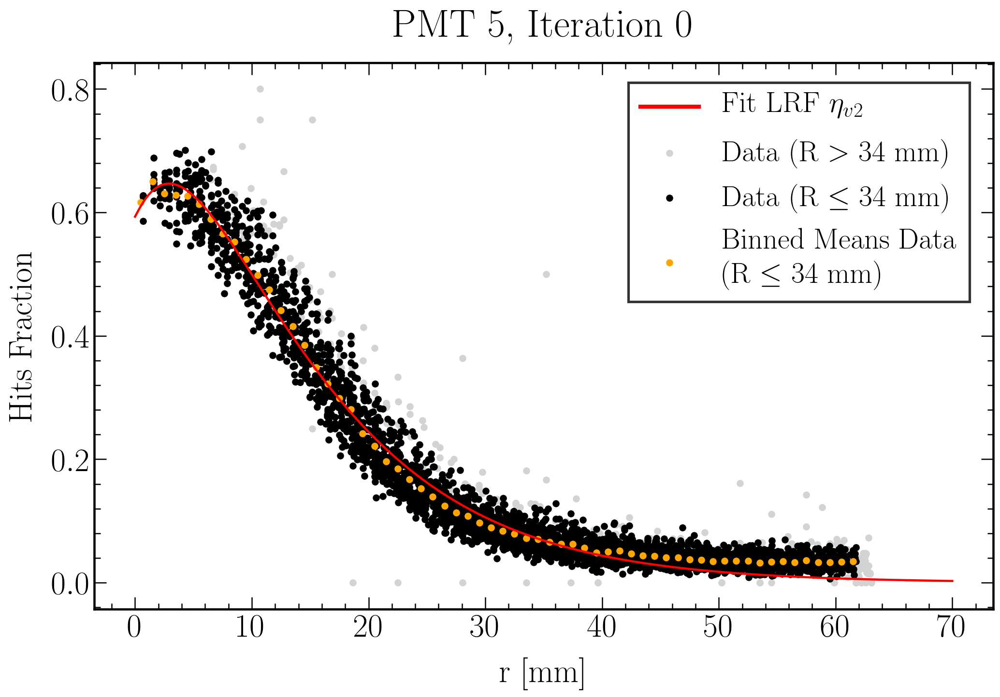

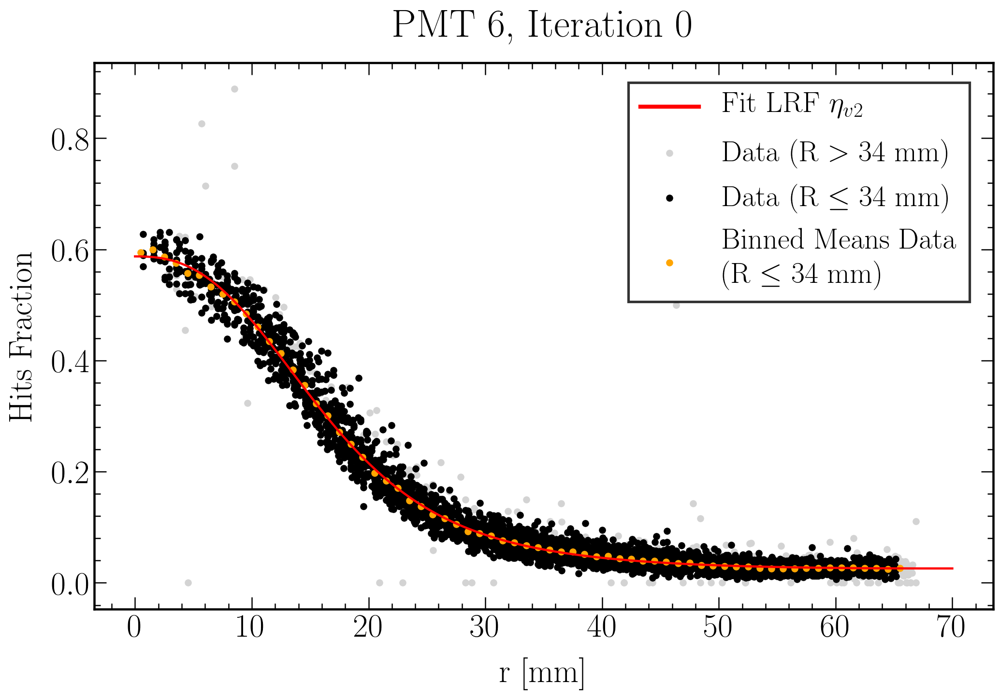

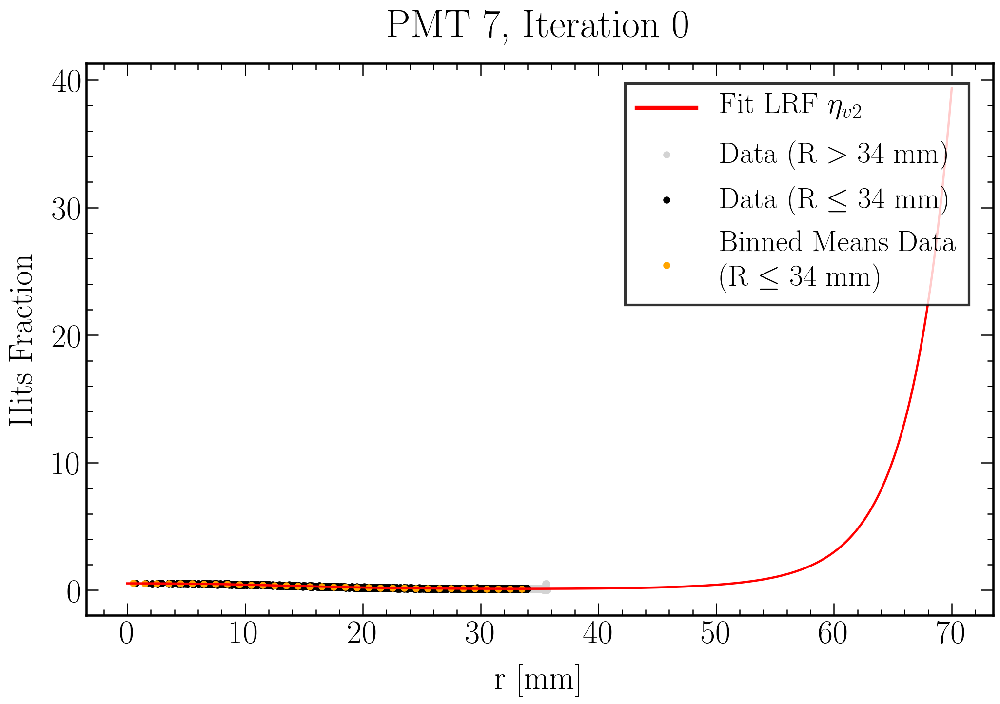

In [756]:
iteration = '0'

fit_parameters = np.array([None]*7)
r_pos_binned = np.array([None]*7)
HF_binned = np.array([None]*7)

for i in range(1,8):

    rfiducial = Iterative_Reconstruciton.at[iteration, 'rfiducial']
    HF = Iterative_Reconstruciton.at[iteration, 'HF'][i-1]
    HF_isnan = HF[~np.isnan(HF)]
    R = Iterative_Reconstruciton.at[iteration, 'R_pos']
    R_isnan  =  R[~np.isnan(HF)]
    r = Iterative_Reconstruciton.at[iteration, 'r_pos'][i-1]
    r_isnan  =  r[~np.isnan(HF)]

    ## Fiducialise
    r_isnan_fiducial = r_isnan[R_isnan <= rfiducial]
    HF_isnan_fiducial = HF_isnan[R_isnan <= rfiducial]

    ## Bin to account for different arc lengths
    statistic, bin_edges, binnumber = stats.binned_statistic(r_isnan_fiducial, HF_isnan_fiducial, statistic='mean', bins=(70), range=(0,70))
    bin_center = (bin_edges[:-1]+bin_edges[1:])/2
    statistic_isnan = statistic[~np.isnan(statistic)]
    bin_center_isnan = bin_center[~np.isnan(statistic)]

    r_pos_binned[i-1] = bin_center_isnan
    HF_binned[i-1] = statistic_isnan

    ## Fit
    popt, pcov = curve_fit(model, bin_center_isnan, statistic_isnan)
    fit_parameters[i-1] = popt

    ##################################################################################################
    #### Plot

    fig=plt.figure(figsize=(16, 10), dpi=150)

    ## Text options
    plt.rc('text', usetex=True)
    plt.rc('font', family='serif')

    ## Labels
    label_size = 32.5 #25
    label_pad = 13 #10
    title_size = 39 #30
    title_pad = 26 #20

    ## Axes Parameters
    axes = plt.gca()
    axes.tick_params(axis='both') 

    ## Axes ---> Linewidth
    for axis in ['top','bottom','left','right']:
        axes.spines[axis].set_linewidth(2.2)

    ## Axes ---> Ticks
    axes.xaxis.set_minor_locator(AutoMinorLocator(5)) 
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    axes.yaxis.set_minor_locator(AutoMinorLocator(5))
    plt.tick_params(which='minor', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=6)
    plt.tick_params(which='major', direction='in', labelsize=label_size, top=True, right=True, width=1.2, length=12)

    ## Grid
    #plt.grid(True)

    plt.scatter(r_isnan[R_isnan > rfiducial], HF_isnan[R_isnan > rfiducial], color = 'lightgray', label = "Data (R $>$ "+str(rfiducial)+" mm)")
    plt.scatter(r_isnan_fiducial, HF_isnan_fiducial, color = 'black', label = "Data (R $\leq$ "+str(rfiducial)+" mm)")
    plt.scatter(bin_center_isnan, statistic_isnan, color = 'orange', label = "Binned Means Data\n(R $\leq$ "+str(rfiducial)+" mm)")

    if int(modelstring[-1]) == 1:
        label = 'Fit LRF $\eta_{v1}$'
    elif int(modelstring[-1]) == 2:
        label = 'Fit LRF $\eta_{v2}$'
    elif int(modelstring[-1]) == 3:
        label = 'Fit LRF $\eta_{v3}$'
    elif int(modelstring[-1]) == 4:
        label = 'Fit LRF $\eta_{v4}$'
    else:
        label = 'Fit LRF'
    plt.plot(np.linspace(0, 70, 300), model(np.linspace(0, 70, 300), *eval("fit_parameters")[i-1]), color = 'r', linewidth = 2.2, label = label)
    
    # Axes Label 
    plt.xlabel('r [mm]', fontsize = label_size, labelpad = label_pad)
    plt.ylabel('Hits Fraction', fontsize = label_size, labelpad = label_pad)
    plt.title('PMT '+str(i)+', Iteration '+str(iteration), fontsize = title_size, pad = title_pad)
    
    # Legend
    leg = plt.legend(loc=1, bbox_to_anchor=(0.99,0.99), fontsize=0.9*label_size, frameon=True, shadow=False, edgecolor='black', fancybox=False)
    for line in leg.get_lines(): # enumerated
        line.set_linewidth(4)
    leg.get_frame().set_linewidth(2.5)

    fig.savefig(filenameprefix+"_Iterative_Reconstruciton_iteration_"+str(iteration)+"_"+modelstring_save+"_PMT_"+str(i)+".png")
    plt.show()
    #################################################################################################

    ## Write to dataframe
    Iterative_Reconstruciton.at[iteration, 'r_pos_binned'] = r_pos_binned
    Iterative_Reconstruciton.at[iteration, 'HF_binned'] = HF_binned
    
Iterative_Reconstruciton.at[iteration, 'fit_parameter'] = fit_parameters

In [757]:
# PMT 5: constrain fit values
# PMT 7: plot range

In [758]:
fit_parameters

array([array([ 0.58507946, 30.07035303, -0.39835762,  4.26775814,  2.58470997]),
       array([ 0.64516845, 31.61518898, -0.79507363,  4.87967407,  2.48361744]),
       array([ 0.58352157, 30.61394597, -0.37121593,  4.29056364,  2.56788497]),
       array([ 0.58431018, 30.54244845, -0.44923832,  4.38394264,  2.58574698]),
       array([ 0.59314696,  7.91442226,  1.43334025, -1.3164058 ,  1.03139688]),
       array([ 0.58735787, 31.33853193, -0.53548681,  4.57978129,  2.51657155]),
       array([  0.53182694,  39.90066291, -16.59386255,  19.36071227,
         2.21208189])], dtype=object)

In [759]:
Iterative_Reconstruciton.to_pickle(filenameprefix+"_Iterative_Reconstruciton.pkl")
Iterative_Reconstruciton

,rfiducial,HF,HF_binned,x_pos,y_pos,R_pos,r_pos,r_pos_binned,fit_parameter
0,34,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...","[[0.5780904934088532, 0.5915346595101686, 0.59...","[-34.5, -33.5, -32.5, -31.5, -30.5, -29.5, -28...","[-34.5, -34.5, -34.5, -34.5, -34.5, -34.5, -34...","[48.79036790187178, 48.088460154178364, 47.397...","[[21.50581316760657, 20.554804791094465, 19.60...","[[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5,...","[[0.5850794625920068, 30.070353029364238, -0.3..."
1,20,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
2,20,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
3,20,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
4,20,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
5,20,"[[nan, nan, nan, nan, nan, nan, nan, nan, nan,...",None,None,None,None,"[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]","[None, None, None, None, None, None, None]"
